In [1]:
import os
import sys
sys.path.append('/mnt/mnt/5TB_slot2/Tobias')
sys.path.append('/mnt/mnt/5TB_slot2/Tobias/TobiasPy/fastMRI')
sys.path.append('/mnt/mnt/4TB_pcie/fastBrain/')
import h5py
import numpy as np
import numpy.fft as nf
import pytorch_ssim
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
from models.unet.unet_model import UnetModel as UnetModel
from FF_net import FF_net
from FF_net import FF_simple_net
from FF_net import FF_net_tanh
from FF_net import Complex_net
import argparse
from common.args import Args
import models.unet.run_unet  as Run
import torch.nn as nn
import logging
import pathlib
import random
from torch.utils.data import Dataset
import time
from torch.nn import functional as F
import shutil
from tensorboardX import SummaryWriter
import torchvision
from torchvision import transforms, utils
import net_utils as nu
import calendar
import datetime
from longOne import ComplexFourier,ComplexEndToEnd
from complex_unet_model import ComplexUnetModel
from complex_end_to_end import ComplexEndToEnd

import sigpy as sp
import sigpy.plot as pl
from skimage.metrics import structural_similarity as np_ssim
import vd_spiral

from FF_net import Complex_net_ext

%load_ext autoreload
%reload_ext autoreload
%autoreload 2

In [2]:
sys.argv=['']
def create_arg_parser():
    timestamp = calendar.timegm(time.gmtime())
    human_readable = datetime.datetime.fromtimestamp(timestamp).isoformat()
    #human_readable="pure_inverse_fourier"
    human_readable="ComplexEndToEnd_Kspace_multiChannel"
    parser = argparse.ArgumentParser(description="ML parameters")
    parser.add_argument('--num-pools', type=int, default=4, help='Number of U-Net pooling layers')
    parser.add_argument('--drop-prob', type=float, default=0.0, help='Dropout probability')
    parser.add_argument('--num-chans', type=int, default=32, help='Number of U-Net channels')

    parser.add_argument('--batch-size', default=16, type=int, help='Mini batch size')
    parser.add_argument('--num-epochs', type=int, default=250, help='Number of training epochs')
    parser.add_argument('--lr', type=float, default=0.0001, help='Learning rate')
    parser.add_argument('--lr-step-size', type=int, default=100,
                        help='Period of learning rate decay')
    parser.add_argument('--lr-gamma', type=float, default=0.1,
                        help='Multiplicative factor of learning rate decay')
    parser.add_argument('--weight-decay', type=float, default=0.01,
                        help='Strength of weight decay regularization')
    parser.add_argument('--momentum', type=float, default=0.1,
                        help='Strength of optimizer momentum')

    parser.add_argument('--report-interval', type=int, default=10000, help='Period of loss reporting')
    parser.add_argument('--data-parallel', default=True,
                        help='If set, use multiple GPUs using data parallelism')
    parser.add_argument('--device', type=str, default='cuda',
                        help='Which device to train on. Set to "cuda" to use the GPU')
    parser.add_argument('--exp-dir', type=pathlib.Path, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable),
                        help='Path where model and results should be saved')
    parser.add_argument('--resume', action='store_true', default=False,
                        help='If set, resume the training from a previous model checkpoint. '
                             '"--checkpoint" should be set with this')
    parser.add_argument('--checkpoint', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt',
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--logdir', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable),
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--seed', default=42, type=int, help='Seed for random number generators')
    parser.add_argument('--resolution', default=128, type=int, help='Resolution of images')
    parser.add_argument('--device_ids', default=[0,1] , help='GPUS used')
    return parser
args=create_arg_parser().parse_args()
print("save to",args.checkpoint)

save to /mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_Kspace_multiChannel/best_model.pt


In [3]:
def test_fourier():
    sig = np.random.randn(args.resolution) + 1j*np.random.randn(320)
    F = np.fft.ifft(sig, axis=-1)
    # First half of inputs/outputs is real part, second half is imaginary part
    X = torch.from_numpy(np.hstack([sig.real, sig.imag])).double()
    Y = torch.from_numpy((F.real**2+F.imag**2)**(1/2)).double()
    return X,Y

class SliceData(Dataset):
    """
    A PyTorch Dataset that provides access to MR image slices.
    """
    
    def __init__(self, root="/mnt/mnt/5TB_slot2/fastMRI/multicoil_train", sample_rate=1.):
        self.examples = []
        #potential to apply pre-process transform
        files = list(pathlib.Path(root).iterdir())
        if sample_rate < 1:
            #random.shuffle(files)
            num_files = round(len(files) * sample_rate)
            files = files[:num_files]
        for fname in sorted(files):
            print(fname)
            try:
                #print(h5py.File(fname, 'r').keys())
                #maybe also only randomly select parts of slices. Otherwise lot of outer noise-like structures.
                xml = h5py.File(fname, 'r')['ismrmrd_header']
                kspace = h5py.File(fname, 'r')['kspace']
                num_slices = kspace.shape[0]
                num_channels=kspace.shape[1]
                if (kspace.shape[-2]<args.resolution) or (kspace.shape[-1]<args.resolution) or num_channels!=16:
                    continue
                print(len(self.examples))
                for slice in range(num_slices):
                    crop_size = (min(args.resolution, kspace.shape[-2]),min(args.resolution, kspace.shape[-1]))
                    k=nu.center_crop(kspace[slice], crop_size)
                    target=abs(nu.rsos(nu.make_ift(k),0))
                    m=np.max(target)
                    if m>0:
                        target/=m
                    else:
                        continue
                    k=nu.to_tensor(k)
                    print(k.shape)
                    us=nu.apply_mask(k,r=3)[0]#get only the data part of the data,mask double
                    print(us.shape)
                    us/=m
                    if np.isnan(np.sum(target)):
                        continue
                    X=us#.flatten()
                    print(X.shape)
                    #print(X.shape)
                    Y=nu.to_tensor(target)
                    #print(Y.shape)
                    #X,Y=test_fourier()
                    self.examples += [(fname, slice, X, Y)]
            except:
                print("Couldn't open file")
    
    def __len__(self):
        return len(self.examples)
    
    def __getitem__(self, i):
        fname, slice, f, t = self.examples[i]
#         with h5py.File(fname, 'r') as data:
#             full=to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, full.shape[-3]),min(args.resolution, full.shape[-2]))          
#             full=complex_center_crop(full,crop_size)
            
#             kspace = to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, kspace.shape[-3]), min(args.resolution, kspace.shape[-2]))
#             kspace=apply_mask(kspace)[0]
#             kspace = complex_center_crop(kspace, crop_size)
            
        return (f, t)

In [4]:
def create_data_loaders():
    #batch_size=32
    #mask_func = None
    #if args.mask_kspace:
    #    mask_func = MaskFunc(args.center_fractions, args.accelerations)
    train_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_train",sample_rate=0.25)
    dev_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.25)
    test_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.05)
    train_loader = DataLoader(
        dataset=train_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    dev_loader = DataLoader(
        dataset=dev_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    test_loader=None
#     test_loader = DataLoader(
#         dataset=test_data,
#         num_workers=0,
#         pin_memory=True,
#     )
    return train_loader, dev_loader, test_loader

In [5]:
t=time.time()
train_loader, dev_loader, test_loader= create_data_loaders()
print("Time taken to load data: ",time.time()-t)

/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002442.h5
0
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128,

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002939.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002944.h5
176
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])


torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003016.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003027.h5
256
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])


torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000319.h5
412
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000466.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000467.h5
588
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000543.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000545.h5
668
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6002197.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6002214.h5
844
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXFLAIR_202_6000444.h5
16
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_202_6000293.h5
108
torch.Size([16, 128, 128, 2])
torch.Size([

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1_206_2060052.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1_206_2120004.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_2000110.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_2000129.h5
264
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_201_2010233.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_201_2010383.h5
440
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_202_2020425.h5
520
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070051.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070177.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070209.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070240.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070264.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070312.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070385.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070451.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070513.h5
/mnt/mnt/4

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_210_6001525.h5
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_210_6001590.h5
664
torch.Size([16, 128, 128, 

torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size([16, 128, 128, 2])
torch.Size

with torch.no_grad():
        for (f, t) in train_loader:
            print(f.shape,t.shape)
            plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            plt.show()
            plt.imshow(t[0,:,:])
            plt.show()

In [6]:
def build_model(args,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=0.05):
    #check every time which gpus are available!
    #device_ids=[2,3,1]
    device_ids=args.device_ids
    model=ComplexEndToEnd(in_chans=16,out_chans=1,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=args.drop_prob,resolution=args.resolution).to(args.device)
    model=model.double()
    set_weights(model)
    if args.data_parallel and args.device=="cuda":
        model = nn.DataParallel(model,device_ids=device_ids)
    print("Model build successfully")
    #vis_weights(model)
    return model

def set_weights(model):
    model.f_layer1.conv_r.weight=torch.nn.Parameter(torch.tensor(np.load("module.c_layer1.conv_r.weight.npy")).to(args.device))
    model.f_layer1.conv_i.weight=torch.nn.Parameter(torch.tensor(np.load("module.c_layer1.conv_i.weight.npy")).to(args.device))
    model.f_layer2.conv_r.weight=torch.nn.Parameter(torch.tensor(np.load("module.c_layer2.conv_r.weight.npy")).to(args.device))
    model.f_layer2.conv_i.weight=torch.nn.Parameter(torch.tensor(np.load("module.c_layer2.conv_i.weight.npy")).to(args.device))

def vis_weights(model):
    for name, param in model.named_parameters():
        if param.requires_grad:
            print(name, param.data)
            # Heat map of neuron weights
            plt.imshow(param.data.cpu(), vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
            plt.show()
#            fig,ax=plt.subplots(320,1,figsize=(16,16))
#             for i in range(320):
#                 ax[i].plot(param.data.cpu()[i,:320])
#             plt.show()

def build_optim(args,params):
    optimizer = torch.optim.Adadelta(params)
    return optimizer

def load_model(checkpoint_file,args):
    checkpoint = torch.load(checkpoint_file)
    args = checkpoint['args']
    model = build_model(args)
    model.load_state_dict(checkpoint['model'])

    optimizer = build_optim(args, model.parameters())
    optimizer.load_state_dict(checkpoint['optimizer'])
    print("Model load successfully")
    return checkpoint, model, optimizer

def save_model(args, exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best):
    torch.save(
        {
            'epoch': epoch,
            'args': args,
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'best_dev_loss': best_dev_loss,
            'exp_dir': exp_dir
        },
        f=exp_dir / 'model.pt'
    )
    if is_new_best:
        shutil.copyfile(exp_dir / 'model.pt', exp_dir / 'best_model.pt')
        
def eval_loss(output,target):
    l1=F.l1_loss(output, target).item()
    #print(l1)
    mse=F.mse_loss(output, target).item()
    #print(mse)
    try:
        ssim=np_ssim(output.to("cpu").detach().numpy(), target.squeeze(1).to('cpu').detach().numpy())
    except:
        ssim=np_ssim(output[0].to("cpu").detach().numpy(), target[0].squeeze(1).to('cpu').detach().numpy())
    #print(ssim)
    return l1,mse,ssim

def visualize(args, epoch, model, data_loader, writer):
    def save_image(image, tag):
        image -= image.min()
        image /= image.max()
        grid = torchvision.utils.make_grid(image, nrow=4, pad_value=1)
        writer.add_image(tag, grid, epoch)
    model.eval()
    
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            input, target = data
            input = input.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            target = target.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            output = model(input)
            save_image(target[0,:,:], 'Target')
            save_image(output[0,:,:], 'Reconstruction')
            save_image(torch.abs(target - output)[0,:,:], 'Error')
            break

In [7]:
def train_epoch(args, epoch, model, data_loader, optimizer, writer):
    model.train()
    print(model.device_ids)
    avg_loss = 0.
    start_epoch = start_iter = time.perf_counter()
    global_step = epoch * len(data_loader)
    for iter, data in enumerate(data_loader):
        f, t = data
        input = f.to(f'{args.device}:{model.device_ids[0]}')
        target = t.to(f'{args.device}:{model.device_ids[0]}')
        output_r,output_i = model(input)
        output = (output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2)
        
        loss = F.mse_loss(output, target)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_loss = 0.99 * avg_loss + 0.01 * loss.item() if iter > 0 else loss.item()
        writer.add_scalar('TrainLoss', loss.item(), global_step + iter)

#         if iter % args.report_interval == 0:
#             print(f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] ',
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] ',
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} ',
#                 f'Time = {time.perf_counter() - start_iter:.4f}s')
#             logging.info(
#                 f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] '
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] '
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} '
#                 f'Time = {time.perf_counter() - start_iter:.4f}s',
#             )
        start_iter = time.perf_counter()
    return avg_loss, time.perf_counter() - start_epoch

def evaluate(args, epoch, model, data_loader, writer):
    model.eval()
    losses = []
    all_losses = []
    start = time.perf_counter()
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            f, t = data
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output = (output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2)

            #mean = mean.unsqueeze(1).unsqueeze(2).to(args.device)
            #std = std.unsqueeze(1).unsqueeze(2).to(args.device)
            #target = target * std + mean
            #output = output * std + mean

            #norm = norm.unsqueeze(1).unsqueeze(2).to(args.device)
            #loss = F.mse_loss(output / norm, target / norm, size_average=False)
            loss = F.mse_loss(output, target)
            losses.append(loss.item())
            all_losses.append(eval_loss(output,target))
        writer.add_scalar('Dev_Loss', np.mean(losses), epoch)
        print('Dev_Loss', np.mean(losses),'Epoch', epoch)
        print('L1_Loss', np.mean(all_losses[:,0]),"L2_Loss",np.mean(all_losses[:,1]),"SSIM_Loss",np.mean(all_losses[:,2]),'Epoch', epoch)
    return np.mean(losses), time.perf_counter() - start

Model build successfully
[0, 1]


/opt/conda/lib/python3.6/site-packages/torch/optim/lr_scheduler.py:143: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Dev_Loss 0.010140002568809947 Epoch 0
L1_Loss 0.24883674677000103 L2_Loss 0.2455837276653824 SSIM_Loss 0.2502779013719472 Epoch 0
Epoch = [   0/ 250] TrainLoss = 0.02013  DevLoss = 0.01014 TrainTime = 119.8893s DevTime = 33.1032s


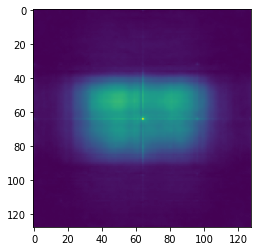

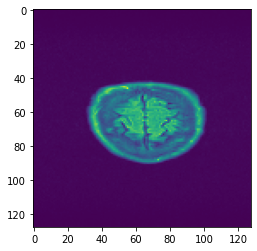

Time taken for epoch:  159.85994815826416
[0, 1]
Dev_Loss 0.008497170030014867 Epoch 1
L1_Loss 0.2640765443998812 L2_Loss 0.1820223613414734 SSIM_Loss 0.25830562499311743 Epoch 1
Epoch = [   1/ 250] TrainLoss = 0.008272  DevLoss = 0.008497 TrainTime = 115.8821s DevTime = 34.1330s


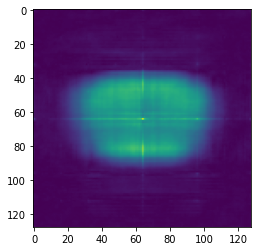

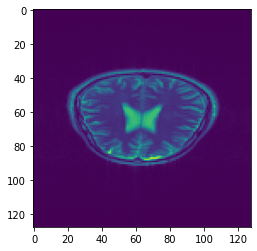

Time taken for epoch:  156.55619883537292
[0, 1]
Dev_Loss 0.009156307473911366 Epoch 2
L1_Loss 0.25619119530733553 L2_Loss 0.2549974503028968 SSIM_Loss 0.26386078413440744 Epoch 2
Epoch = [   2/ 250] TrainLoss = 0.007566  DevLoss = 0.009156 TrainTime = 117.2440s DevTime = 32.6513s


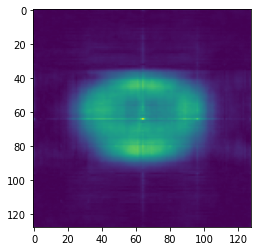

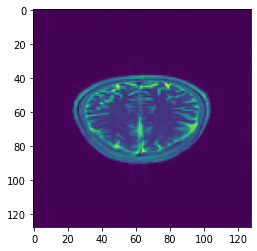

Time taken for epoch:  153.31960320472717
[0, 1]
Dev_Loss 0.00796525268240632 Epoch 3
L1_Loss 0.2568098380031559 L2_Loss 0.25642909839851286 SSIM_Loss 0.24432401458480824 Epoch 3
Epoch = [   3/ 250] TrainLoss = 0.007625  DevLoss = 0.007965 TrainTime = 117.9753s DevTime = 34.3134s


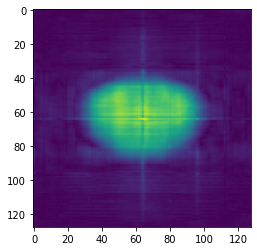

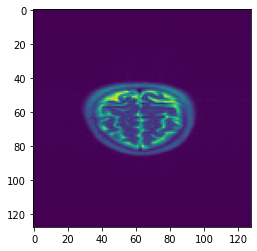

Time taken for epoch:  158.82921528816223
[0, 1]
Dev_Loss 0.00822570355936506 Epoch 4
L1_Loss 0.22766821674891313 L2_Loss 0.22904678306958734 SSIM_Loss 0.22080025480352158 Epoch 4
Epoch = [   4/ 250] TrainLoss = 0.006029  DevLoss = 0.008226 TrainTime = 116.1106s DevTime = 34.0140s


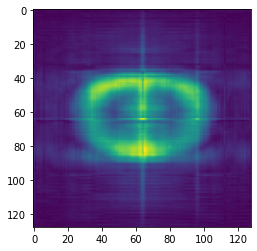

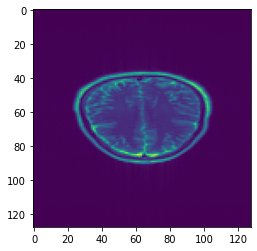

Time taken for epoch:  153.84650301933289
[0, 1]
Dev_Loss 0.007914482046404792 Epoch 5
L1_Loss 0.24045441399281342 L2_Loss 0.24152380449179714 SSIM_Loss 0.20601787516659034 Epoch 5
Epoch = [   5/ 250] TrainLoss = 0.00656  DevLoss = 0.007914 TrainTime = 115.7513s DevTime = 33.1204s


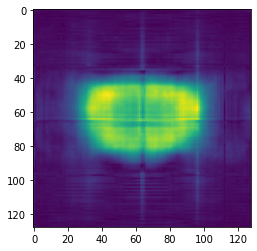

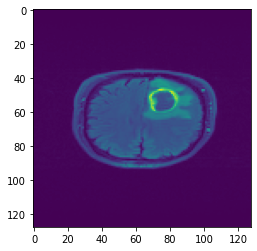

Time taken for epoch:  155.41202449798584
[0, 1]
Dev_Loss 0.008830052951833513 Epoch 6
L1_Loss 0.2256948534139596 L2_Loss 0.21165283556038206 SSIM_Loss 0.2092089175407775 Epoch 6
Epoch = [   6/ 250] TrainLoss = 0.005545  DevLoss = 0.00883 TrainTime = 117.7815s DevTime = 34.2858s


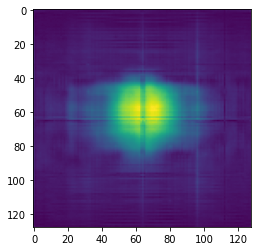

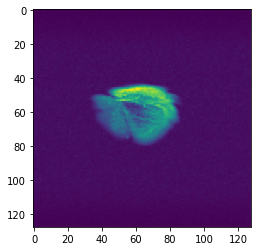

Time taken for epoch:  155.67344069480896
[0, 1]
Dev_Loss 0.00822029000668869 Epoch 7
L1_Loss 0.19423659142911598 L2_Loss 0.21170904691542158 SSIM_Loss 0.2261327758073024 Epoch 7
Epoch = [   7/ 250] TrainLoss = 0.005949  DevLoss = 0.00822 TrainTime = 117.4929s DevTime = 33.3914s


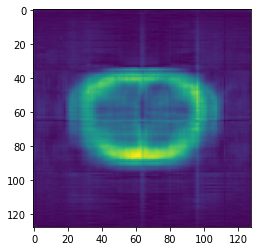

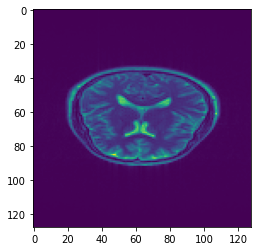

Time taken for epoch:  154.69559979438782
[0, 1]
Dev_Loss 0.008835609692965459 Epoch 8
L1_Loss 0.19591121650094592 L2_Loss 0.19197444393791685 SSIM_Loss 0.21906621921070027 Epoch 8
Epoch = [   8/ 250] TrainLoss = 0.005104  DevLoss = 0.008836 TrainTime = 118.8863s DevTime = 33.8373s


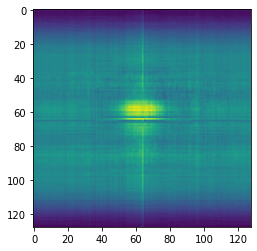

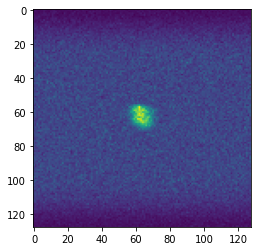

Time taken for epoch:  156.95662641525269
[0, 1]
Dev_Loss 0.0074911739018740185 Epoch 9
L1_Loss 0.20241760613343932 L2_Loss 0.21130932532646454 SSIM_Loss 0.1984729171140659 Epoch 9
Epoch = [   9/ 250] TrainLoss = 0.006209  DevLoss = 0.007491 TrainTime = 116.7400s DevTime = 33.9731s


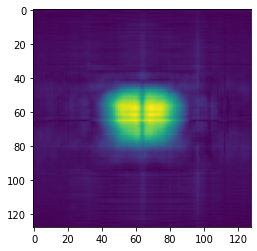

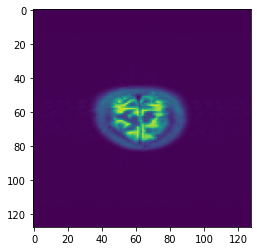

Time taken for epoch:  157.68186211585999
[0, 1]
Dev_Loss 0.007821039710457679 Epoch 10
L1_Loss 0.2061992422357657 L2_Loss 0.21008679337815309 SSIM_Loss 0.2064364139448298 Epoch 10
Epoch = [  10/ 250] TrainLoss = 0.005019  DevLoss = 0.007821 TrainTime = 119.3606s DevTime = 33.7715s


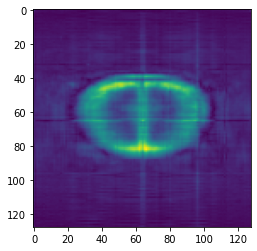

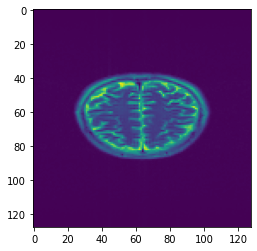

Time taken for epoch:  157.25132083892822
[0, 1]
Dev_Loss 0.007078096111010118 Epoch 11
L1_Loss 0.2088739881838774 L2_Loss 0.2320093744912816 SSIM_Loss 0.2051228015272704 Epoch 11
Epoch = [  11/ 250] TrainLoss = 0.005664  DevLoss = 0.007078 TrainTime = 117.5218s DevTime = 36.1655s


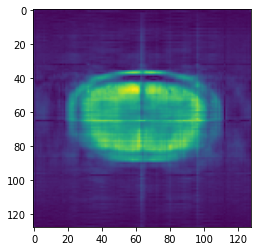

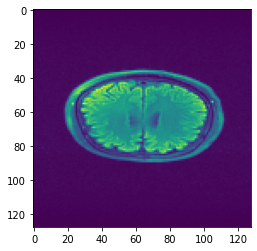

Time taken for epoch:  160.28909397125244
[0, 1]
Dev_Loss 0.007496339509754455 Epoch 12
L1_Loss 0.19333756754353412 L2_Loss 0.2242948257002505 SSIM_Loss 0.2197091627575896 Epoch 12
Epoch = [  12/ 250] TrainLoss = 0.004896  DevLoss = 0.007496 TrainTime = 115.7026s DevTime = 31.9684s


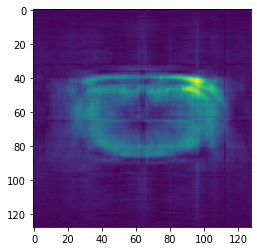

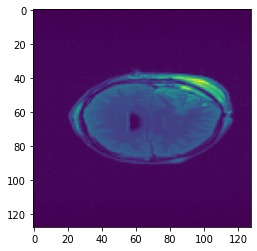

Time taken for epoch:  151.65801739692688
[0, 1]
Dev_Loss 0.007768899569506213 Epoch 13
L1_Loss 0.21315894943011807 L2_Loss 0.23389673322210833 SSIM_Loss 0.21812491160517125 Epoch 13
Epoch = [  13/ 250] TrainLoss = 0.00411  DevLoss = 0.007769 TrainTime = 114.8495s DevTime = 34.2277s


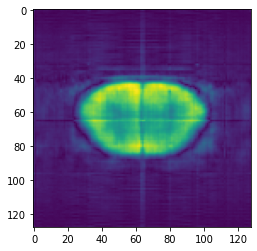

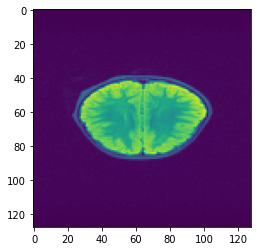

Time taken for epoch:  153.0642912387848
[0, 1]
Dev_Loss 0.006407084094192309 Epoch 14
L1_Loss 0.27036710657578045 L2_Loss 0.22850783887072945 SSIM_Loss 0.24611363393482996 Epoch 14
Epoch = [  14/ 250] TrainLoss = 0.004216  DevLoss = 0.006407 TrainTime = 115.8495s DevTime = 32.1257s


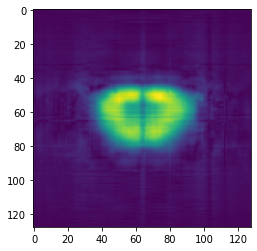

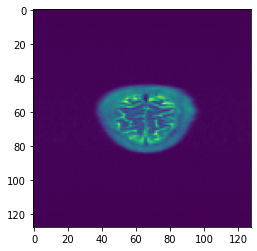

Time taken for epoch:  154.5731554031372
[0, 1]
Dev_Loss 0.0058725490283583395 Epoch 15
L1_Loss 0.26474099038982013 L2_Loss 0.2488665631439282 SSIM_Loss 0.21489501248474321 Epoch 15
Epoch = [  15/ 250] TrainLoss = 0.0046  DevLoss = 0.005873 TrainTime = 115.9181s DevTime = 32.2239s


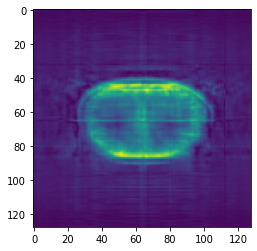

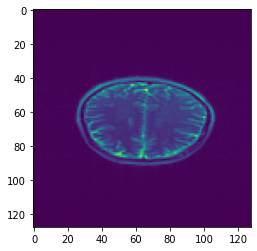

Time taken for epoch:  154.65677618980408
[0, 1]
Dev_Loss 0.005769342095654895 Epoch 16
L1_Loss 0.22890385345095657 L2_Loss 0.25013705066824105 SSIM_Loss 0.2398906563098606 Epoch 16
Epoch = [  16/ 250] TrainLoss = 0.00397  DevLoss = 0.005769 TrainTime = 117.2358s DevTime = 48.1340s


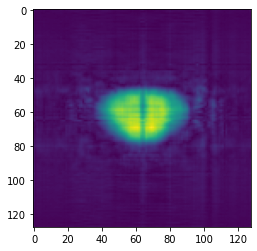

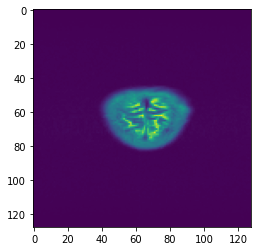

Time taken for epoch:  172.92192220687866
[0, 1]
Dev_Loss 0.005799284037029 Epoch 17
L1_Loss 0.23894934032688153 L2_Loss 0.24239556316189104 SSIM_Loss 0.2594946017532504 Epoch 17
Epoch = [  17/ 250] TrainLoss = 0.003428  DevLoss = 0.005799 TrainTime = 116.5434s DevTime = 33.6430s


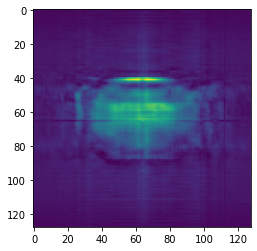

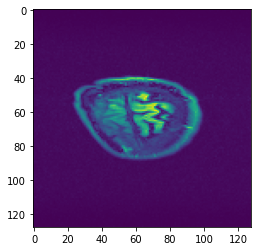

Time taken for epoch:  154.16165471076965
[0, 1]
Dev_Loss 0.006882070202323908 Epoch 18
L1_Loss 0.21521699827647836 L2_Loss 0.21706386818659193 SSIM_Loss 0.24476069015250543 Epoch 18
Epoch = [  18/ 250] TrainLoss = 0.003084  DevLoss = 0.006882 TrainTime = 133.4907s DevTime = 43.8265s


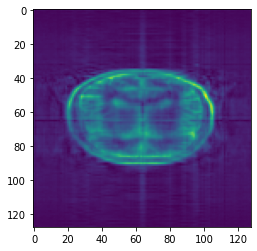

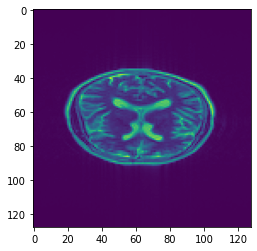

Time taken for epoch:  181.77247953414917
[0, 1]
Dev_Loss 0.005334186032263957 Epoch 19
L1_Loss 0.2860083894016058 L2_Loss 0.27886172276749205 SSIM_Loss 0.27470790031081765 Epoch 19
Epoch = [  19/ 250] TrainLoss = 0.003097  DevLoss = 0.005334 TrainTime = 133.7258s DevTime = 46.4701s


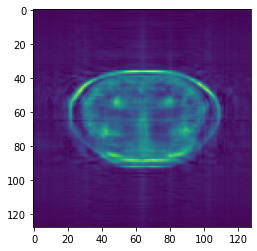

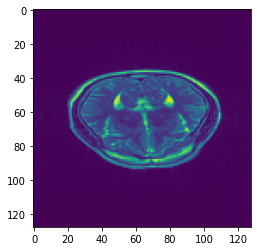

Time taken for epoch:  187.2713761329651
[0, 1]
Dev_Loss 0.006792120931759473 Epoch 20
L1_Loss 0.2848304829231988 L2_Loss 0.2845326549889795 SSIM_Loss 0.2757256099655591 Epoch 20
Epoch = [  20/ 250] TrainLoss = 0.002862  DevLoss = 0.006792 TrainTime = 133.2214s DevTime = 44.4203s


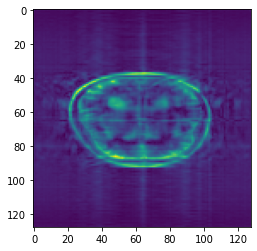

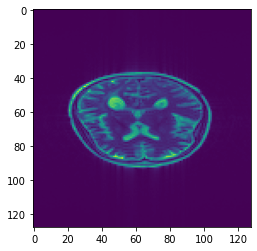

Time taken for epoch:  182.0282461643219
[0, 1]
Dev_Loss 0.005097625748148068 Epoch 21
L1_Loss 0.2660581294299039 L2_Loss 0.2736446300484751 SSIM_Loss 0.25821999396591333 Epoch 21
Epoch = [  21/ 250] TrainLoss = 0.003512  DevLoss = 0.005098 TrainTime = 134.6357s DevTime = 45.7552s


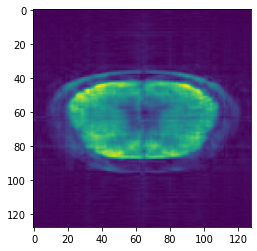

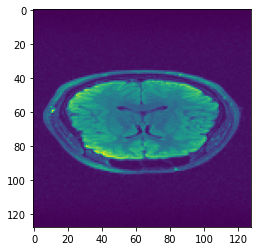

Time taken for epoch:  187.4824948310852
[0, 1]
Dev_Loss 0.004947494029812299 Epoch 22
L1_Loss 0.2861136979451766 L2_Loss 0.26585305522091024 SSIM_Loss 0.28626702175852076 Epoch 22
Epoch = [  22/ 250] TrainLoss = 0.003178  DevLoss = 0.004947 TrainTime = 134.8010s DevTime = 47.5164s


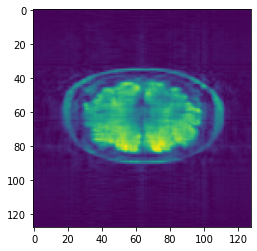

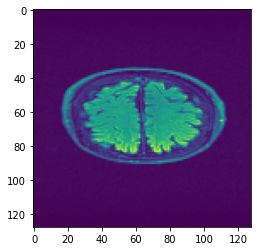

Time taken for epoch:  190.05956482887268
[0, 1]
Dev_Loss 0.004381643425531895 Epoch 23
L1_Loss 0.28917812769746226 L2_Loss 0.29090669937288927 SSIM_Loss 0.2939251166496258 Epoch 23
Epoch = [  23/ 250] TrainLoss = 0.002894  DevLoss = 0.004382 TrainTime = 137.5351s DevTime = 46.6946s


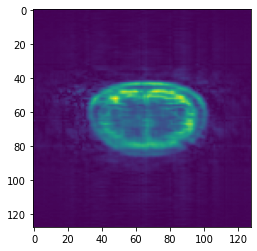

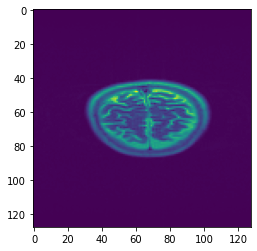

Time taken for epoch:  192.66505455970764
[0, 1]
Dev_Loss 0.004494821998179424 Epoch 24
L1_Loss 0.26161433527501443 L2_Loss 0.27382591355516056 SSIM_Loss 0.2778435535835012 Epoch 24
Epoch = [  24/ 250] TrainLoss = 0.002842  DevLoss = 0.004495 TrainTime = 135.2420s DevTime = 49.6197s


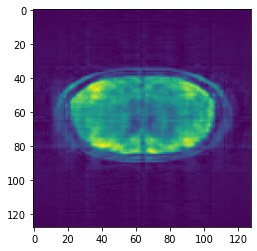

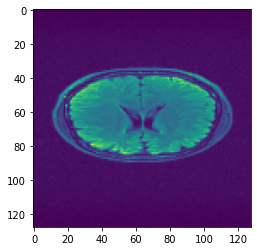

Time taken for epoch:  189.2713384628296
[0, 1]
Dev_Loss 0.004478088791182358 Epoch 25
L1_Loss 0.2344466421721679 L2_Loss 0.29164965718120384 SSIM_Loss 0.2788471092563576 Epoch 25
Epoch = [  25/ 250] TrainLoss = 0.003219  DevLoss = 0.004478 TrainTime = 137.9933s DevTime = 48.9053s


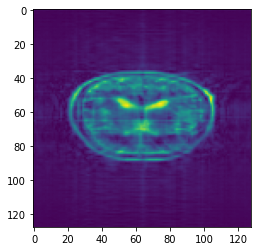

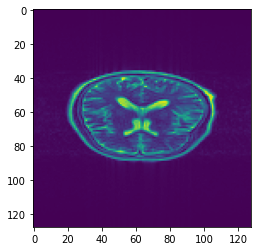

Time taken for epoch:  191.59533667564392
[0, 1]
Dev_Loss 0.004815220794143246 Epoch 26
L1_Loss 0.289809501742014 L2_Loss 0.27819891727712703 SSIM_Loss 0.29647930378331677 Epoch 26
Epoch = [  26/ 250] TrainLoss = 0.002431  DevLoss = 0.004815 TrainTime = 137.9218s DevTime = 48.9755s


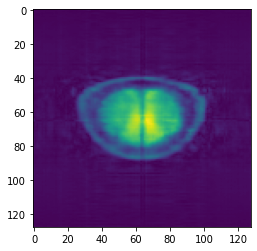

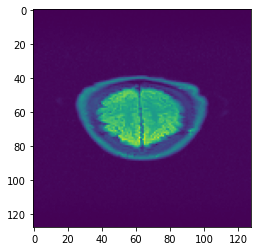

Time taken for epoch:  191.35041046142578
[0, 1]
Dev_Loss 0.004204228001379371 Epoch 27
L1_Loss 0.296444405819182 L2_Loss 0.2894018594197585 SSIM_Loss 0.28786114585183536 Epoch 27
Epoch = [  27/ 250] TrainLoss = 0.002729  DevLoss = 0.004204 TrainTime = 138.1375s DevTime = 48.8772s


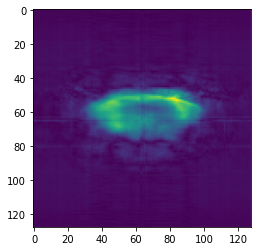

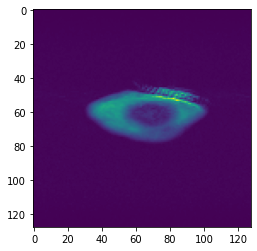

Time taken for epoch:  195.29507541656494
[0, 1]
Dev_Loss 0.004080687449200649 Epoch 28
L1_Loss 0.2935393383553361 L2_Loss 0.27881244748046574 SSIM_Loss 0.2818397098759887 Epoch 28
Epoch = [  28/ 250] TrainLoss = 0.00218  DevLoss = 0.004081 TrainTime = 138.4496s DevTime = 49.0340s


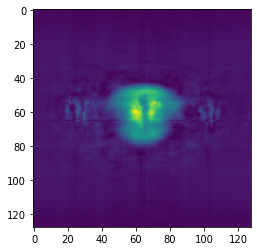

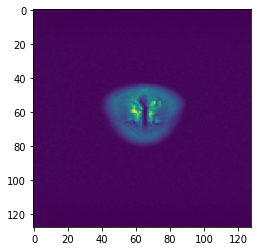

Time taken for epoch:  195.72804474830627
[0, 1]
Dev_Loss 0.004568827457861912 Epoch 29
L1_Loss 0.29320547039403205 L2_Loss 0.2989293924560654 SSIM_Loss 0.2923188183204695 Epoch 29
Epoch = [  29/ 250] TrainLoss = 0.002033  DevLoss = 0.004569 TrainTime = 138.0749s DevTime = 48.8882s


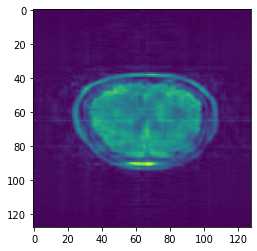

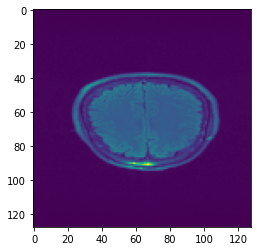

Time taken for epoch:  191.35463428497314
[0, 1]
Dev_Loss 0.004266003391365972 Epoch 30
L1_Loss 0.2979446832264052 L2_Loss 0.2159818485026236 SSIM_Loss 0.30009510882289747 Epoch 30
Epoch = [  30/ 250] TrainLoss = 0.001903  DevLoss = 0.004266 TrainTime = 138.1759s DevTime = 48.9451s


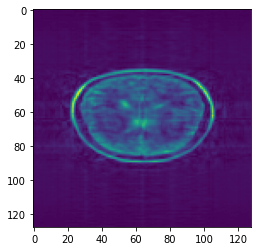

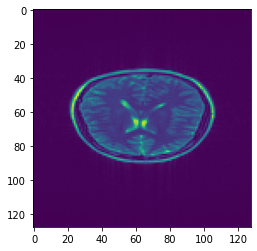

Time taken for epoch:  191.5924813747406
[0, 1]
Dev_Loss 0.00396372369142951 Epoch 31
L1_Loss 0.2782761077692058 L2_Loss 0.28973295674994115 SSIM_Loss 0.2939557847708281 Epoch 31
Epoch = [  31/ 250] TrainLoss = 0.001923  DevLoss = 0.003964 TrainTime = 137.9797s DevTime = 49.0243s


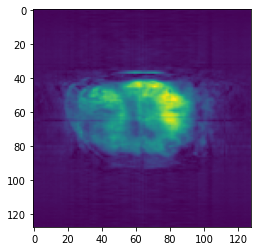

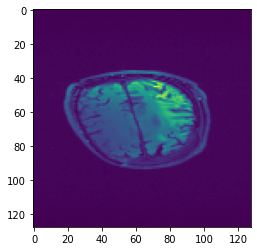

Time taken for epoch:  194.97009086608887
[0, 1]
Dev_Loss 0.005634859811361601 Epoch 32
L1_Loss 0.29157879319146646 L2_Loss 0.3034981250770754 SSIM_Loss 0.29969150065910277 Epoch 32
Epoch = [  32/ 250] TrainLoss = 0.001963  DevLoss = 0.005635 TrainTime = 138.0700s DevTime = 48.8470s


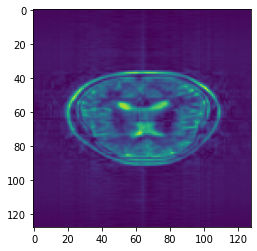

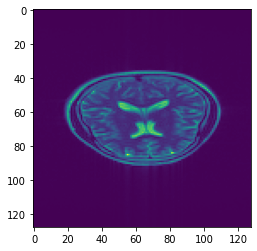

Time taken for epoch:  191.22054982185364
[0, 1]
Dev_Loss 0.0039664488108156004 Epoch 33
L1_Loss 0.2744655196862967 L2_Loss 0.30407771554314394 SSIM_Loss 0.29043219347673066 Epoch 33
Epoch = [  33/ 250] TrainLoss = 0.002214  DevLoss = 0.003966 TrainTime = 138.1266s DevTime = 48.9297s


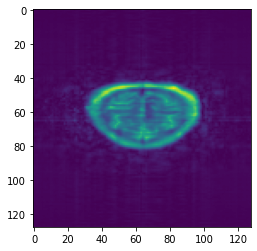

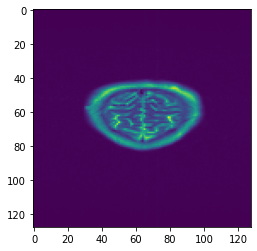

Time taken for epoch:  191.43531227111816
[0, 1]
Dev_Loss 0.004255104013156982 Epoch 34
L1_Loss 0.3040152046005247 L2_Loss 0.2952280516629735 SSIM_Loss 0.2828450920719687 Epoch 34
Epoch = [  34/ 250] TrainLoss = 0.001826  DevLoss = 0.004255 TrainTime = 137.9786s DevTime = 49.0467s


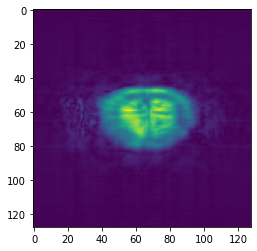

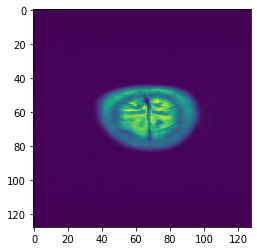

Time taken for epoch:  191.30581212043762
[0, 1]
Dev_Loss 0.003925639180345364 Epoch 35
L1_Loss 0.3041115633583971 L2_Loss 0.3008201938435167 SSIM_Loss 0.30719098533203576 Epoch 35
Epoch = [  35/ 250] TrainLoss = 0.001773  DevLoss = 0.003926 TrainTime = 138.0934s DevTime = 48.9349s


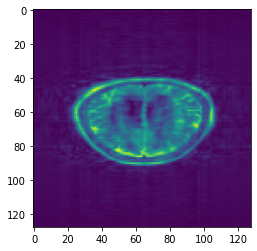

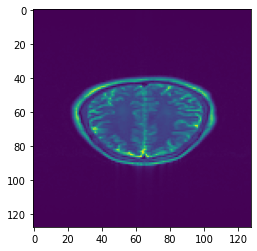

Time taken for epoch:  194.76506972312927
[0, 1]
Dev_Loss 0.003922008829190313 Epoch 36
L1_Loss 0.30265092754557893 L2_Loss 0.2962693469397823 SSIM_Loss 0.30816080104530386 Epoch 36
Epoch = [  36/ 250] TrainLoss = 0.001635  DevLoss = 0.003922 TrainTime = 137.9610s DevTime = 48.8423s


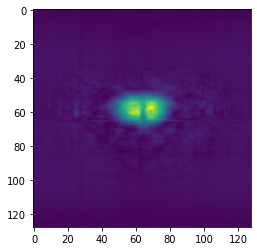

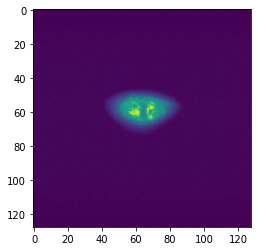

Time taken for epoch:  195.07309126853943
[0, 1]
Dev_Loss 0.004558452805823541 Epoch 37
L1_Loss 0.28805344047479514 L2_Loss 0.287033350762567 SSIM_Loss 0.2999160124151804 Epoch 37
Epoch = [  37/ 250] TrainLoss = 0.001575  DevLoss = 0.004558 TrainTime = 137.9265s DevTime = 49.1433s


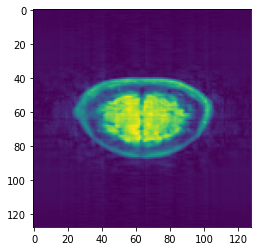

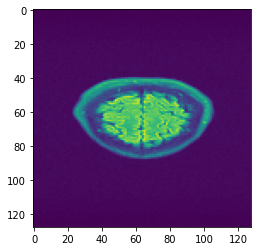

Time taken for epoch:  191.7633717060089
[0, 1]
Dev_Loss 0.0038434846602367163 Epoch 38
L1_Loss 0.29347187761619936 L2_Loss 0.3102922733402086 SSIM_Loss 0.29987891229585645 Epoch 38
Epoch = [  38/ 250] TrainLoss = 0.004872  DevLoss = 0.003843 TrainTime = 138.4621s DevTime = 49.4525s


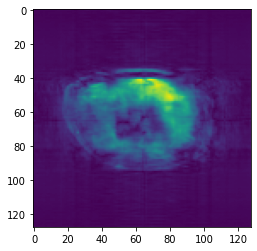

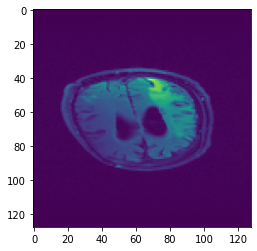

Time taken for epoch:  195.78782987594604
[0, 1]
Dev_Loss 0.0046282111848075565 Epoch 39
L1_Loss 0.2996692606600615 L2_Loss 0.30239386419798214 SSIM_Loss 0.28160976985052066 Epoch 39
Epoch = [  39/ 250] TrainLoss = 0.002132  DevLoss = 0.004628 TrainTime = 138.3267s DevTime = 48.8763s


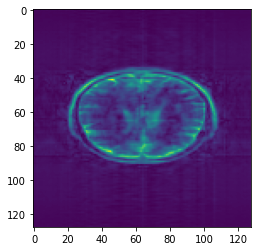

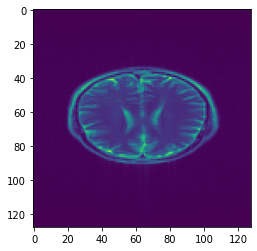

Time taken for epoch:  191.72027230262756
[0, 1]
Dev_Loss 0.0035997976106021956 Epoch 40
L1_Loss 0.3047849797795675 L2_Loss 0.305823021595434 SSIM_Loss 0.29866167259986115 Epoch 40
Epoch = [  40/ 250] TrainLoss = 0.001416  DevLoss = 0.0036 TrainTime = 138.0787s DevTime = 48.9673s


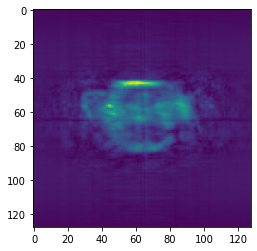

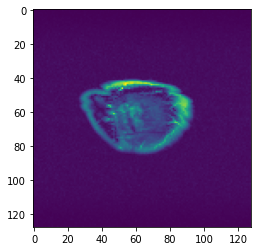

Time taken for epoch:  196.04242491722107
[0, 1]
Dev_Loss 0.003831479580998746 Epoch 41
L1_Loss 0.2992802225638417 L2_Loss 0.26148366708646315 SSIM_Loss 0.30308056242387377 Epoch 41
Epoch = [  41/ 250] TrainLoss = 0.00157  DevLoss = 0.003831 TrainTime = 138.1152s DevTime = 48.9080s


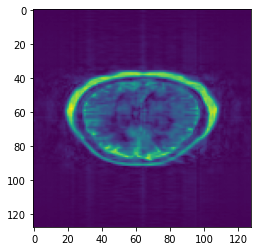

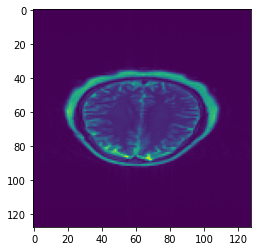

Time taken for epoch:  191.6002233028412
[0, 1]
Dev_Loss 0.003571692251791555 Epoch 42
L1_Loss 0.30188641953492296 L2_Loss 0.2511190079370879 SSIM_Loss 0.30595475222727025 Epoch 42
Epoch = [  42/ 250] TrainLoss = 0.001528  DevLoss = 0.003572 TrainTime = 138.0335s DevTime = 48.8297s


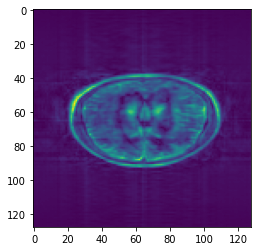

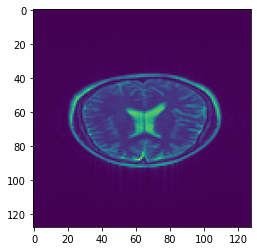

Time taken for epoch:  195.472403049469
[0, 1]
Dev_Loss 0.0040087104738550025 Epoch 43
L1_Loss 0.30306173061186253 L2_Loss 0.27424019515237996 SSIM_Loss 0.30852318343879753 Epoch 43
Epoch = [  43/ 250] TrainLoss = 0.001809  DevLoss = 0.004009 TrainTime = 138.1911s DevTime = 48.9365s


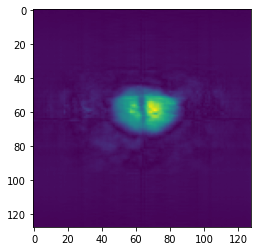

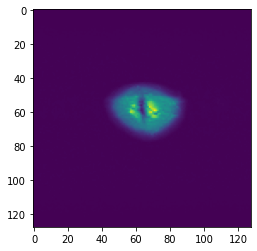

Time taken for epoch:  191.5309727191925
[0, 1]
Dev_Loss 0.003807843000808542 Epoch 44
L1_Loss 0.2985418842949838 L2_Loss 0.2983043318884377 SSIM_Loss 0.2960292825592906 Epoch 44
Epoch = [  44/ 250] TrainLoss = 0.00155  DevLoss = 0.003808 TrainTime = 138.1948s DevTime = 49.0376s


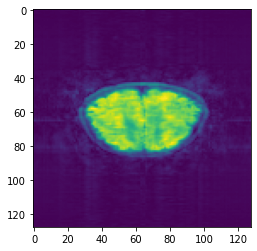

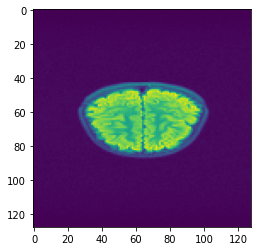

Time taken for epoch:  191.52644801139832
[0, 1]
Dev_Loss 0.0037125480501189337 Epoch 45
L1_Loss 0.31539057414961147 L2_Loss 0.30558669668361543 SSIM_Loss 0.3111910499656435 Epoch 45
Epoch = [  45/ 250] TrainLoss = 0.001761  DevLoss = 0.003713 TrainTime = 138.1759s DevTime = 48.9878s


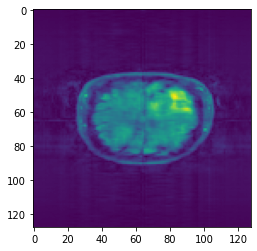

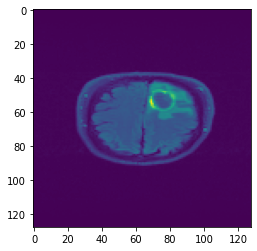

Time taken for epoch:  191.35774755477905
[0, 1]
Dev_Loss 0.003813588623280283 Epoch 46
L1_Loss 0.2998307867632994 L2_Loss 0.30447949430865406 SSIM_Loss 0.30158536232735034 Epoch 46
Epoch = [  46/ 250] TrainLoss = 0.001317  DevLoss = 0.003814 TrainTime = 138.1209s DevTime = 49.0091s


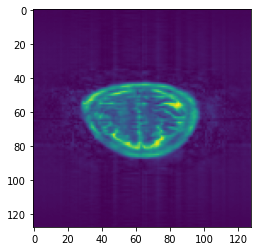

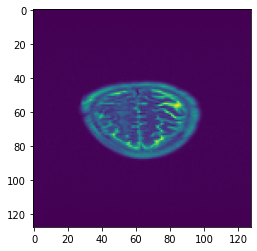

Time taken for epoch:  191.3510982990265
[0, 1]
Dev_Loss 0.004723976156525509 Epoch 47
L1_Loss 0.3053113655615242 L2_Loss 0.3024551208254887 SSIM_Loss 0.3023978083416023 Epoch 47
Epoch = [  47/ 250] TrainLoss = 0.001355  DevLoss = 0.004724 TrainTime = 138.1320s DevTime = 49.0235s


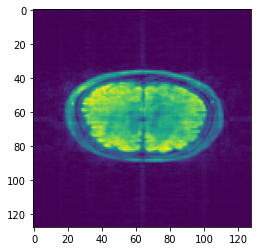

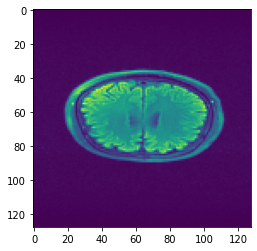

Time taken for epoch:  192.0318992137909
[0, 1]
Dev_Loss 0.003479790690174078 Epoch 48
L1_Loss 0.29985163417681987 L2_Loss 0.298572303085131 SSIM_Loss 0.2718355464360738 Epoch 48
Epoch = [  48/ 250] TrainLoss = 0.002318  DevLoss = 0.00348 TrainTime = 138.0581s DevTime = 48.8392s


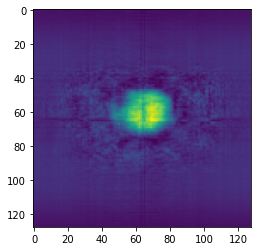

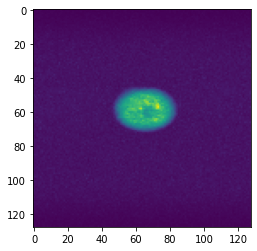

Time taken for epoch:  194.77467560768127
[0, 1]
Dev_Loss 0.0039950121392148446 Epoch 49
L1_Loss 0.29913529453550025 L2_Loss 0.3000939338905449 SSIM_Loss 0.29750028642902987 Epoch 49
Epoch = [  49/ 250] TrainLoss = 0.001506  DevLoss = 0.003995 TrainTime = 138.0747s DevTime = 48.9586s


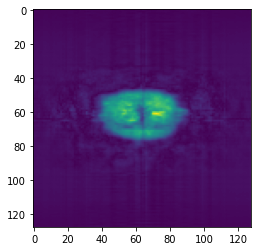

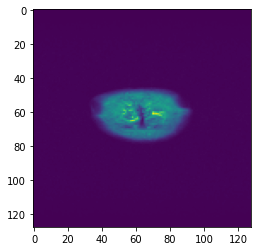

Time taken for epoch:  191.35604095458984
[0, 1]
Dev_Loss 0.0037803724151382226 Epoch 50
L1_Loss 0.29714932191724863 L2_Loss 0.2947337426404871 SSIM_Loss 0.3070039902999096 Epoch 50
Epoch = [  50/ 250] TrainLoss = 0.001204  DevLoss = 0.00378 TrainTime = 138.1937s DevTime = 49.1554s


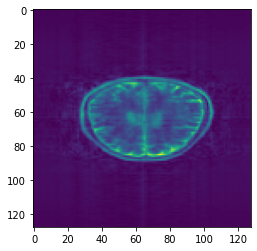

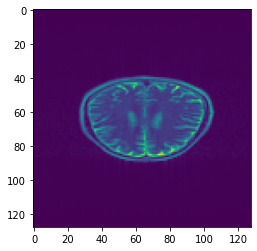

Time taken for epoch:  191.48197174072266
[0, 1]
Dev_Loss 0.0036495931652946365 Epoch 51
L1_Loss 0.24752621468153724 L2_Loss 0.2981262068727753 SSIM_Loss 0.3011802017139286 Epoch 51
Epoch = [  51/ 250] TrainLoss = 0.001569  DevLoss = 0.00365 TrainTime = 138.5014s DevTime = 48.9583s


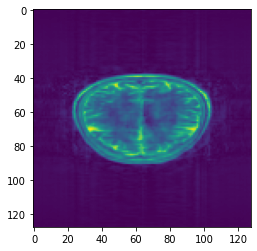

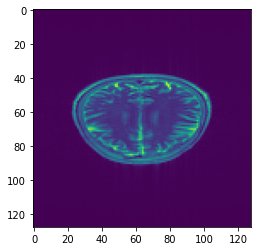

Time taken for epoch:  191.6388795375824
[0, 1]
Dev_Loss 0.003973585267438214 Epoch 52
L1_Loss 0.29104159021163856 L2_Loss 0.29547283024634474 SSIM_Loss 0.30558707068051255 Epoch 52
Epoch = [  52/ 250] TrainLoss = 0.001701  DevLoss = 0.003974 TrainTime = 138.1130s DevTime = 48.9954s


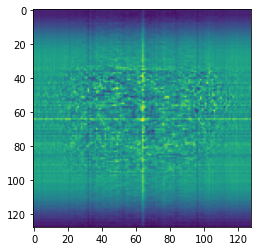

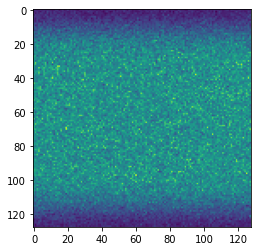

Time taken for epoch:  191.50839018821716
[0, 1]
Dev_Loss 0.0033337057270969067 Epoch 53
L1_Loss 0.30090607850467643 L2_Loss 0.29798766464203913 SSIM_Loss 0.3009766664841875 Epoch 53
Epoch = [  53/ 250] TrainLoss = 0.00114  DevLoss = 0.003334 TrainTime = 138.1146s DevTime = 48.8887s


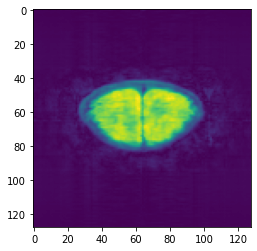

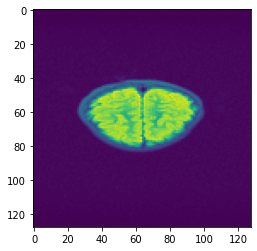

Time taken for epoch:  194.9630527496338
[0, 1]
Dev_Loss 0.0031773949341620273 Epoch 54
L1_Loss 0.3063653913847011 L2_Loss 0.30422996496661664 SSIM_Loss 0.29760696818944793 Epoch 54
Epoch = [  54/ 250] TrainLoss = 0.001133  DevLoss = 0.003177 TrainTime = 138.0727s DevTime = 48.7897s


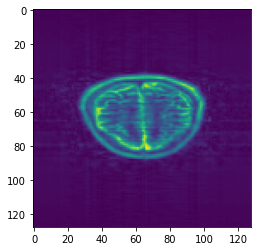

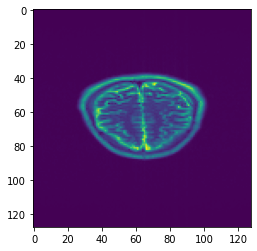

Time taken for epoch:  194.14736342430115
[0, 1]
Dev_Loss 0.003696466688475798 Epoch 55
L1_Loss 0.2892249952590555 L2_Loss 0.30287055457611617 SSIM_Loss 0.30040185152009075 Epoch 55
Epoch = [  55/ 250] TrainLoss = 0.001302  DevLoss = 0.003696 TrainTime = 137.9814s DevTime = 48.9589s


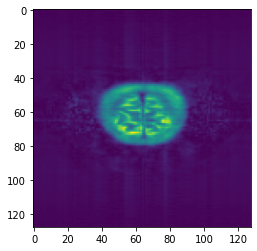

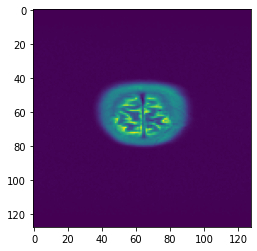

Time taken for epoch:  191.12078666687012
[0, 1]
Dev_Loss 0.003587426015354545 Epoch 56
L1_Loss 0.2724848403288073 L2_Loss 0.2844933908180071 SSIM_Loss 0.29887933924501636 Epoch 56
Epoch = [  56/ 250] TrainLoss = 0.001278  DevLoss = 0.003587 TrainTime = 138.0810s DevTime = 48.9500s


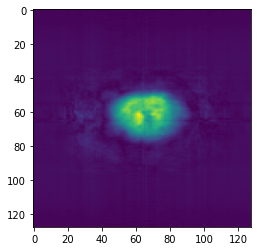

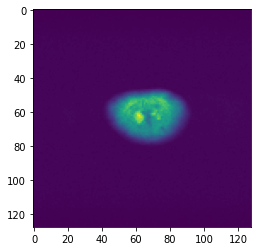

Time taken for epoch:  190.92590975761414
[0, 1]
Dev_Loss 0.003814298007231688 Epoch 57
L1_Loss 0.2958191485801869 L2_Loss 0.30921735218803653 SSIM_Loss 0.2978843498957651 Epoch 57
Epoch = [  57/ 250] TrainLoss = 0.001107  DevLoss = 0.003814 TrainTime = 138.1445s DevTime = 49.0106s


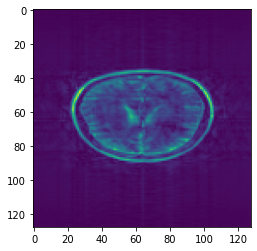

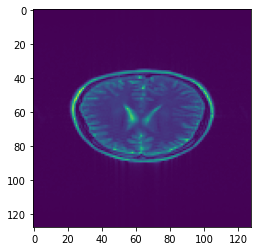

Time taken for epoch:  191.47510695457458
[0, 1]
Dev_Loss 0.003335002021268813 Epoch 58
L1_Loss 0.29409922291472496 L2_Loss 0.3015476169909124 SSIM_Loss 0.2851395277493473 Epoch 58
Epoch = [  58/ 250] TrainLoss = 0.001068  DevLoss = 0.003335 TrainTime = 138.0612s DevTime = 48.9734s


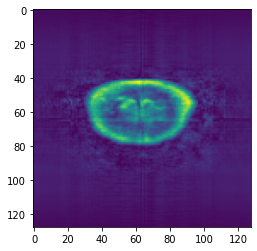

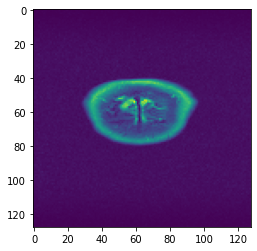

Time taken for epoch:  191.35942935943604
[0, 1]
Dev_Loss 0.0034640094049356402 Epoch 59
L1_Loss 0.28294957131669246 L2_Loss 0.2955236989979562 SSIM_Loss 0.29887802859726853 Epoch 59
Epoch = [  59/ 250] TrainLoss = 0.00113  DevLoss = 0.003464 TrainTime = 138.1924s DevTime = 48.8833s


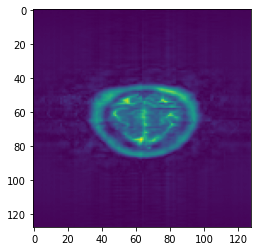

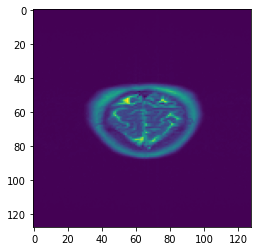

Time taken for epoch:  191.20413827896118
[0, 1]
Dev_Loss 0.0039295342685444065 Epoch 60
L1_Loss 0.292572064198747 L2_Loss 0.30975472354111966 SSIM_Loss 0.30075675113937617 Epoch 60
Epoch = [  60/ 250] TrainLoss = 0.0009777  DevLoss = 0.00393 TrainTime = 138.0961s DevTime = 48.9155s


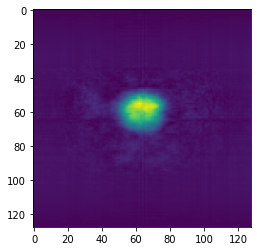

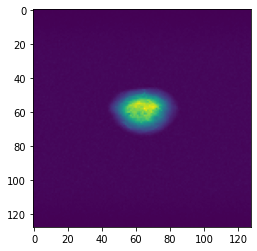

Time taken for epoch:  191.19879913330078
[0, 1]
Dev_Loss 0.0034731307652044277 Epoch 61
L1_Loss 0.298794417459643 L2_Loss 0.28942138200973955 SSIM_Loss 0.27773494443025243 Epoch 61
Epoch = [  61/ 250] TrainLoss = 0.001036  DevLoss = 0.003473 TrainTime = 138.0744s DevTime = 48.8770s


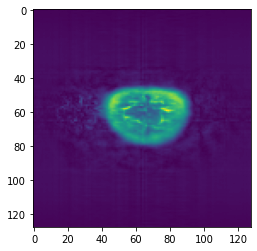

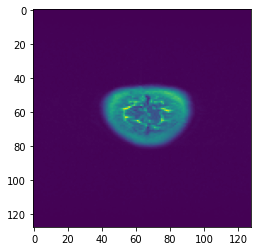

Time taken for epoch:  191.18524169921875
[0, 1]
Dev_Loss 0.0031740723087663957 Epoch 62
L1_Loss 0.2945054869220732 L2_Loss 0.30436852658025076 SSIM_Loss 0.30203144427367007 Epoch 62
Epoch = [  62/ 250] TrainLoss = 0.001263  DevLoss = 0.003174 TrainTime = 138.1870s DevTime = 48.9389s


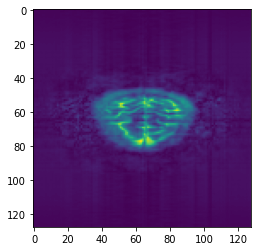

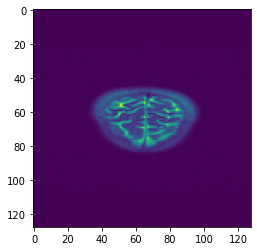

Time taken for epoch:  194.14132475852966
[0, 1]
Dev_Loss 0.004121916665435964 Epoch 63
L1_Loss 0.28401638052720574 L2_Loss 0.29507848212254034 SSIM_Loss 0.2898996443599639 Epoch 63
Epoch = [  63/ 250] TrainLoss = 0.001146  DevLoss = 0.004122 TrainTime = 138.0346s DevTime = 48.8235s


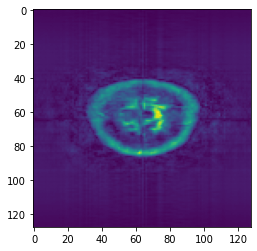

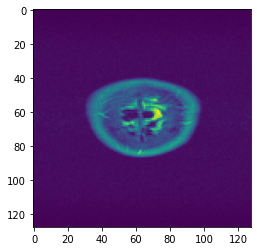

Time taken for epoch:  191.1442792415619
[0, 1]
Dev_Loss 0.0032766031391047445 Epoch 64
L1_Loss 0.2983163222435606 L2_Loss 0.29459017083146394 SSIM_Loss 0.2859448462923892 Epoch 64
Epoch = [  64/ 250] TrainLoss = 0.001127  DevLoss = 0.003277 TrainTime = 138.1010s DevTime = 48.9010s


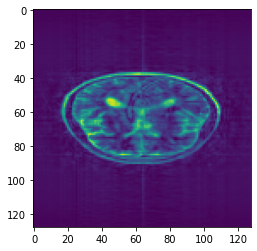

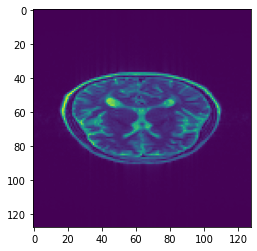

Time taken for epoch:  191.41766571998596
[0, 1]
Dev_Loss 0.0032945171981703606 Epoch 65
L1_Loss 0.2836677027213194 L2_Loss 0.2889221927514423 SSIM_Loss 0.2769312872756285 Epoch 65
Epoch = [  65/ 250] TrainLoss = 0.0009411  DevLoss = 0.003295 TrainTime = 138.1435s DevTime = 49.0849s


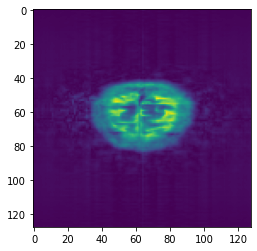

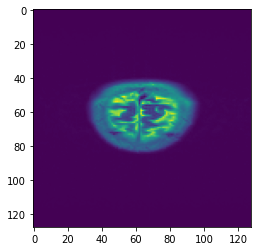

Time taken for epoch:  191.64608550071716
[0, 1]
Dev_Loss 0.003333555117716508 Epoch 66
L1_Loss 0.288661475418429 L2_Loss 0.2897099271892745 SSIM_Loss 0.2907997768321369 Epoch 66
Epoch = [  66/ 250] TrainLoss = 0.00148  DevLoss = 0.003334 TrainTime = 138.0307s DevTime = 48.8169s


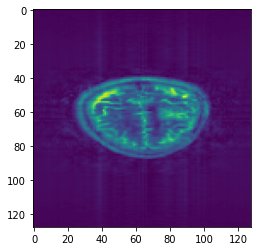

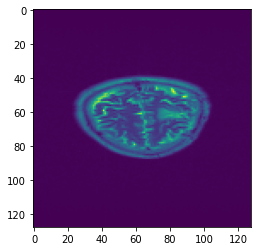

Time taken for epoch:  191.34565329551697
[0, 1]
Dev_Loss 0.003111718869982523 Epoch 67
L1_Loss 0.2822553425910406 L2_Loss 0.2948966296182961 SSIM_Loss 0.2935871058295039 Epoch 67
Epoch = [  67/ 250] TrainLoss = 0.001012  DevLoss = 0.003112 TrainTime = 138.1174s DevTime = 48.9577s


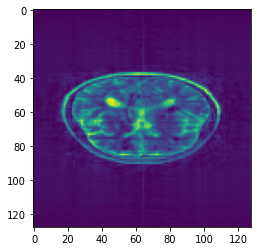

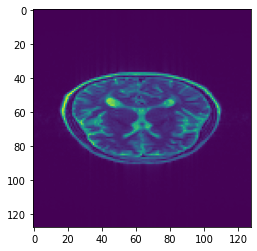

Time taken for epoch:  195.55689477920532
[0, 1]
Dev_Loss 0.003470331002518785 Epoch 68
L1_Loss 0.29410262153148387 L2_Loss 0.28851574950192244 SSIM_Loss 0.273951540852038 Epoch 68
Epoch = [  68/ 250] TrainLoss = 0.001282  DevLoss = 0.00347 TrainTime = 138.1784s DevTime = 49.0202s


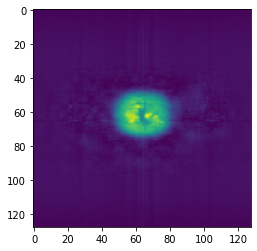

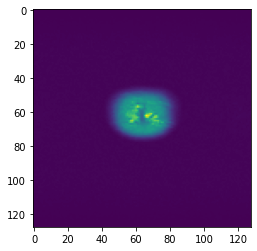

Time taken for epoch:  191.49452090263367
[0, 1]
Dev_Loss 0.0034446223644429607 Epoch 69
L1_Loss 0.28961675224983113 L2_Loss 0.298624903149296 SSIM_Loss 0.2939073628544568 Epoch 69
Epoch = [  69/ 250] TrainLoss = 0.001198  DevLoss = 0.003445 TrainTime = 138.0380s DevTime = 49.0497s


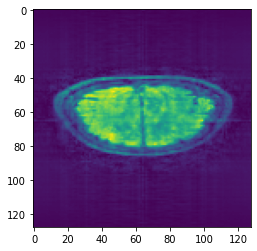

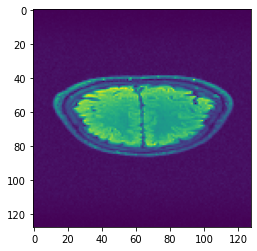

Time taken for epoch:  191.1240599155426
[0, 1]
Dev_Loss 0.003477167047231177 Epoch 70
L1_Loss 0.30018293300270105 L2_Loss 0.2912200246579185 SSIM_Loss 0.2485594449717036 Epoch 70
Epoch = [  70/ 250] TrainLoss = 0.00117  DevLoss = 0.003477 TrainTime = 138.0491s DevTime = 48.9834s


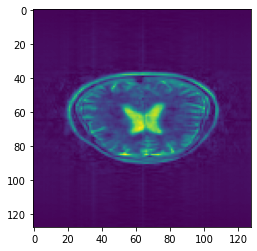

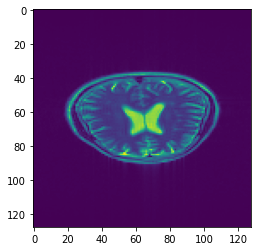

Time taken for epoch:  191.0687894821167
[0, 1]
Dev_Loss 0.0030801498525718815 Epoch 71
L1_Loss 0.2839364362294519 L2_Loss 0.29633511489781716 SSIM_Loss 0.2865460720740987 Epoch 71
Epoch = [  71/ 250] TrainLoss = 0.0008867  DevLoss = 0.00308 TrainTime = 138.1932s DevTime = 49.1357s


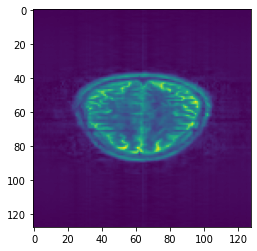

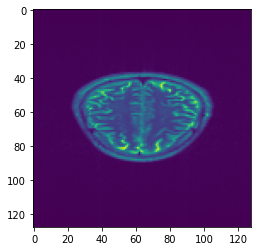

Time taken for epoch:  195.34862637519836
[0, 1]
Dev_Loss 0.0033145518512596203 Epoch 72
L1_Loss 0.2856444580709654 L2_Loss 0.3019992190529636 SSIM_Loss 0.2921792534988807 Epoch 72
Epoch = [  72/ 250] TrainLoss = 0.001094  DevLoss = 0.003315 TrainTime = 138.1963s DevTime = 48.8994s


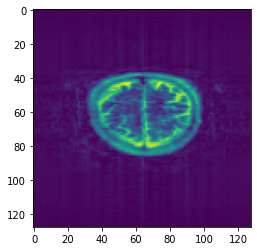

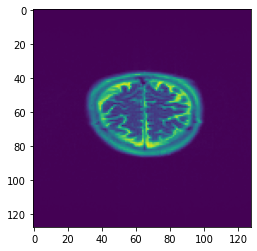

Time taken for epoch:  191.41693019866943
[0, 1]
Dev_Loss 0.0032959515818990403 Epoch 73
L1_Loss 0.2823620946499568 L2_Loss 0.28644141776339993 SSIM_Loss 0.28043402174076576 Epoch 73
Epoch = [  73/ 250] TrainLoss = 0.0009863  DevLoss = 0.003296 TrainTime = 138.2761s DevTime = 49.0258s


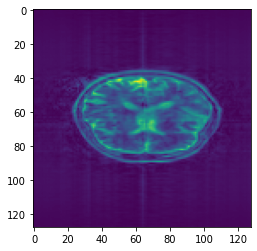

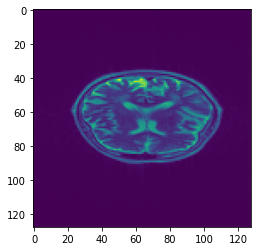

Time taken for epoch:  191.8483853340149
[0, 1]
Dev_Loss 0.0031118277590836143 Epoch 74
L1_Loss 0.2872215561547852 L2_Loss 0.2920908919556778 SSIM_Loss 0.28662251231006214 Epoch 74
Epoch = [  74/ 250] TrainLoss = 0.001303  DevLoss = 0.003112 TrainTime = 138.1192s DevTime = 48.9565s


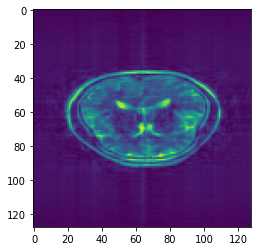

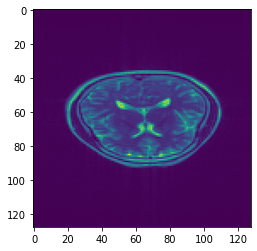

Time taken for epoch:  192.68003821372986
[0, 1]
Dev_Loss 0.003165552600480911 Epoch 75
L1_Loss 0.28780184669911635 L2_Loss 0.29665645565404225 SSIM_Loss 0.301521689067969 Epoch 75
Epoch = [  75/ 250] TrainLoss = 0.0009767  DevLoss = 0.003166 TrainTime = 138.0561s DevTime = 49.0189s


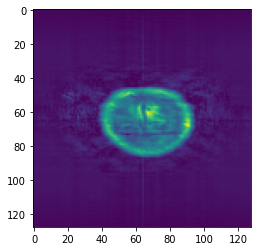

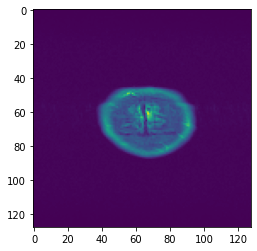

Time taken for epoch:  191.50533533096313
[0, 1]
Dev_Loss 0.003114092398345243 Epoch 76
L1_Loss 0.30001517688818063 L2_Loss 0.2869820829064811 SSIM_Loss 0.2907125163511942 Epoch 76
Epoch = [  76/ 250] TrainLoss = 0.0009126  DevLoss = 0.003114 TrainTime = 138.0246s DevTime = 48.8814s


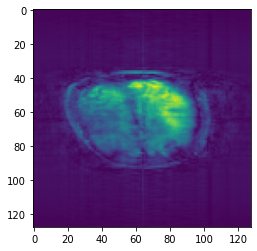

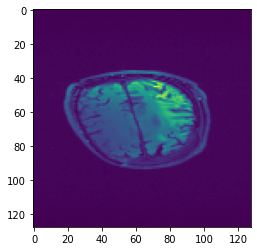

Time taken for epoch:  191.38081336021423
[0, 1]
Dev_Loss 0.0032020550853554424 Epoch 77
L1_Loss 0.2848519534730945 L2_Loss 0.30268001391204685 SSIM_Loss 0.2982379462224763 Epoch 77
Epoch = [  77/ 250] TrainLoss = 0.0009817  DevLoss = 0.003202 TrainTime = 138.0013s DevTime = 46.4615s


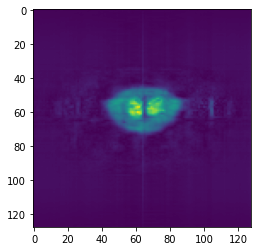

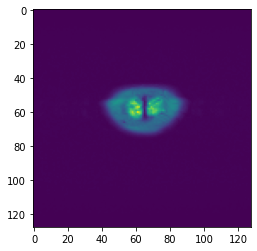

Time taken for epoch:  189.1422827243805
[0, 1]
Dev_Loss 0.0032639300579875644 Epoch 78
L1_Loss 0.2831096760507916 L2_Loss 0.2899792506514584 SSIM_Loss 0.3039862645928961 Epoch 78
Epoch = [  78/ 250] TrainLoss = 0.00151  DevLoss = 0.003264 TrainTime = 134.5878s DevTime = 47.1721s


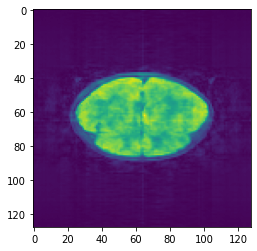

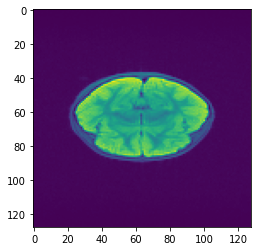

Time taken for epoch:  186.22047400474548
[0, 1]
Dev_Loss 0.003057490505428773 Epoch 79
L1_Loss 0.29399264627253174 L2_Loss 0.2968889100099544 SSIM_Loss 0.28708573577976443 Epoch 79
Epoch = [  79/ 250] TrainLoss = 0.001007  DevLoss = 0.003057 TrainTime = 135.4968s DevTime = 47.4973s


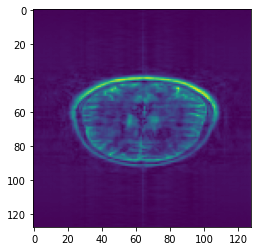

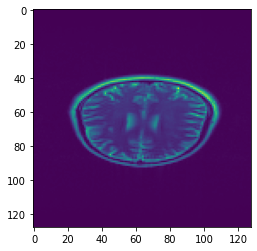

Time taken for epoch:  190.9654619693756
[0, 1]
Dev_Loss 0.0033019677485096265 Epoch 80
L1_Loss 0.2904306754747495 L2_Loss 0.2806685983377672 SSIM_Loss 0.2998393969022723 Epoch 80
Epoch = [  80/ 250] TrainLoss = 0.00116  DevLoss = 0.003302 TrainTime = 135.5026s DevTime = 46.9765s


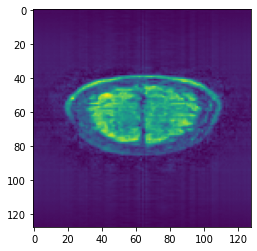

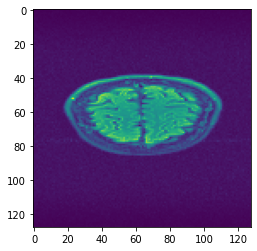

Time taken for epoch:  186.85505509376526
[0, 1]
Dev_Loss 0.003503061420791105 Epoch 81
L1_Loss 0.29375519159584185 L2_Loss 0.2863864052560105 SSIM_Loss 0.2861501488815729 Epoch 81
Epoch = [  81/ 250] TrainLoss = 0.0009012  DevLoss = 0.003503 TrainTime = 135.9553s DevTime = 46.7841s


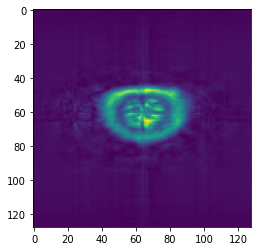

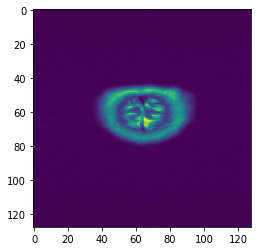

Time taken for epoch:  187.04669952392578
[0, 1]
Dev_Loss 0.003499013698888887 Epoch 82
L1_Loss 0.2758072199998247 L2_Loss 0.28258003192645537 SSIM_Loss 0.27932618658272407 Epoch 82
Epoch = [  82/ 250] TrainLoss = 0.0007721  DevLoss = 0.003499 TrainTime = 133.8405s DevTime = 47.7717s


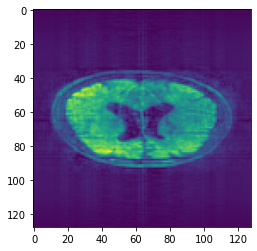

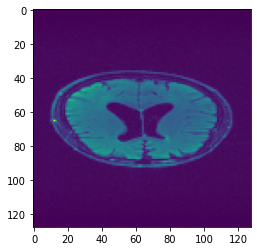

Time taken for epoch:  185.76503586769104
[0, 1]
Dev_Loss 0.003192156820460729 Epoch 83
L1_Loss 0.29564894391686425 L2_Loss 0.28594151273685914 SSIM_Loss 0.29948812293933086 Epoch 83
Epoch = [  83/ 250] TrainLoss = 0.001349  DevLoss = 0.003192 TrainTime = 135.4264s DevTime = 47.3072s


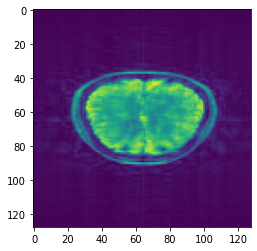

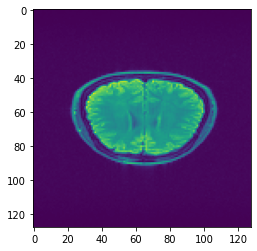

Time taken for epoch:  186.56017804145813
[0, 1]
Dev_Loss 0.003042977307064167 Epoch 84
L1_Loss 0.2790908177535187 L2_Loss 0.28852482942512264 SSIM_Loss 0.2765559313198486 Epoch 84
Epoch = [  84/ 250] TrainLoss = 0.0007922  DevLoss = 0.003043 TrainTime = 136.0206s DevTime = 46.5389s


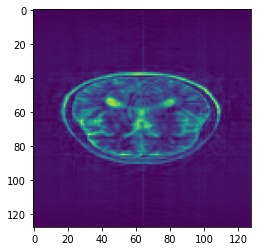

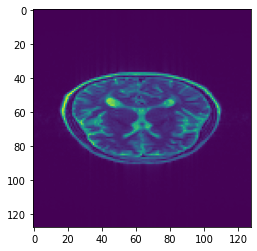

Time taken for epoch:  190.73971271514893
[0, 1]
Dev_Loss 0.0034712044891928857 Epoch 85
L1_Loss 0.25498868036246153 L2_Loss 0.2811500558754694 SSIM_Loss 0.2889648661249605 Epoch 85
Epoch = [  85/ 250] TrainLoss = 0.001014  DevLoss = 0.003471 TrainTime = 135.6004s DevTime = 45.7689s


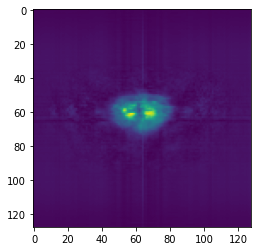

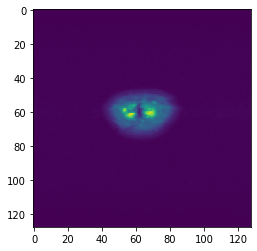

Time taken for epoch:  185.45790147781372
[0, 1]
Dev_Loss 0.0030523866593945566 Epoch 86
L1_Loss 0.28479879286009807 L2_Loss 0.2965189980114387 SSIM_Loss 0.282352176668165 Epoch 86
Epoch = [  86/ 250] TrainLoss = 0.0008554  DevLoss = 0.003052 TrainTime = 136.0531s DevTime = 45.9519s


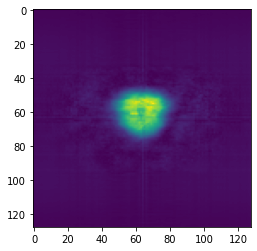

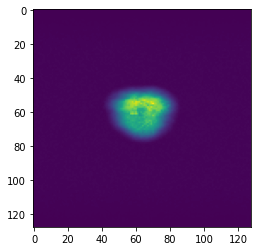

Time taken for epoch:  186.10646557807922
[0, 1]
Dev_Loss 0.0031493478814210558 Epoch 87
L1_Loss 0.298705829703643 L2_Loss 0.2824618898445445 SSIM_Loss 0.2882388029382236 Epoch 87
Epoch = [  87/ 250] TrainLoss = 0.001092  DevLoss = 0.003149 TrainTime = 135.5451s DevTime = 46.3160s


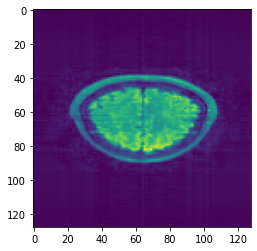

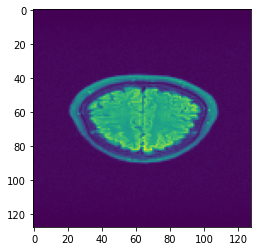

Time taken for epoch:  186.11758470535278
[0, 1]
Dev_Loss 0.0034211008158346015 Epoch 88
L1_Loss 0.2853896052300276 L2_Loss 0.27755625011262375 SSIM_Loss 0.2996564658812007 Epoch 88
Epoch = [  88/ 250] TrainLoss = 0.0008533  DevLoss = 0.003421 TrainTime = 135.3131s DevTime = 45.9190s


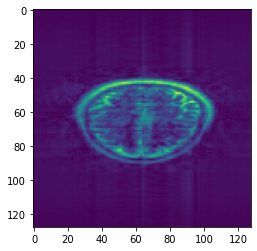

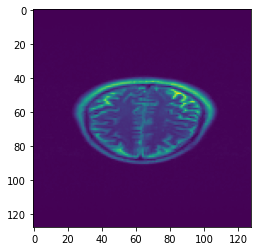

Time taken for epoch:  185.15258598327637
[0, 1]
Dev_Loss 0.003349971070939468 Epoch 89
L1_Loss 0.28955279946560325 L2_Loss 0.27310212254097876 SSIM_Loss 0.2913533773820154 Epoch 89
Epoch = [  89/ 250] TrainLoss = 0.0008346  DevLoss = 0.00335 TrainTime = 135.4299s DevTime = 46.9065s


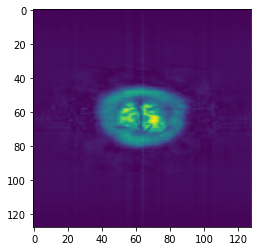

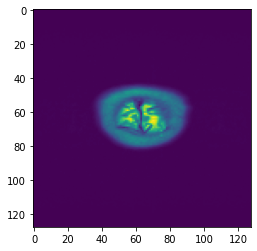

Time taken for epoch:  186.42577695846558
[0, 1]
Dev_Loss 0.002920085211890795 Epoch 90
L1_Loss 0.26672951831069297 L2_Loss 0.2728672947259807 SSIM_Loss 0.282659886594032 Epoch 90
Epoch = [  90/ 250] TrainLoss = 0.0008418  DevLoss = 0.00292 TrainTime = 135.6701s DevTime = 46.2421s


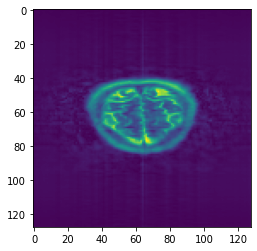

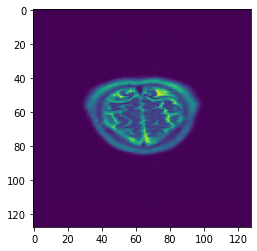

Time taken for epoch:  189.12028408050537
[0, 1]
Dev_Loss 0.0034449058686962753 Epoch 91
L1_Loss 0.23590494404395893 L2_Loss 0.276364333254885 SSIM_Loss 0.286118859181529 Epoch 91
Epoch = [  91/ 250] TrainLoss = 0.0008835  DevLoss = 0.003445 TrainTime = 135.7561s DevTime = 46.7212s


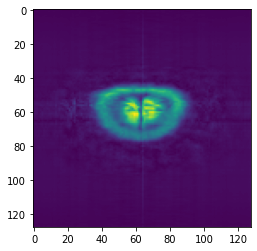

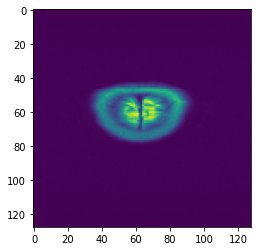

Time taken for epoch:  186.70077419281006
[0, 1]
Dev_Loss 0.0031333434251938483 Epoch 92
L1_Loss 0.29354881482651746 L2_Loss 0.29117308278084436 SSIM_Loss 0.3029261135315708 Epoch 92
Epoch = [  92/ 250] TrainLoss = 0.0008095  DevLoss = 0.003133 TrainTime = 135.4749s DevTime = 47.2068s


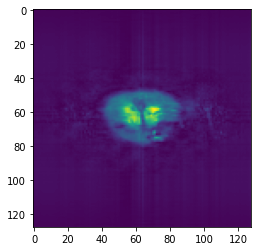

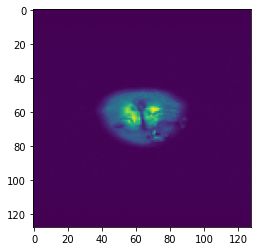

Time taken for epoch:  186.83234786987305
[0, 1]
Dev_Loss 0.002922042890081896 Epoch 93
L1_Loss 0.28566199992947766 L2_Loss 0.2739741360022961 SSIM_Loss 0.2939634130004106 Epoch 93
Epoch = [  93/ 250] TrainLoss = 0.0008902  DevLoss = 0.002922 TrainTime = 133.6364s DevTime = 47.2718s


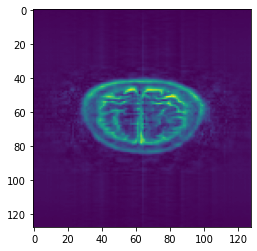

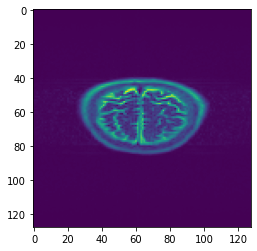

Time taken for epoch:  184.7686631679535
[0, 1]
Dev_Loss 0.003361068583244289 Epoch 94
L1_Loss 0.2934595217155516 L2_Loss 0.2773744620028505 SSIM_Loss 0.2907539670199658 Epoch 94
Epoch = [  94/ 250] TrainLoss = 0.0008839  DevLoss = 0.003361 TrainTime = 135.4119s DevTime = 47.5484s


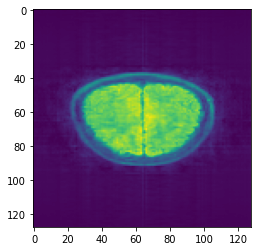

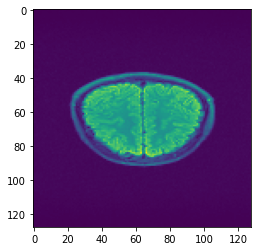

Time taken for epoch:  186.82952308654785
[0, 1]
Dev_Loss 0.0032948396591670755 Epoch 95
L1_Loss 0.27759085104670106 L2_Loss 0.28495205612032376 SSIM_Loss 0.2866935551961147 Epoch 95
Epoch = [  95/ 250] TrainLoss = 0.001173  DevLoss = 0.003295 TrainTime = 135.7271s DevTime = 47.4317s


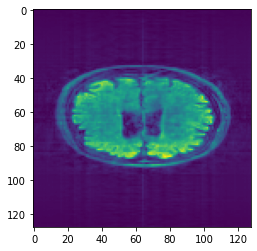

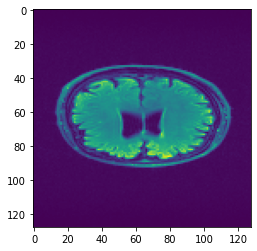

Time taken for epoch:  187.1288628578186
[0, 1]
Dev_Loss 0.003241982354890609 Epoch 96
L1_Loss 0.3015248456164429 L2_Loss 0.28471458980797854 SSIM_Loss 0.24647927835569383 Epoch 96
Epoch = [  96/ 250] TrainLoss = 0.0008212  DevLoss = 0.003242 TrainTime = 135.7424s DevTime = 47.1709s


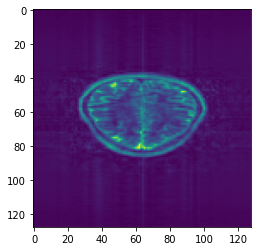

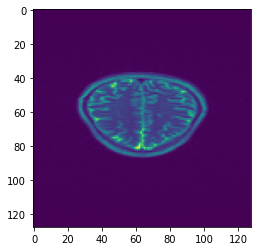

Time taken for epoch:  186.84506106376648
[0, 1]
Dev_Loss 0.0030498949659272627 Epoch 97
L1_Loss 0.24718863429137347 L2_Loss 0.27849200535341584 SSIM_Loss 0.2858697533840815 Epoch 97
Epoch = [  97/ 250] TrainLoss = 0.0007829  DevLoss = 0.00305 TrainTime = 135.6460s DevTime = 47.1941s


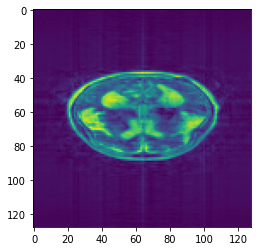

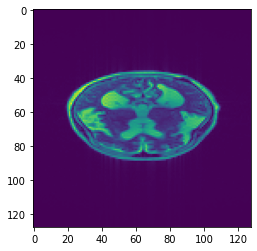

Time taken for epoch:  186.95562052726746
[0, 1]
Dev_Loss 0.003229235801710152 Epoch 98
L1_Loss 0.28522235880198804 L2_Loss 0.2873523407210477 SSIM_Loss 0.27748298499137347 Epoch 98
Epoch = [  98/ 250] TrainLoss = 0.0007965  DevLoss = 0.003229 TrainTime = 136.9679s DevTime = 46.8166s


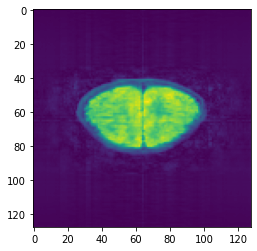

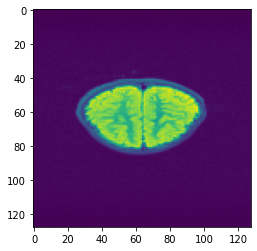

Time taken for epoch:  187.95683407783508
[0, 1]
Dev_Loss 0.0032526059440564185 Epoch 99
L1_Loss 0.2848157364365829 L2_Loss 0.2702587045632538 SSIM_Loss 0.28576406369591656 Epoch 99
Epoch = [  99/ 250] TrainLoss = 0.0008533  DevLoss = 0.003253 TrainTime = 135.9531s DevTime = 46.3519s


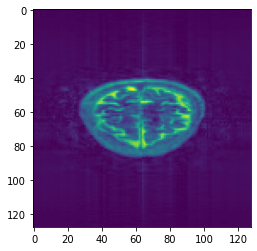

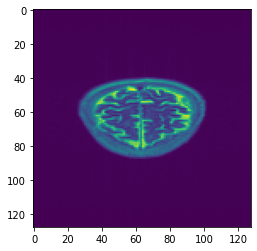

Time taken for epoch:  186.58809161186218
[0, 1]
Dev_Loss 0.003127679175493714 Epoch 100
L1_Loss 0.28888529528132295 L2_Loss 0.2818374398007864 SSIM_Loss 0.2933119654086946 Epoch 100
Epoch = [ 100/ 250] TrainLoss = 0.0008897  DevLoss = 0.003128 TrainTime = 135.9690s DevTime = 47.2262s


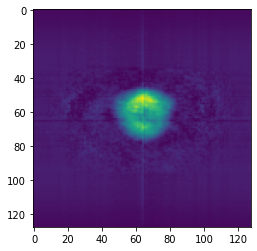

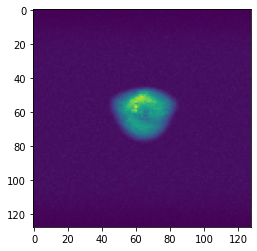

Time taken for epoch:  187.3409743309021
[0, 1]
Dev_Loss 0.003069601431170381 Epoch 101
L1_Loss 0.27989878141297525 L2_Loss 0.2867087560170373 SSIM_Loss 0.29755647802840496 Epoch 101
Epoch = [ 101/ 250] TrainLoss = 0.0007254  DevLoss = 0.00307 TrainTime = 136.1463s DevTime = 48.3725s


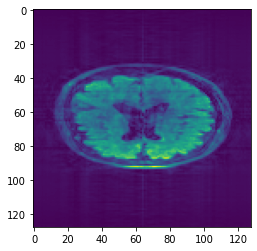

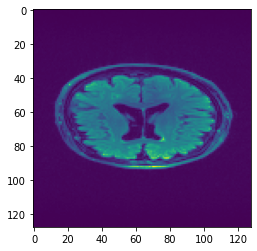

Time taken for epoch:  188.681791305542
[0, 1]
Dev_Loss 0.0030001617631348304 Epoch 102
L1_Loss 0.2781964268388527 L2_Loss 0.29359863340220455 SSIM_Loss 0.2644842392572219 Epoch 102
Epoch = [ 102/ 250] TrainLoss = 0.0007921  DevLoss = 0.003 TrainTime = 134.8271s DevTime = 46.9893s


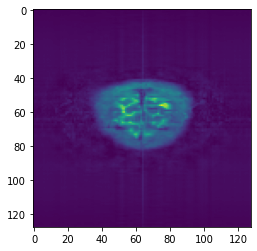

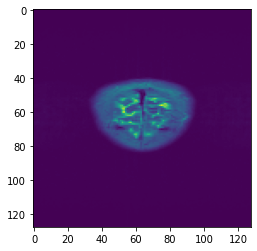

Time taken for epoch:  185.90921807289124
[0, 1]
Dev_Loss 0.0031355738700184926 Epoch 103
L1_Loss 0.29163507233324415 L2_Loss 0.28727833082168586 SSIM_Loss 0.2859604281512867 Epoch 103
Epoch = [ 103/ 250] TrainLoss = 0.0007259  DevLoss = 0.003136 TrainTime = 134.9217s DevTime = 47.1703s


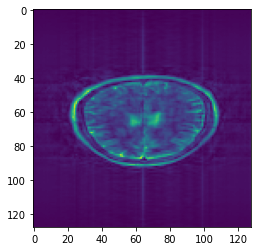

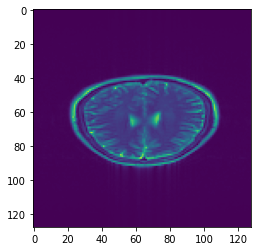

Time taken for epoch:  186.3681344985962
[0, 1]
Dev_Loss 0.003052158390191972 Epoch 104
L1_Loss 0.2872960933454714 L2_Loss 0.2789769526655473 SSIM_Loss 0.2833056550767472 Epoch 104
Epoch = [ 104/ 250] TrainLoss = 0.000946  DevLoss = 0.003052 TrainTime = 136.0578s DevTime = 46.1927s


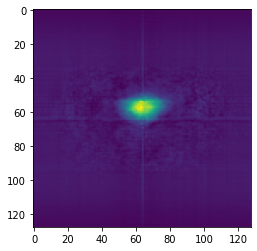

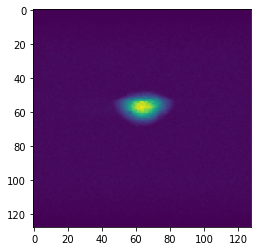

Time taken for epoch:  186.29400372505188
[0, 1]
Dev_Loss 0.003115913104353845 Epoch 105
L1_Loss 0.29871836383737554 L2_Loss 0.2912575830085569 SSIM_Loss 0.28823609908191783 Epoch 105
Epoch = [ 105/ 250] TrainLoss = 0.000796  DevLoss = 0.003116 TrainTime = 135.8865s DevTime = 46.7718s


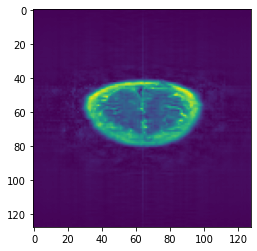

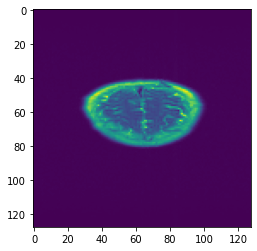

Time taken for epoch:  186.60970258712769
[0, 1]
Dev_Loss 0.0030837720947908863 Epoch 106
L1_Loss 0.2889309950421283 L2_Loss 0.2939855730696174 SSIM_Loss 0.2826612489588897 Epoch 106
Epoch = [ 106/ 250] TrainLoss = 0.0007655  DevLoss = 0.003084 TrainTime = 135.2554s DevTime = 46.9750s


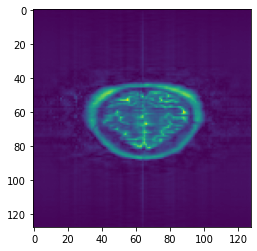

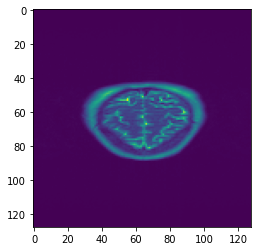

Time taken for epoch:  186.0238275527954
[0, 1]
Dev_Loss 0.0030368665521280447 Epoch 107
L1_Loss 0.2787382396620118 L2_Loss 0.29049186683915174 SSIM_Loss 0.28824432118968163 Epoch 107
Epoch = [ 107/ 250] TrainLoss = 0.000738  DevLoss = 0.003037 TrainTime = 134.6427s DevTime = 45.8605s


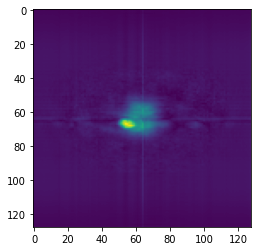

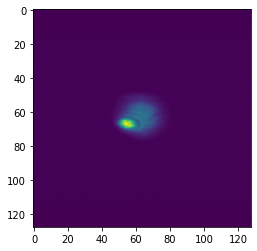

Time taken for epoch:  184.1632490158081
[0, 1]
Dev_Loss 0.003060831067028471 Epoch 108
L1_Loss 0.28422973535323426 L2_Loss 0.2837250582489594 SSIM_Loss 0.29079910552396077 Epoch 108
Epoch = [ 108/ 250] TrainLoss = 0.0006273  DevLoss = 0.003061 TrainTime = 132.6346s DevTime = 43.6972s


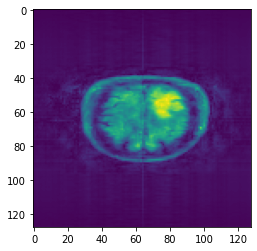

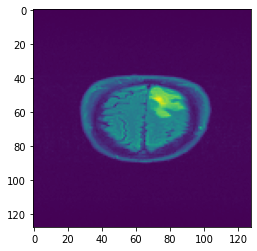

Time taken for epoch:  180.67036390304565
[0, 1]
Dev_Loss 0.0031548094699142986 Epoch 109
L1_Loss 0.2848371658440705 L2_Loss 0.2895139368291005 SSIM_Loss 0.2810979441199832 Epoch 109
Epoch = [ 109/ 250] TrainLoss = 0.0007503  DevLoss = 0.003155 TrainTime = 130.9325s DevTime = 43.0658s


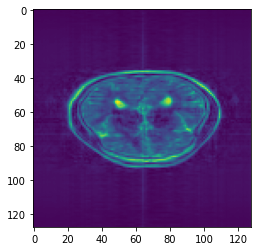

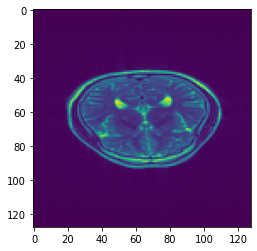

Time taken for epoch:  178.07477688789368
[0, 1]
Dev_Loss 0.0031051804421794926 Epoch 110
L1_Loss 0.2884047100790047 L2_Loss 0.29381647063318206 SSIM_Loss 0.3004916600191173 Epoch 110
Epoch = [ 110/ 250] TrainLoss = 0.0006693  DevLoss = 0.003105 TrainTime = 133.0607s DevTime = 43.4465s


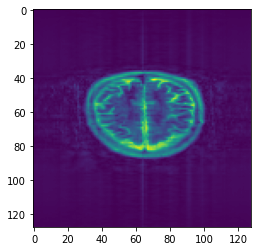

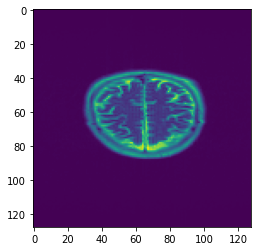

Time taken for epoch:  180.57360529899597
[0, 1]
Dev_Loss 0.003026335724212521 Epoch 111
L1_Loss 0.2871218293969583 L2_Loss 0.2993305097862132 SSIM_Loss 0.281409010987955 Epoch 111
Epoch = [ 111/ 250] TrainLoss = 0.0006868  DevLoss = 0.003026 TrainTime = 131.3491s DevTime = 44.3894s


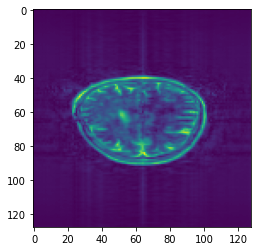

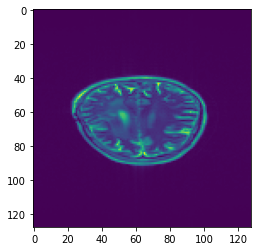

Time taken for epoch:  180.13974618911743
[0, 1]
Dev_Loss 0.0031114203769362124 Epoch 112
L1_Loss 0.27398316813980794 L2_Loss 0.2897270195243429 SSIM_Loss 0.29053635971624714 Epoch 112
Epoch = [ 112/ 250] TrainLoss = 0.0006381  DevLoss = 0.003111 TrainTime = 131.1493s DevTime = 44.1881s


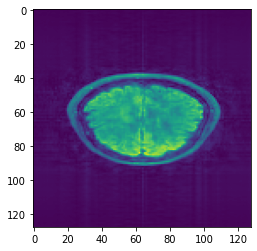

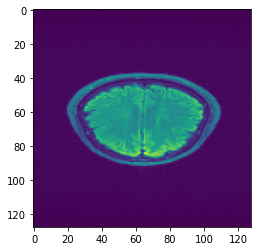

Time taken for epoch:  179.72231125831604
[0, 1]
Dev_Loss 0.0030340238790358405 Epoch 113
L1_Loss 0.30418159139249185 L2_Loss 0.288728370717334 SSIM_Loss 0.2886627021770942 Epoch 113
Epoch = [ 113/ 250] TrainLoss = 0.0006406  DevLoss = 0.003034 TrainTime = 132.7104s DevTime = 43.9115s


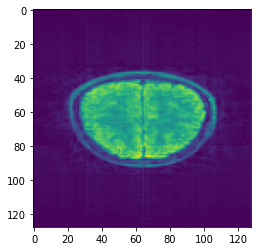

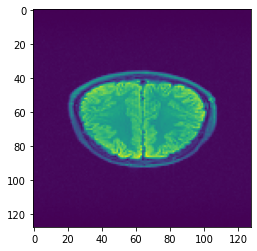

Time taken for epoch:  180.96628785133362
[0, 1]
Dev_Loss 0.003111164409473411 Epoch 114
L1_Loss 0.29260288079430474 L2_Loss 0.24679757205228584 SSIM_Loss 0.2970958239628961 Epoch 114
Epoch = [ 114/ 250] TrainLoss = 0.0006546  DevLoss = 0.003111 TrainTime = 131.0470s DevTime = 44.9135s


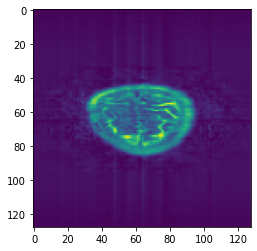

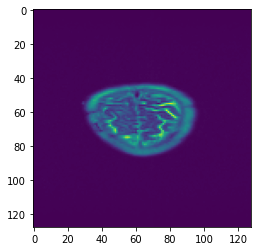

Time taken for epoch:  180.60931754112244
[0, 1]
Dev_Loss 0.003126427672567596 Epoch 115
L1_Loss 0.2902305808003074 L2_Loss 0.2941665237645073 SSIM_Loss 0.28430649251366996 Epoch 115
Epoch = [ 115/ 250] TrainLoss = 0.0007112  DevLoss = 0.003126 TrainTime = 132.7252s DevTime = 43.3598s


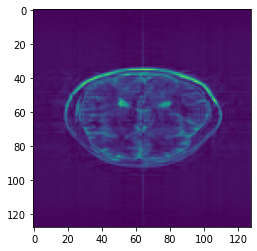

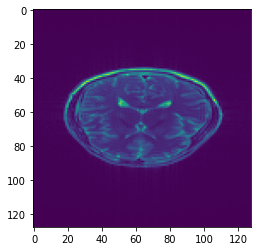

Time taken for epoch:  180.5816514492035
[0, 1]
Dev_Loss 0.003110383529962022 Epoch 116
L1_Loss 0.28765866231630044 L2_Loss 0.2762514813492918 SSIM_Loss 0.29120941365571557 Epoch 116
Epoch = [ 116/ 250] TrainLoss = 0.0007179  DevLoss = 0.00311 TrainTime = 131.4490s DevTime = 43.4521s


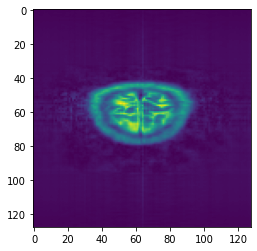

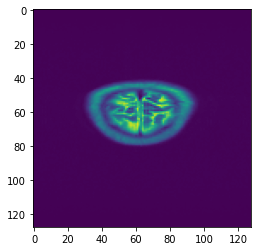

Time taken for epoch:  179.42909932136536
[0, 1]
Dev_Loss 0.003142775470605813 Epoch 117
L1_Loss 0.2860484694221052 L2_Loss 0.29334151399578245 SSIM_Loss 0.2987943295115847 Epoch 117
Epoch = [ 117/ 250] TrainLoss = 0.0007599  DevLoss = 0.003143 TrainTime = 133.2860s DevTime = 43.8614s


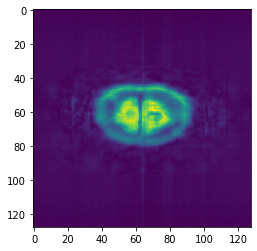

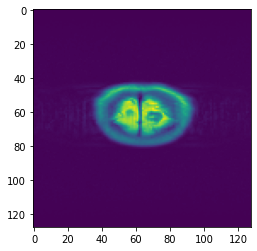

Time taken for epoch:  181.36033153533936
[0, 1]
Dev_Loss 0.003005143098302805 Epoch 118
L1_Loss 0.27460531408740857 L2_Loss 0.28693522307546243 SSIM_Loss 0.2893930057274441 Epoch 118
Epoch = [ 118/ 250] TrainLoss = 0.0006751  DevLoss = 0.003005 TrainTime = 133.7739s DevTime = 42.6706s


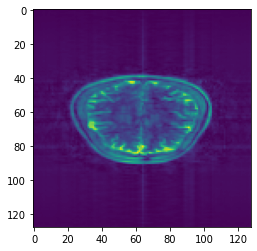

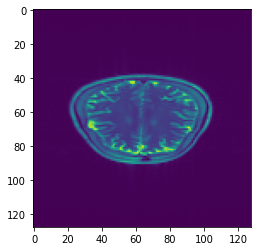

Time taken for epoch:  180.85617232322693
[0, 1]
Dev_Loss 0.0030676234050101008 Epoch 119
L1_Loss 0.2851445582314856 L2_Loss 0.2869984597882783 SSIM_Loss 0.29543024650686805 Epoch 119
Epoch = [ 119/ 250] TrainLoss = 0.0007633  DevLoss = 0.003068 TrainTime = 132.7685s DevTime = 45.0822s


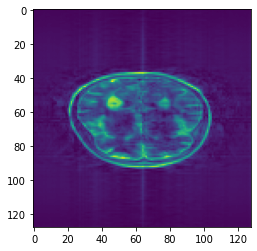

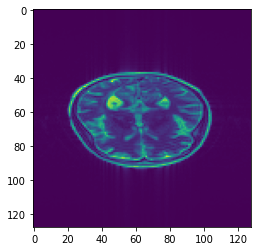

Time taken for epoch:  182.29117512702942
[0, 1]
Dev_Loss 0.003017371685758155 Epoch 120
L1_Loss 0.28670622712840094 L2_Loss 0.2935741082981145 SSIM_Loss 0.2924560593444696 Epoch 120
Epoch = [ 120/ 250] TrainLoss = 0.0006344  DevLoss = 0.003017 TrainTime = 130.6782s DevTime = 43.0890s


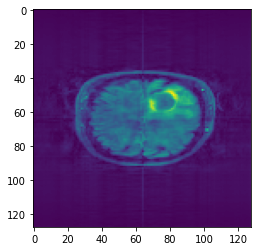

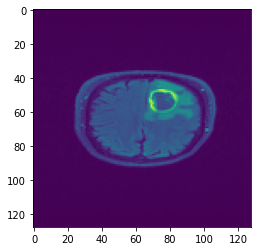

Time taken for epoch:  177.99567890167236
[0, 1]
Dev_Loss 0.003121112576774316 Epoch 121
L1_Loss 0.29428366443402165 L2_Loss 0.2911111975937872 SSIM_Loss 0.29144738049399016 Epoch 121
Epoch = [ 121/ 250] TrainLoss = 0.0008069  DevLoss = 0.003121 TrainTime = 133.2785s DevTime = 43.3975s


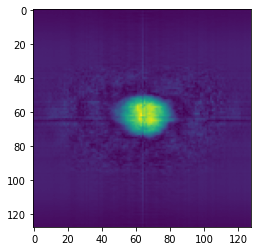

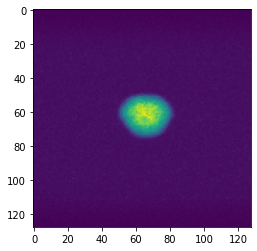

Time taken for epoch:  180.93996739387512
[0, 1]
Dev_Loss 0.003205731912668318 Epoch 122
L1_Loss 0.2879311962980973 L2_Loss 0.29399208566704105 SSIM_Loss 0.28071508912254606 Epoch 122
Epoch = [ 122/ 250] TrainLoss = 0.0009116  DevLoss = 0.003206 TrainTime = 132.1418s DevTime = 45.2018s


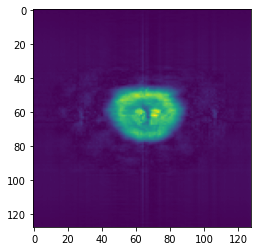

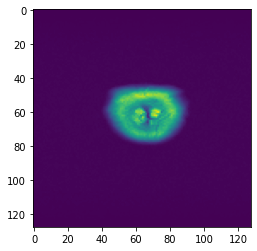

Time taken for epoch:  181.97002053260803
[0, 1]
Dev_Loss 0.003030131150553756 Epoch 123
L1_Loss 0.28321402321345546 L2_Loss 0.3017978106583531 SSIM_Loss 0.29763666395180793 Epoch 123
Epoch = [ 123/ 250] TrainLoss = 0.0007214  DevLoss = 0.00303 TrainTime = 133.5830s DevTime = 44.1862s


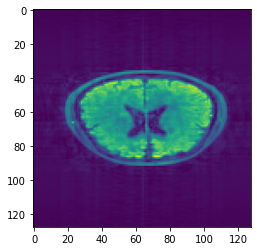

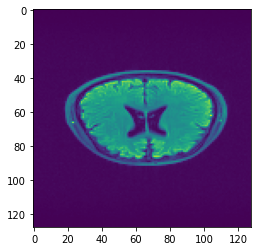

Time taken for epoch:  181.742981672287
[0, 1]
Dev_Loss 0.00301666166172223 Epoch 124
L1_Loss 0.2801427301110124 L2_Loss 0.2923453966814496 SSIM_Loss 0.2828328513614024 Epoch 124
Epoch = [ 124/ 250] TrainLoss = 0.0007502  DevLoss = 0.003017 TrainTime = 131.5260s DevTime = 43.8236s


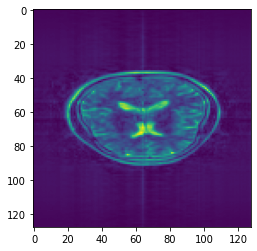

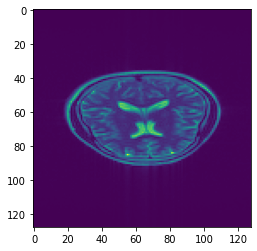

Time taken for epoch:  179.4536292552948
[0, 1]
Dev_Loss 0.003065674663729599 Epoch 125
L1_Loss 0.2882099946016259 L2_Loss 0.2931935885819314 SSIM_Loss 0.3004837964558102 Epoch 125
Epoch = [ 125/ 250] TrainLoss = 0.0007039  DevLoss = 0.003066 TrainTime = 131.0738s DevTime = 44.3000s


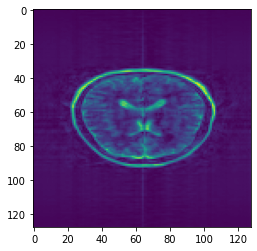

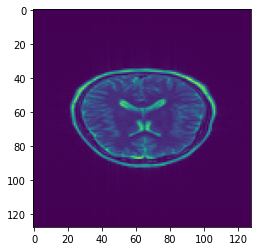

Time taken for epoch:  179.3009476661682
[0, 1]
Dev_Loss 0.0030669136585429893 Epoch 126
L1_Loss 0.28711864117226177 L2_Loss 0.27413411576695623 SSIM_Loss 0.2903959746894719 Epoch 126
Epoch = [ 126/ 250] TrainLoss = 0.0006134  DevLoss = 0.003067 TrainTime = 130.8214s DevTime = 44.8822s


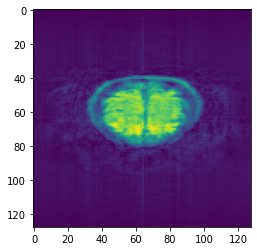

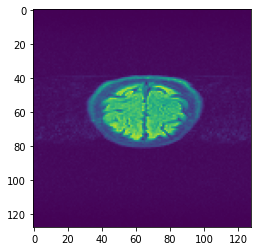

Time taken for epoch:  180.36349272727966
[0, 1]
Dev_Loss 0.0030773800134392586 Epoch 127
L1_Loss 0.29542680634301105 L2_Loss 0.28519074918039755 SSIM_Loss 0.28411008723604 Epoch 127
Epoch = [ 127/ 250] TrainLoss = 0.0007047  DevLoss = 0.003077 TrainTime = 134.4012s DevTime = 46.6302s


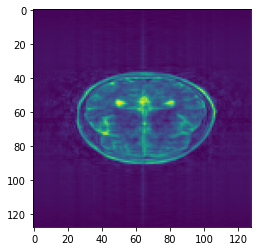

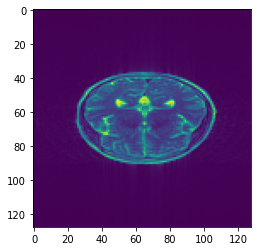

Time taken for epoch:  185.19658017158508
[0, 1]
Dev_Loss 0.0030648193787935684 Epoch 128
L1_Loss 0.2768465789626155 L2_Loss 0.2762599408173306 SSIM_Loss 0.294913901892854 Epoch 128
Epoch = [ 128/ 250] TrainLoss = 0.0006957  DevLoss = 0.003065 TrainTime = 134.6587s DevTime = 47.0621s


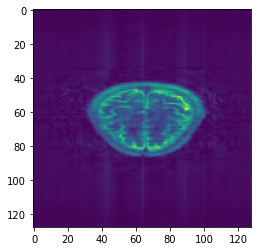

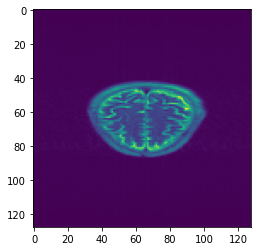

Time taken for epoch:  185.9696877002716
[0, 1]
Dev_Loss 0.003056712206948351 Epoch 129
L1_Loss 0.2921394457618947 L2_Loss 0.28232903947417354 SSIM_Loss 0.2939292843637326 Epoch 129
Epoch = [ 129/ 250] TrainLoss = 0.0006677  DevLoss = 0.003057 TrainTime = 134.1736s DevTime = 46.2343s


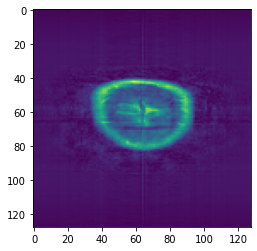

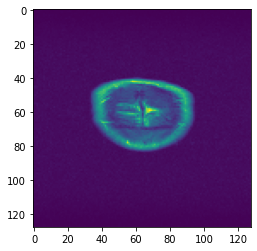

Time taken for epoch:  185.02395105361938
[0, 1]
Dev_Loss 0.0030958314906114922 Epoch 130
L1_Loss 0.2819167604954192 L2_Loss 0.28392979048082273 SSIM_Loss 0.2836784055740885 Epoch 130
Epoch = [ 130/ 250] TrainLoss = 0.0008402  DevLoss = 0.003096 TrainTime = 133.7989s DevTime = 45.6588s


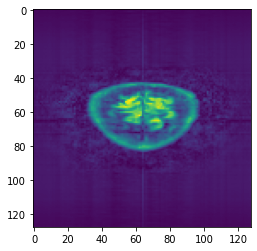

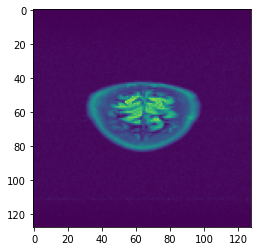

Time taken for epoch:  183.83250379562378
[0, 1]
Dev_Loss 0.0030546951103560143 Epoch 131
L1_Loss 0.27984981811842646 L2_Loss 0.2948903809935809 SSIM_Loss 0.29376879776378684 Epoch 131
Epoch = [ 131/ 250] TrainLoss = 0.0007868  DevLoss = 0.003055 TrainTime = 133.2743s DevTime = 44.8991s


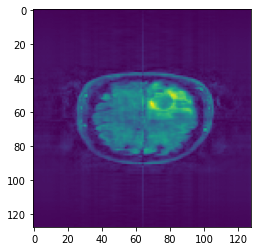

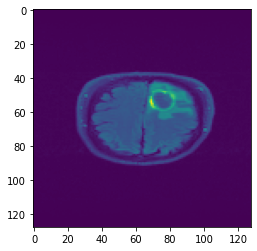

Time taken for epoch:  182.60054969787598
[0, 1]
Dev_Loss 0.002995369864380204 Epoch 132
L1_Loss 0.2878874952746389 L2_Loss 0.2855993831437893 SSIM_Loss 0.2870269156692475 Epoch 132
Epoch = [ 132/ 250] TrainLoss = 0.0007547  DevLoss = 0.002995 TrainTime = 132.8480s DevTime = 45.4931s


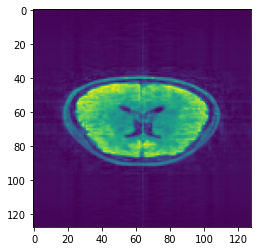

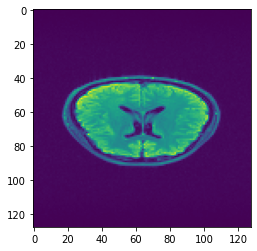

Time taken for epoch:  182.81460404396057
[0, 1]
Dev_Loss 0.0030434201092904116 Epoch 133
L1_Loss 0.2756249705703367 L2_Loss 0.28689440543948924 SSIM_Loss 0.29820149574365795 Epoch 133
Epoch = [ 133/ 250] TrainLoss = 0.000663  DevLoss = 0.003043 TrainTime = 134.0921s DevTime = 46.2554s


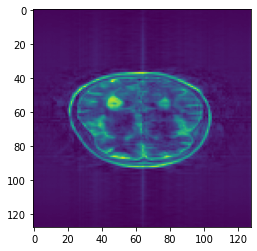

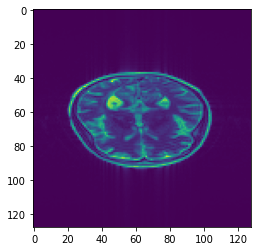

Time taken for epoch:  184.72556018829346
[0, 1]
Dev_Loss 0.0029953489133490202 Epoch 134
L1_Loss 0.30507334393881674 L2_Loss 0.2819320297106876 SSIM_Loss 0.2936359161286904 Epoch 134
Epoch = [ 134/ 250] TrainLoss = 0.000675  DevLoss = 0.002995 TrainTime = 133.2280s DevTime = 45.7237s


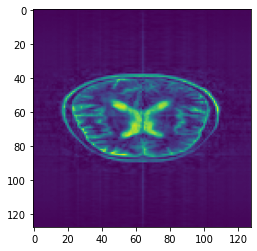

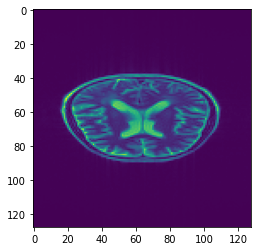

Time taken for epoch:  183.2445182800293
[0, 1]
Dev_Loss 0.003140186975999593 Epoch 135
L1_Loss 0.29317016328589435 L2_Loss 0.2806108397880063 SSIM_Loss 0.28080917256641824 Epoch 135
Epoch = [ 135/ 250] TrainLoss = 0.0007459  DevLoss = 0.00314 TrainTime = 132.9914s DevTime = 43.9972s


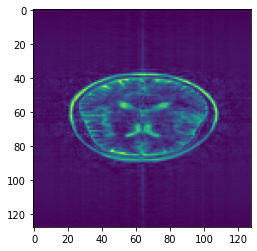

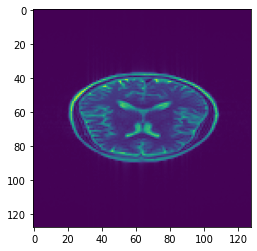

Time taken for epoch:  181.6776466369629
[0, 1]
Dev_Loss 0.003146067465226167 Epoch 136
L1_Loss 0.27933600311264933 L2_Loss 0.29785538807501205 SSIM_Loss 0.28660064046072886 Epoch 136
Epoch = [ 136/ 250] TrainLoss = 0.0006604  DevLoss = 0.003146 TrainTime = 133.8421s DevTime = 46.8844s


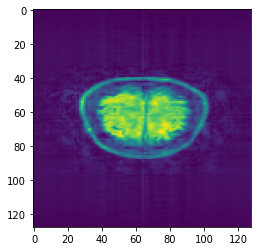

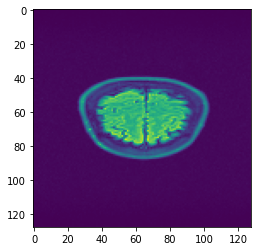

Time taken for epoch:  184.9695646762848
[0, 1]
Dev_Loss 0.0030268633413666085 Epoch 137
L1_Loss 0.2918935932931492 L2_Loss 0.2930458956846434 SSIM_Loss 0.29048222780261373 Epoch 137
Epoch = [ 137/ 250] TrainLoss = 0.000658  DevLoss = 0.003027 TrainTime = 133.3827s DevTime = 46.0469s


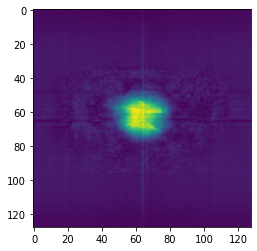

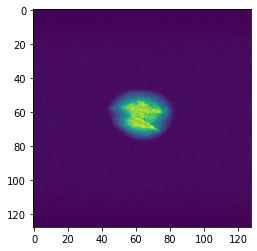

Time taken for epoch:  183.85979771614075
[0, 1]
Dev_Loss 0.003152173095278674 Epoch 138
L1_Loss 0.2810375305451997 L2_Loss 0.289525441330444 SSIM_Loss 0.2968816690552783 Epoch 138
Epoch = [ 138/ 250] TrainLoss = 0.0009869  DevLoss = 0.003152 TrainTime = 134.9678s DevTime = 46.2970s


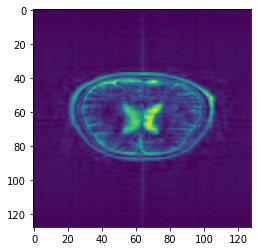

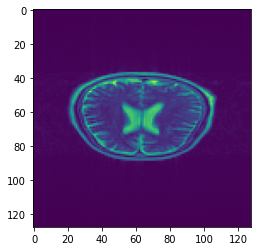

Time taken for epoch:  185.7355501651764
[0, 1]
Dev_Loss 0.00311396200305364 Epoch 139
L1_Loss 0.28429945279461943 L2_Loss 0.29962457971463025 SSIM_Loss 0.2919271966163853 Epoch 139
Epoch = [ 139/ 250] TrainLoss = 0.0008863  DevLoss = 0.003114 TrainTime = 133.7355s DevTime = 46.6489s


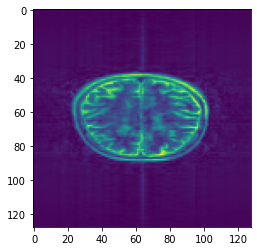

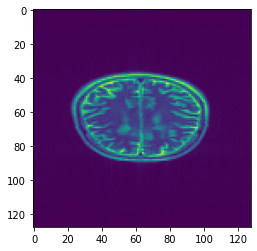

Time taken for epoch:  184.9009554386139
[0, 1]
Dev_Loss 0.0030558788094623493 Epoch 140
L1_Loss 0.28434858256958057 L2_Loss 0.2858405599476197 SSIM_Loss 0.29110231937521297 Epoch 140
Epoch = [ 140/ 250] TrainLoss = 0.0006327  DevLoss = 0.003056 TrainTime = 135.0492s DevTime = 46.8814s


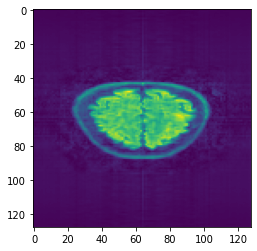

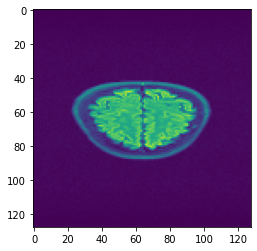

Time taken for epoch:  186.25833344459534
[0, 1]
Dev_Loss 0.003155665145616506 Epoch 141
L1_Loss 0.28067288582058625 L2_Loss 0.29362417768082527 SSIM_Loss 0.2872390022438572 Epoch 141
Epoch = [ 141/ 250] TrainLoss = 0.0006968  DevLoss = 0.003156 TrainTime = 135.0591s DevTime = 45.5516s


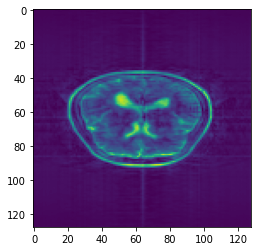

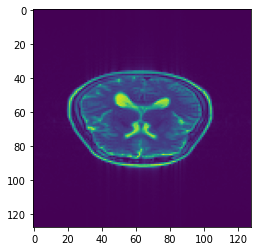

Time taken for epoch:  185.09239888191223
[0, 1]
Dev_Loss 0.0030866636326152474 Epoch 142
L1_Loss 0.28706967990970217 L2_Loss 0.29064406003112836 SSIM_Loss 0.2577689617816556 Epoch 142
Epoch = [ 142/ 250] TrainLoss = 0.0009577  DevLoss = 0.003087 TrainTime = 133.6075s DevTime = 45.8890s


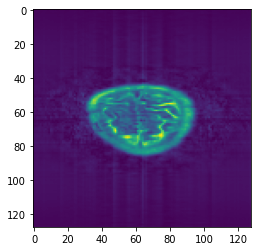

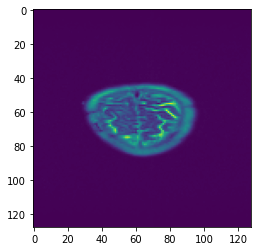

Time taken for epoch:  183.9948389530182
[0, 1]
Dev_Loss 0.0030743896756204657 Epoch 143
L1_Loss 0.28007194971940397 L2_Loss 0.2862258503859716 SSIM_Loss 0.28368362753889337 Epoch 143
Epoch = [ 143/ 250] TrainLoss = 0.0006789  DevLoss = 0.003074 TrainTime = 135.2425s DevTime = 46.8839s


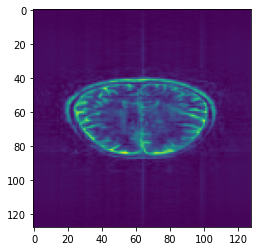

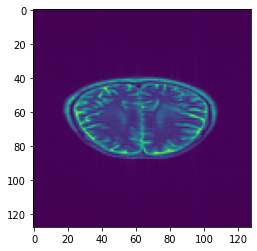

Time taken for epoch:  186.50178146362305
[0, 1]
Dev_Loss 0.003127868789128115 Epoch 144
L1_Loss 0.28525773711055613 L2_Loss 0.28465858442807784 SSIM_Loss 0.28416726659458885 Epoch 144
Epoch = [ 144/ 250] TrainLoss = 0.0008398  DevLoss = 0.003128 TrainTime = 134.7048s DevTime = 47.0523s


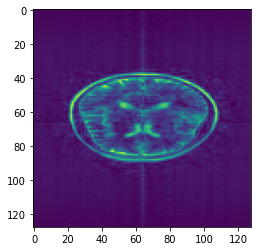

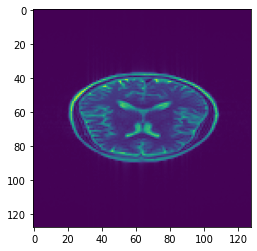

Time taken for epoch:  186.19501185417175
[0, 1]
Dev_Loss 0.0030090417084060383 Epoch 145
L1_Loss 0.2851363862636038 L2_Loss 0.2890739270124773 SSIM_Loss 0.29699846325065093 Epoch 145
Epoch = [ 145/ 250] TrainLoss = 0.0007755  DevLoss = 0.003009 TrainTime = 133.6949s DevTime = 46.3515s


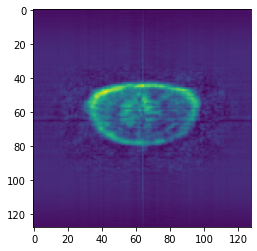

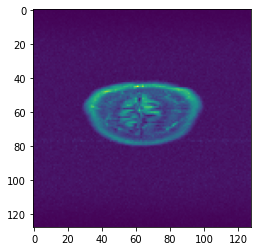

Time taken for epoch:  184.3587236404419
[0, 1]
Dev_Loss 0.0029475125292143453 Epoch 146
L1_Loss 0.29989987609918756 L2_Loss 0.28942838905913065 SSIM_Loss 0.28901014283093973 Epoch 146
Epoch = [ 146/ 250] TrainLoss = 0.0006284  DevLoss = 0.002948 TrainTime = 134.4436s DevTime = 44.3109s


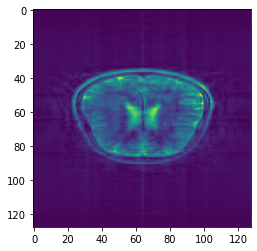

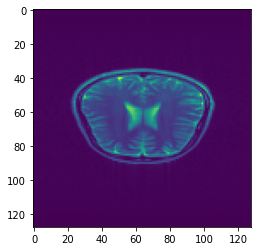

Time taken for epoch:  182.3793876171112
[0, 1]
Dev_Loss 0.003065808764576552 Epoch 147
L1_Loss 0.2937529849315514 L2_Loss 0.29466826659817025 SSIM_Loss 0.2706841668639474 Epoch 147
Epoch = [ 147/ 250] TrainLoss = 0.0006607  DevLoss = 0.003066 TrainTime = 131.1355s DevTime = 45.2682s


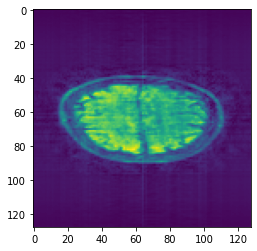

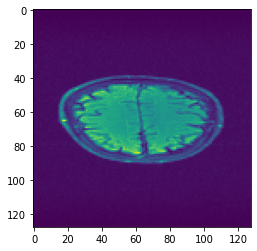

Time taken for epoch:  180.0071563720703
[0, 1]
Dev_Loss 0.0030941234658772195 Epoch 148
L1_Loss 0.28125642386505667 L2_Loss 0.29868825403691845 SSIM_Loss 0.29209896161481286 Epoch 148
Epoch = [ 148/ 250] TrainLoss = 0.000649  DevLoss = 0.003094 TrainTime = 132.8457s DevTime = 43.1213s


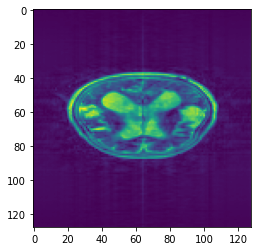

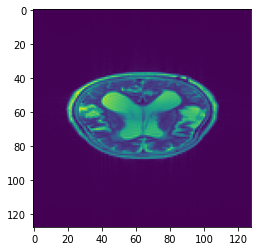

Time taken for epoch:  179.57293033599854
[0, 1]
Dev_Loss 0.0031686367674586967 Epoch 149
L1_Loss 0.2693003289677394 L2_Loss 0.27982437690532747 SSIM_Loss 0.2791499610369045 Epoch 149
Epoch = [ 149/ 250] TrainLoss = 0.0006756  DevLoss = 0.003169 TrainTime = 132.6017s DevTime = 44.7024s


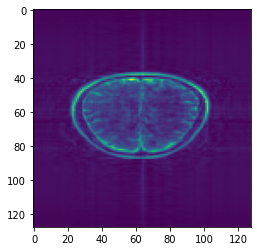

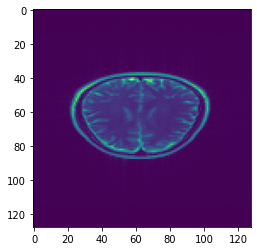

Time taken for epoch:  180.92677998542786
[0, 1]
Dev_Loss 0.0030953680130061624 Epoch 150
L1_Loss 0.2887796415941835 L2_Loss 0.2948115208859924 SSIM_Loss 0.2938196071739678 Epoch 150
Epoch = [ 150/ 250] TrainLoss = 0.0007088  DevLoss = 0.003095 TrainTime = 134.2775s DevTime = 44.3101s


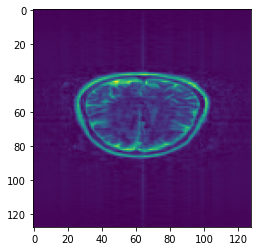

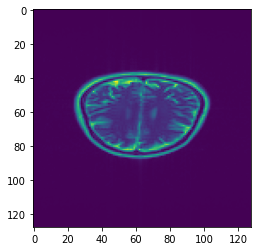

Time taken for epoch:  182.22685718536377
[0, 1]
Dev_Loss 0.003047799617839312 Epoch 151
L1_Loss 0.2966191413272101 L2_Loss 0.30182511956018065 SSIM_Loss 0.2933018713948278 Epoch 151
Epoch = [ 151/ 250] TrainLoss = 0.000665  DevLoss = 0.003048 TrainTime = 132.5201s DevTime = 45.0679s


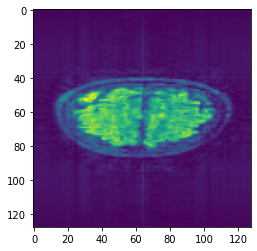

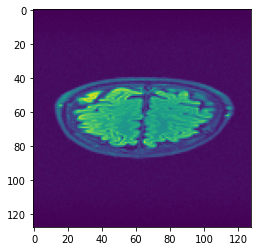

Time taken for epoch:  181.08911275863647
[0, 1]
Dev_Loss 0.003060117930215095 Epoch 152
L1_Loss 0.2869607485668544 L2_Loss 0.28906320668746555 SSIM_Loss 0.28967598966070357 Epoch 152
Epoch = [ 152/ 250] TrainLoss = 0.0006904  DevLoss = 0.00306 TrainTime = 133.5039s DevTime = 44.8469s


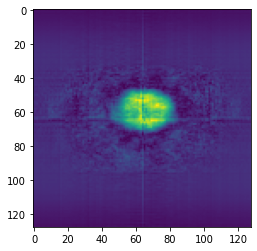

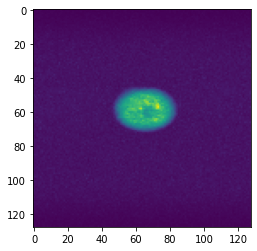

Time taken for epoch:  181.69858598709106
[0, 1]
Dev_Loss 0.003054594080065221 Epoch 153
L1_Loss 0.29842095108568856 L2_Loss 0.28719281354375076 SSIM_Loss 0.2956065719189082 Epoch 153
Epoch = [ 153/ 250] TrainLoss = 0.0006838  DevLoss = 0.003055 TrainTime = 133.9999s DevTime = 46.5407s


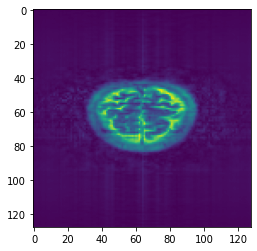

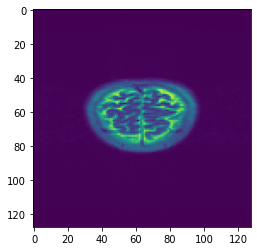

Time taken for epoch:  184.14050817489624
[0, 1]
Dev_Loss 0.0031172861264153894 Epoch 154
L1_Loss 0.2880440453569571 L2_Loss 0.28786086982555775 SSIM_Loss 0.2878096954430613 Epoch 154
Epoch = [ 154/ 250] TrainLoss = 0.00068  DevLoss = 0.003117 TrainTime = 133.2579s DevTime = 45.7986s


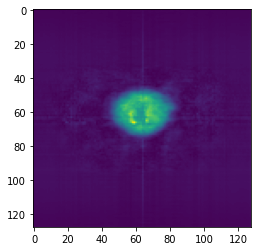

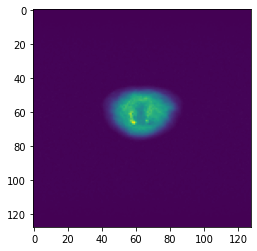

Time taken for epoch:  182.77668380737305
[0, 1]
Dev_Loss 0.003067667735605707 Epoch 155
L1_Loss 0.28935819156226733 L2_Loss 0.2733767786895414 SSIM_Loss 0.2791475518138598 Epoch 155
Epoch = [ 155/ 250] TrainLoss = 0.0006629  DevLoss = 0.003068 TrainTime = 133.3246s DevTime = 44.2986s


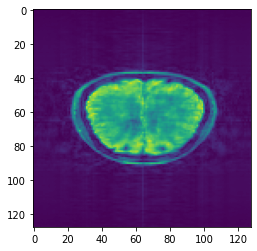

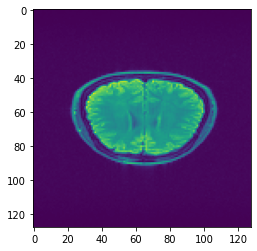

Time taken for epoch:  181.24843764305115
[0, 1]
Dev_Loss 0.003018035990003891 Epoch 156
L1_Loss 0.28967460798463796 L2_Loss 0.29309759601455193 SSIM_Loss 0.29463846053283516 Epoch 156
Epoch = [ 156/ 250] TrainLoss = 0.0009806  DevLoss = 0.003018 TrainTime = 134.2522s DevTime = 44.5459s


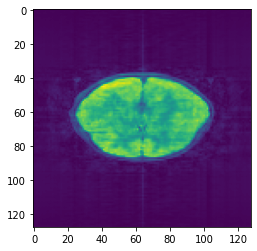

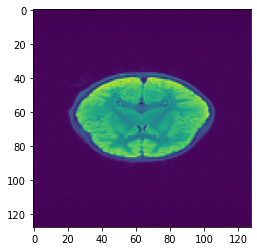

Time taken for epoch:  182.28864288330078
[0, 1]
Dev_Loss 0.0030866194397592968 Epoch 157
L1_Loss 0.2840261658517363 L2_Loss 0.2826963071625809 SSIM_Loss 0.30113796858195313 Epoch 157
Epoch = [ 157/ 250] TrainLoss = 0.0006722  DevLoss = 0.003087 TrainTime = 132.4739s DevTime = 44.4714s


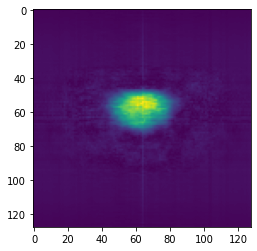

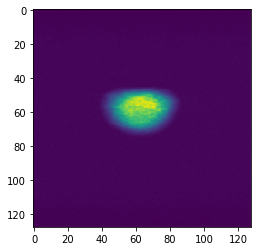

Time taken for epoch:  180.65901279449463
[0, 1]
Dev_Loss 0.003050898586853348 Epoch 158
L1_Loss 0.29711904552024576 L2_Loss 0.28047561198241194 SSIM_Loss 0.2853677700481138 Epoch 158
Epoch = [ 158/ 250] TrainLoss = 0.0008634  DevLoss = 0.003051 TrainTime = 133.6479s DevTime = 46.3712s


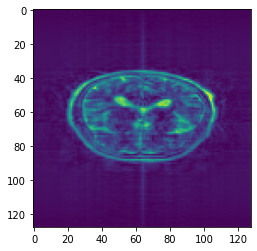

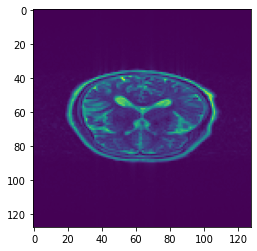

Time taken for epoch:  183.49330949783325
[0, 1]
Dev_Loss 0.003072893465715711 Epoch 159
L1_Loss 0.29277679142783025 L2_Loss 0.2806065828070591 SSIM_Loss 0.2933958587004472 Epoch 159
Epoch = [ 159/ 250] TrainLoss = 0.0006823  DevLoss = 0.003073 TrainTime = 134.2777s DevTime = 45.9761s


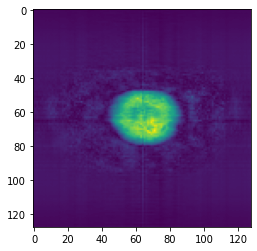

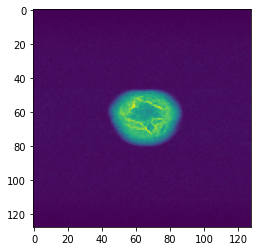

Time taken for epoch:  183.68040800094604
[0, 1]
Dev_Loss 0.003182928164830118 Epoch 160
L1_Loss 0.29104587965341194 L2_Loss 0.2942858096971218 SSIM_Loss 0.2840750569681048 Epoch 160
Epoch = [ 160/ 250] TrainLoss = 0.0006307  DevLoss = 0.003183 TrainTime = 133.4515s DevTime = 46.7088s


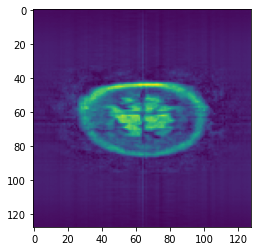

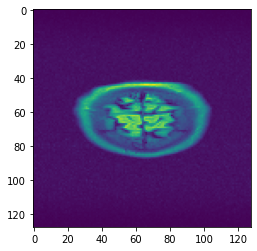

Time taken for epoch:  184.24172019958496
[0, 1]
Dev_Loss 0.0029759790418445505 Epoch 161
L1_Loss 0.30071307985763274 L2_Loss 0.28566312923551046 SSIM_Loss 0.30333729105096924 Epoch 161
Epoch = [ 161/ 250] TrainLoss = 0.0007153  DevLoss = 0.002976 TrainTime = 133.3907s DevTime = 45.9014s


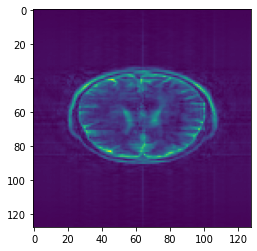

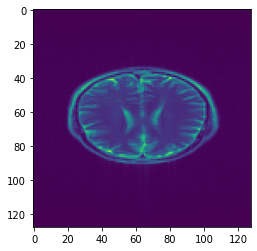

Time taken for epoch:  183.15630745887756
[0, 1]
Dev_Loss 0.0031008651795291233 Epoch 162
L1_Loss 0.27502346405066574 L2_Loss 0.2868838098174461 SSIM_Loss 0.28379696947135385 Epoch 162
Epoch = [ 162/ 250] TrainLoss = 0.0007267  DevLoss = 0.003101 TrainTime = 132.1853s DevTime = 44.2062s


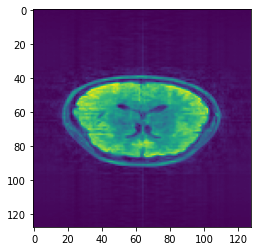

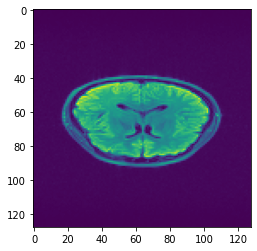

Time taken for epoch:  180.2651867866516
[0, 1]
Dev_Loss 0.003053270753864542 Epoch 163
L1_Loss 0.28941200900676567 L2_Loss 0.2773045886435571 SSIM_Loss 0.30530439739941734 Epoch 163
Epoch = [ 163/ 250] TrainLoss = 0.000685  DevLoss = 0.003053 TrainTime = 133.5260s DevTime = 45.1794s


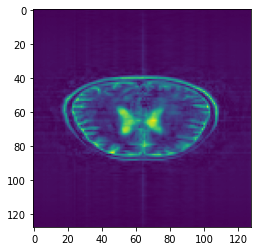

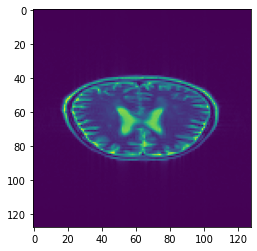

Time taken for epoch:  182.70130443572998
[0, 1]
Dev_Loss 0.0030350377787052908 Epoch 164
L1_Loss 0.27575907547823403 L2_Loss 0.2834632746712554 SSIM_Loss 0.28832593356915254 Epoch 164
Epoch = [ 164/ 250] TrainLoss = 0.0006201  DevLoss = 0.003035 TrainTime = 132.8297s DevTime = 46.2518s


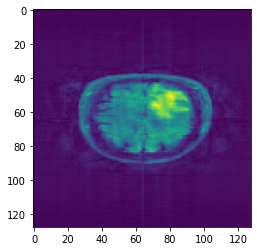

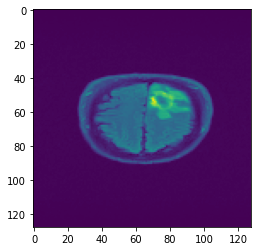

Time taken for epoch:  183.44459676742554
[0, 1]
Dev_Loss 0.0030456162957279947 Epoch 165
L1_Loss 0.30424693485320814 L2_Loss 0.3020373142792239 SSIM_Loss 0.2742132103444015 Epoch 165
Epoch = [ 165/ 250] TrainLoss = 0.0007928  DevLoss = 0.003046 TrainTime = 133.7000s DevTime = 44.9162s


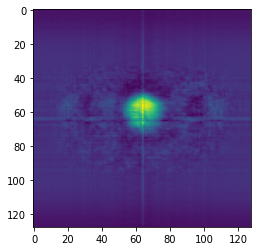

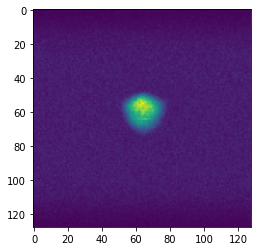

Time taken for epoch:  182.91231632232666
[0, 1]
Dev_Loss 0.0030607238381395903 Epoch 166
L1_Loss 0.287364069253511 L2_Loss 0.28937208331160297 SSIM_Loss 0.29217744555837116 Epoch 166
Epoch = [ 166/ 250] TrainLoss = 0.0006763  DevLoss = 0.003061 TrainTime = 132.5424s DevTime = 44.4092s


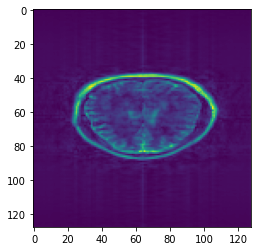

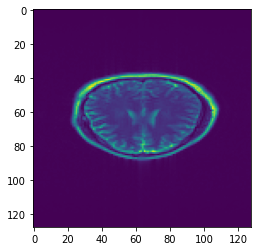

Time taken for epoch:  181.28610849380493
[0, 1]
Dev_Loss 0.0030729278530659673 Epoch 167
L1_Loss 0.29864823660219275 L2_Loss 0.2896408421931591 SSIM_Loss 0.288883442358201 Epoch 167
Epoch = [ 167/ 250] TrainLoss = 0.0007184  DevLoss = 0.003073 TrainTime = 132.5634s DevTime = 43.9022s


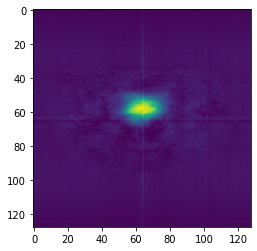

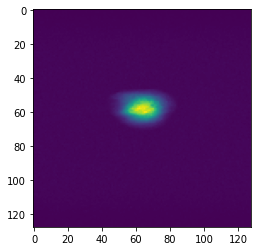

Time taken for epoch:  180.38745427131653
[0, 1]
Dev_Loss 0.0030359693505313708 Epoch 168
L1_Loss 0.28722294282470034 L2_Loss 0.2915542079972427 SSIM_Loss 0.2698571962003999 Epoch 168
Epoch = [ 168/ 250] TrainLoss = 0.0006859  DevLoss = 0.003036 TrainTime = 132.7752s DevTime = 44.2645s


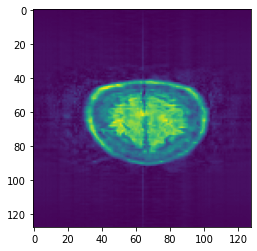

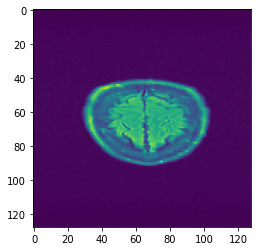

Time taken for epoch:  181.3040487766266
[0, 1]
Dev_Loss 0.0031138034675882295 Epoch 169
L1_Loss 0.294453623378928 L2_Loss 0.2879201312453665 SSIM_Loss 0.28879325701534236 Epoch 169
Epoch = [ 169/ 250] TrainLoss = 0.0006322  DevLoss = 0.003114 TrainTime = 132.3302s DevTime = 44.2171s


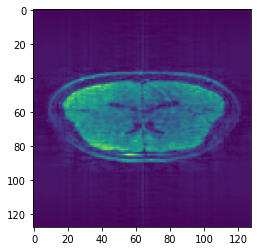

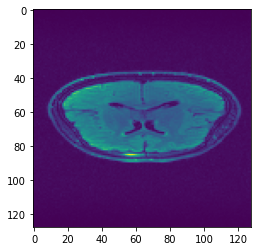

Time taken for epoch:  180.83050084114075
[0, 1]
Dev_Loss 0.003068906681604656 Epoch 170
L1_Loss 0.2979327705821879 L2_Loss 0.2860288696513797 SSIM_Loss 0.2841650613786685 Epoch 170
Epoch = [ 170/ 250] TrainLoss = 0.0008235  DevLoss = 0.003069 TrainTime = 131.9814s DevTime = 42.8216s


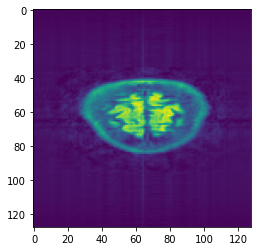

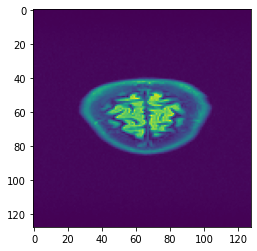

Time taken for epoch:  179.1995506286621
[0, 1]
Dev_Loss 0.0030346047864738294 Epoch 171
L1_Loss 0.28371847706591397 L2_Loss 0.3025297468026789 SSIM_Loss 0.2892231750542237 Epoch 171
Epoch = [ 171/ 250] TrainLoss = 0.0006261  DevLoss = 0.003035 TrainTime = 132.5098s DevTime = 44.3849s


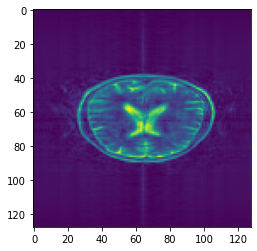

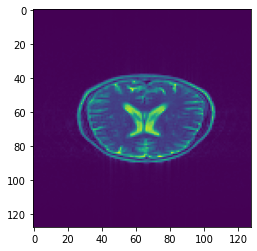

Time taken for epoch:  181.5580189228058
[0, 1]
Dev_Loss 0.0030977152741049814 Epoch 172
L1_Loss 0.29828002294282113 L2_Loss 0.2826464416904573 SSIM_Loss 0.28366742368723924 Epoch 172
Epoch = [ 172/ 250] TrainLoss = 0.0007096  DevLoss = 0.003098 TrainTime = 133.1782s DevTime = 44.1865s


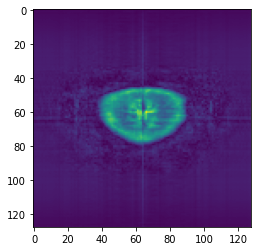

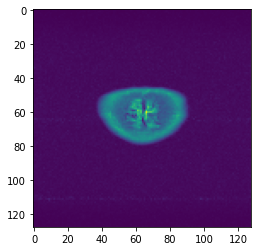

Time taken for epoch:  181.54578280448914
[0, 1]
Dev_Loss 0.0030163432439415934 Epoch 173
L1_Loss 0.2881528610587226 L2_Loss 0.2951261332872638 SSIM_Loss 0.2559538744314193 Epoch 173
Epoch = [ 173/ 250] TrainLoss = 0.0006427  DevLoss = 0.003016 TrainTime = 133.4952s DevTime = 43.5356s


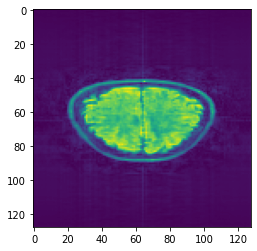

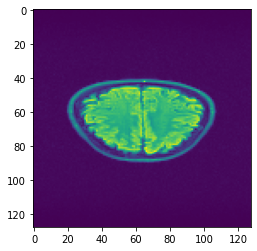

Time taken for epoch:  181.34279203414917
[0, 1]
Dev_Loss 0.0030066484399143057 Epoch 174
L1_Loss 0.28432792460675765 L2_Loss 0.2876452528506945 SSIM_Loss 0.29215293736617004 Epoch 174
Epoch = [ 174/ 250] TrainLoss = 0.0007099  DevLoss = 0.003007 TrainTime = 132.9895s DevTime = 45.0212s


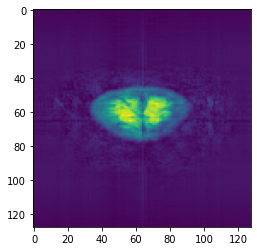

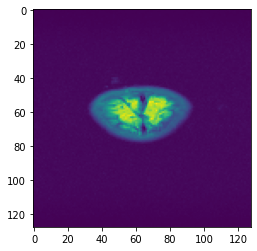

Time taken for epoch:  182.49753713607788
[0, 1]
Dev_Loss 0.003055899489159959 Epoch 175
L1_Loss 0.28331732317459707 L2_Loss 0.2887107703613035 SSIM_Loss 0.2699043172541911 Epoch 175
Epoch = [ 175/ 250] TrainLoss = 0.0006317  DevLoss = 0.003056 TrainTime = 133.9616s DevTime = 43.6440s


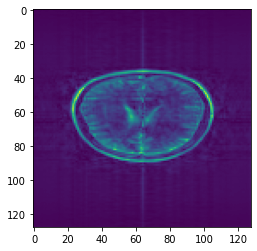

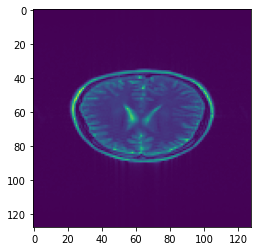

Time taken for epoch:  181.80320954322815
[0, 1]
Dev_Loss 0.0030732480971319446 Epoch 176
L1_Loss 0.286510043715705 L2_Loss 0.28478385741446016 SSIM_Loss 0.286218153036626 Epoch 176
Epoch = [ 176/ 250] TrainLoss = 0.0006859  DevLoss = 0.003073 TrainTime = 131.1574s DevTime = 44.5818s


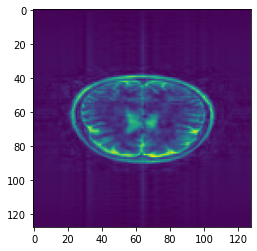

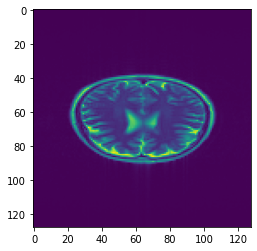

Time taken for epoch:  180.0267777442932
[0, 1]
Dev_Loss 0.003061003210491628 Epoch 177
L1_Loss 0.2984332020088564 L2_Loss 0.2925711750489833 SSIM_Loss 0.2912059880056687 Epoch 177
Epoch = [ 177/ 250] TrainLoss = 0.0006477  DevLoss = 0.003061 TrainTime = 132.1569s DevTime = 43.6687s


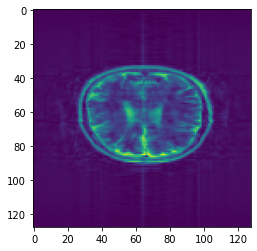

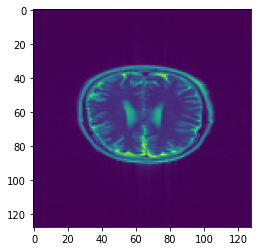

Time taken for epoch:  180.20385360717773
[0, 1]
Dev_Loss 0.0030783686843675637 Epoch 178
L1_Loss 0.29411690272220176 L2_Loss 0.24431066918522004 SSIM_Loss 0.28534472024389035 Epoch 178
Epoch = [ 178/ 250] TrainLoss = 0.0006899  DevLoss = 0.003078 TrainTime = 132.7839s DevTime = 43.2613s


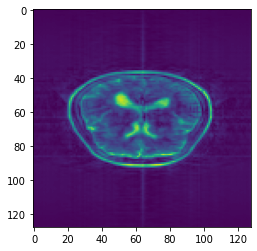

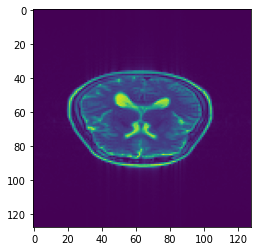

Time taken for epoch:  180.17952489852905
[0, 1]
Dev_Loss 0.0031272212482360787 Epoch 179
L1_Loss 0.2894486551892326 L2_Loss 0.29445886594254467 SSIM_Loss 0.28681115947655283 Epoch 179
Epoch = [ 179/ 250] TrainLoss = 0.0006194  DevLoss = 0.003127 TrainTime = 134.0449s DevTime = 44.5387s


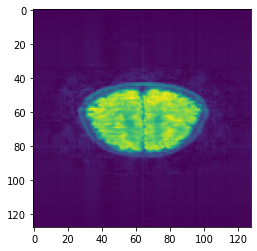

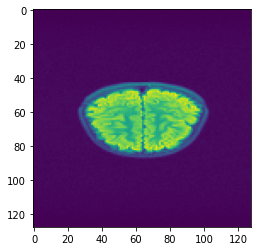

Time taken for epoch:  182.99355959892273
[0, 1]
Dev_Loss 0.003083987474138084 Epoch 180
L1_Loss 0.28021700208216704 L2_Loss 0.2863822858788934 SSIM_Loss 0.28740504089366004 Epoch 180
Epoch = [ 180/ 250] TrainLoss = 0.0006237  DevLoss = 0.003084 TrainTime = 132.5772s DevTime = 42.8348s


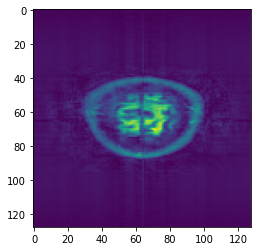

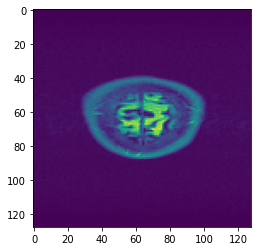

Time taken for epoch:  179.65526604652405
[0, 1]
Dev_Loss 0.003018317368948379 Epoch 181
L1_Loss 0.289899532472688 L2_Loss 0.29251635670311826 SSIM_Loss 0.28919095386776406 Epoch 181
Epoch = [ 181/ 250] TrainLoss = 0.0006265  DevLoss = 0.003018 TrainTime = 133.0422s DevTime = 43.4337s


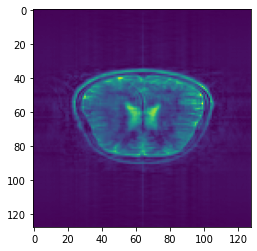

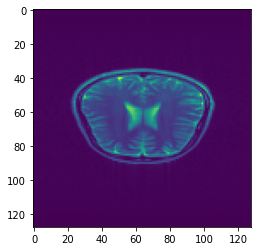

Time taken for epoch:  180.70213723182678
[0, 1]
Dev_Loss 0.003027929733085582 Epoch 182
L1_Loss 0.2860131184559886 L2_Loss 0.2931261070071824 SSIM_Loss 0.28803011926769595 Epoch 182
Epoch = [ 182/ 250] TrainLoss = 0.0006407  DevLoss = 0.003028 TrainTime = 132.1135s DevTime = 43.4760s


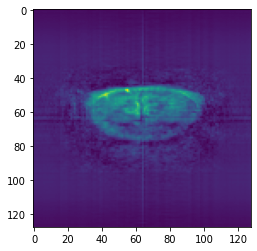

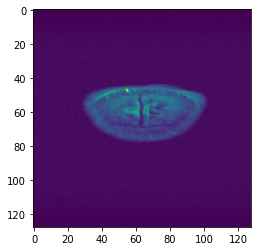

Time taken for epoch:  179.49463176727295
[0, 1]
Dev_Loss 0.0031365807994187876 Epoch 183
L1_Loss 0.29794508602991615 L2_Loss 0.29312352088015986 SSIM_Loss 0.2885824611351662 Epoch 183
Epoch = [ 183/ 250] TrainLoss = 0.0007824  DevLoss = 0.003137 TrainTime = 131.6364s DevTime = 43.8428s


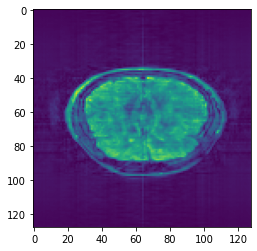

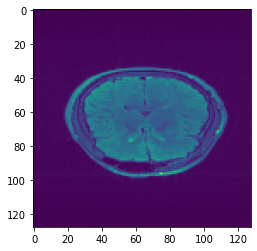

Time taken for epoch:  179.79251718521118
[0, 1]
Dev_Loss 0.003227774477040835 Epoch 184
L1_Loss 0.2933887594857432 L2_Loss 0.28539896192657965 SSIM_Loss 0.28218747394284666 Epoch 184
Epoch = [ 184/ 250] TrainLoss = 0.0006897  DevLoss = 0.003228 TrainTime = 133.3612s DevTime = 44.4688s


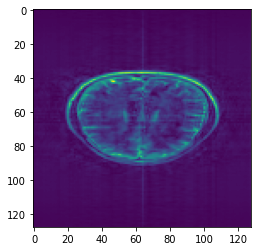

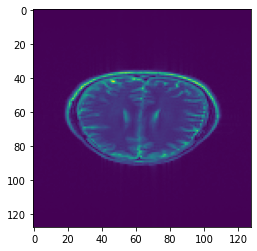

Time taken for epoch:  182.03405809402466
[0, 1]
Dev_Loss 0.002937415703966635 Epoch 185
L1_Loss 0.29231347655231993 L2_Loss 0.2762420300431488 SSIM_Loss 0.2837309765164596 Epoch 185
Epoch = [ 185/ 250] TrainLoss = 0.0006337  DevLoss = 0.002937 TrainTime = 131.9786s DevTime = 43.0874s


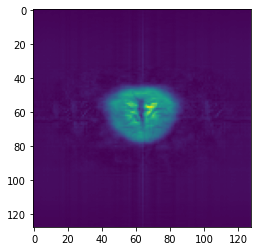

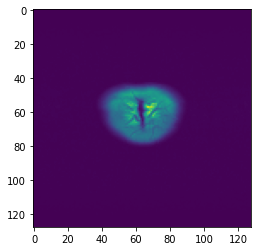

Time taken for epoch:  179.43447375297546
[0, 1]
Dev_Loss 0.0031205345858244618 Epoch 186
L1_Loss 0.2933051097696648 L2_Loss 0.2797843052685206 SSIM_Loss 0.2893078400018652 Epoch 186
Epoch = [ 186/ 250] TrainLoss = 0.0007034  DevLoss = 0.003121 TrainTime = 123.0187s DevTime = 31.7912s


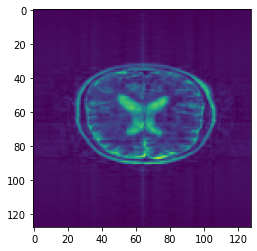

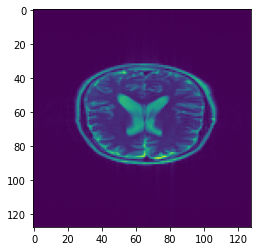

Time taken for epoch:  158.0825388431549
[0, 1]
Dev_Loss 0.003155673659366701 Epoch 187
L1_Loss 0.2805326245158131 L2_Loss 0.29085770668360594 SSIM_Loss 0.29732768448696095 Epoch 187
Epoch = [ 187/ 250] TrainLoss = 0.0006312  DevLoss = 0.003156 TrainTime = 114.4088s DevTime = 31.8462s


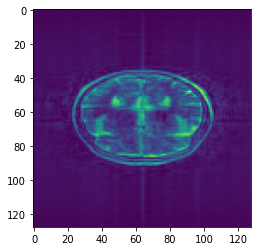

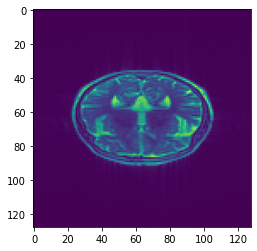

Time taken for epoch:  149.47042965888977
[0, 1]
Dev_Loss 0.0030181580156165423 Epoch 188
L1_Loss 0.2790582601113268 L2_Loss 0.28670230635284205 SSIM_Loss 0.27451742009335395 Epoch 188
Epoch = [ 188/ 250] TrainLoss = 0.000596  DevLoss = 0.003018 TrainTime = 114.3034s DevTime = 31.8514s


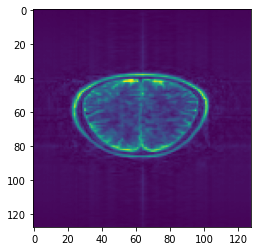

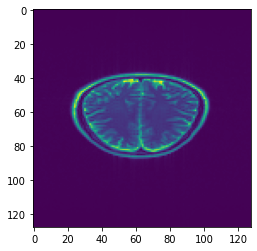

Time taken for epoch:  149.35314393043518
[0, 1]
Dev_Loss 0.003058661704806266 Epoch 189
L1_Loss 0.28745351575871175 L2_Loss 0.281452349177243 SSIM_Loss 0.2865395179128409 Epoch 189
Epoch = [ 189/ 250] TrainLoss = 0.0008237  DevLoss = 0.003059 TrainTime = 114.5536s DevTime = 31.8804s


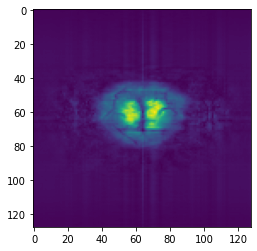

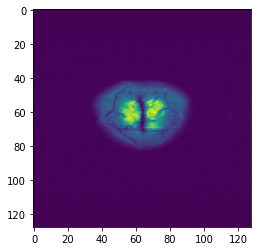

Time taken for epoch:  149.60014581680298
[0, 1]
Dev_Loss 0.003130236525664561 Epoch 190
L1_Loss 0.27055458343046257 L2_Loss 0.2810401087428963 SSIM_Loss 0.2840242493125071 Epoch 190
Epoch = [ 190/ 250] TrainLoss = 0.0006511  DevLoss = 0.00313 TrainTime = 114.3929s DevTime = 32.2080s


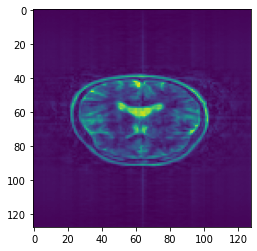

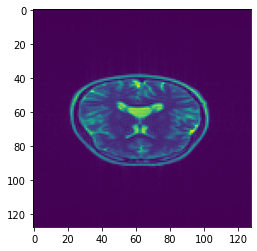

Time taken for epoch:  149.75781178474426
[0, 1]
Dev_Loss 0.002981729860569965 Epoch 191
L1_Loss 0.2879101814108297 L2_Loss 0.28809341533403254 SSIM_Loss 0.23998944212997617 Epoch 191
Epoch = [ 191/ 250] TrainLoss = 0.0006879  DevLoss = 0.002982 TrainTime = 114.2558s DevTime = 31.8390s


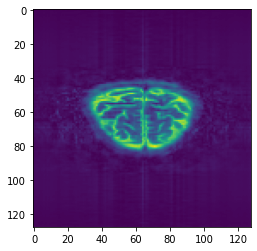

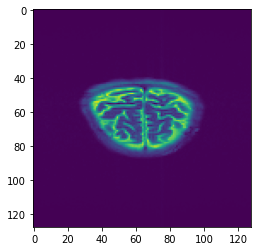

Time taken for epoch:  149.2502200603485
[0, 1]
Dev_Loss 0.003069867910719352 Epoch 192
L1_Loss 0.2870443767172561 L2_Loss 0.28499546902244993 SSIM_Loss 0.3046878056772756 Epoch 192
Epoch = [ 192/ 250] TrainLoss = 0.0005975  DevLoss = 0.00307 TrainTime = 114.5772s DevTime = 31.7634s


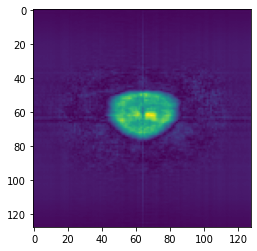

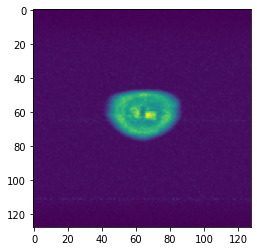

Time taken for epoch:  149.75435423851013
[0, 1]
Dev_Loss 0.0030557286726512834 Epoch 193
L1_Loss 0.30083743751701525 L2_Loss 0.2452720768172811 SSIM_Loss 0.28470539615673424 Epoch 193
Epoch = [ 193/ 250] TrainLoss = 0.0008349  DevLoss = 0.003056 TrainTime = 114.4310s DevTime = 31.8333s


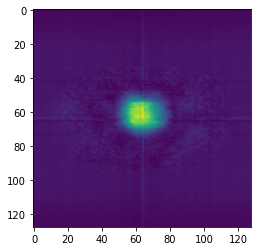

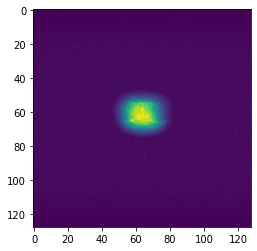

Time taken for epoch:  149.6634476184845
[0, 1]
Dev_Loss 0.0030123058344520416 Epoch 194
L1_Loss 0.28080829172818134 L2_Loss 0.2679043731411374 SSIM_Loss 0.2956333654902199 Epoch 194
Epoch = [ 194/ 250] TrainLoss = 0.0007083  DevLoss = 0.003012 TrainTime = 114.4929s DevTime = 31.8819s


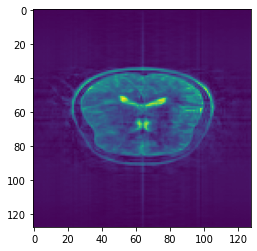

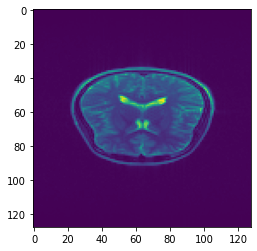

Time taken for epoch:  149.54341340065002
[0, 1]
Dev_Loss 0.0030068181184758026 Epoch 195
L1_Loss 0.29797632330728513 L2_Loss 0.2943585249549913 SSIM_Loss 0.2893796123092625 Epoch 195
Epoch = [ 195/ 250] TrainLoss = 0.0007999  DevLoss = 0.003007 TrainTime = 114.2958s DevTime = 31.8142s


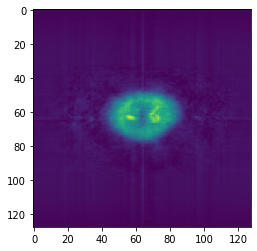

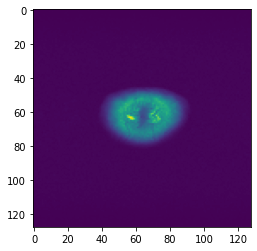

Time taken for epoch:  149.52572894096375
[0, 1]
Dev_Loss 0.0030685063257005064 Epoch 196
L1_Loss 0.2694082040306688 L2_Loss 0.27274658659969725 SSIM_Loss 0.26303076651496776 Epoch 196
Epoch = [ 196/ 250] TrainLoss = 0.0007105  DevLoss = 0.003069 TrainTime = 114.4478s DevTime = 31.8290s


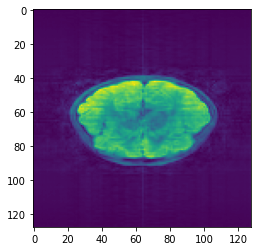

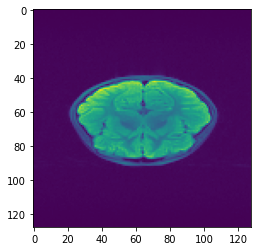

Time taken for epoch:  149.68036794662476
[0, 1]
Dev_Loss 0.0030881628875280964 Epoch 197
L1_Loss 0.2983050222721166 L2_Loss 0.28539611142852167 SSIM_Loss 0.30126634146860326 Epoch 197
Epoch = [ 197/ 250] TrainLoss = 0.0007143  DevLoss = 0.003088 TrainTime = 114.2877s DevTime = 31.7693s


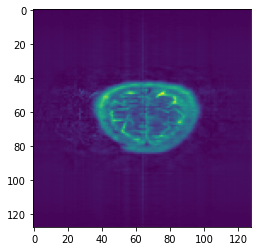

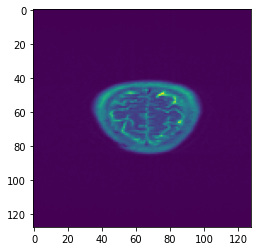

Time taken for epoch:  149.43850994110107
[0, 1]
Dev_Loss 0.0029605704683021913 Epoch 198
L1_Loss 0.2825300525230569 L2_Loss 0.2697164920953312 SSIM_Loss 0.2799923433462322 Epoch 198
Epoch = [ 198/ 250] TrainLoss = 0.0006352  DevLoss = 0.002961 TrainTime = 114.4874s DevTime = 31.7924s


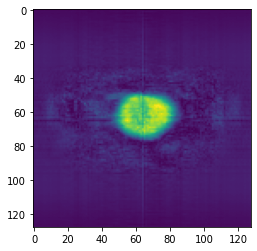

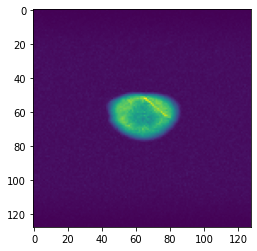

Time taken for epoch:  149.69765734672546
[0, 1]
Dev_Loss 0.0030521180061019947 Epoch 199
L1_Loss 0.25066490029433025 L2_Loss 0.2868462610574925 SSIM_Loss 0.2871166035090561 Epoch 199
Epoch = [ 199/ 250] TrainLoss = 0.0006249  DevLoss = 0.003052 TrainTime = 114.7155s DevTime = 31.7287s


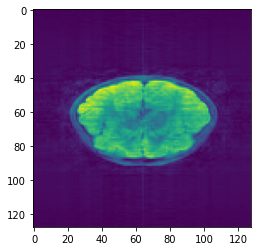

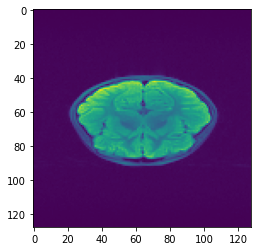

Time taken for epoch:  149.82997107505798
[0, 1]
Dev_Loss 0.003026155010291725 Epoch 200
L1_Loss 0.29031971494033876 L2_Loss 0.2808575120918996 SSIM_Loss 0.2881614464493155 Epoch 200
Epoch = [ 200/ 250] TrainLoss = 0.000772  DevLoss = 0.003026 TrainTime = 114.4035s DevTime = 31.9109s


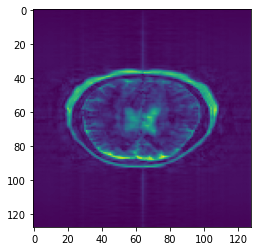

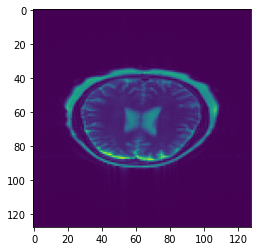

Time taken for epoch:  149.63341784477234
[0, 1]
Dev_Loss 0.0030563162095810902 Epoch 201
L1_Loss 0.28641945066103763 L2_Loss 0.28756775480760116 SSIM_Loss 0.28567957734316735 Epoch 201
Epoch = [ 201/ 250] TrainLoss = 0.0007128  DevLoss = 0.003056 TrainTime = 114.2034s DevTime = 31.7226s


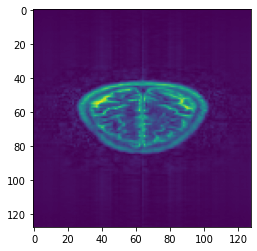

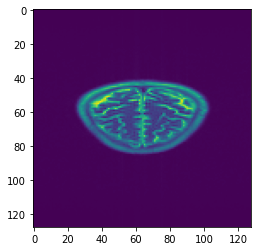

Time taken for epoch:  149.42808151245117
[0, 1]
Dev_Loss 0.003066628586937866 Epoch 202
L1_Loss 0.295068102362963 L2_Loss 0.2846904871903522 SSIM_Loss 0.2687760810735771 Epoch 202
Epoch = [ 202/ 250] TrainLoss = 0.000995  DevLoss = 0.003067 TrainTime = 114.3259s DevTime = 31.8466s


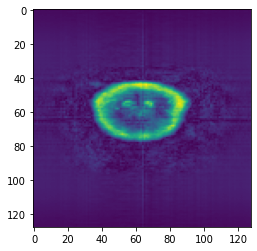

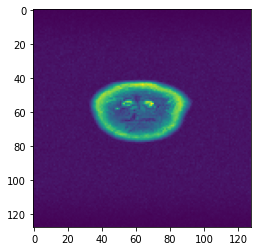

Time taken for epoch:  149.71866369247437
[0, 1]
Dev_Loss 0.003039428797091557 Epoch 203
L1_Loss 0.29134214080809395 L2_Loss 0.28515028580390234 SSIM_Loss 0.28004005016418193 Epoch 203
Epoch = [ 203/ 250] TrainLoss = 0.0006429  DevLoss = 0.003039 TrainTime = 114.3824s DevTime = 31.7655s


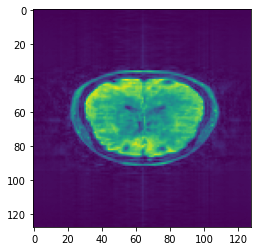

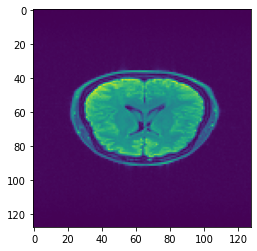

Time taken for epoch:  149.57222747802734
[0, 1]
Dev_Loss 0.003081574309643292 Epoch 204
L1_Loss 0.28506786300316533 L2_Loss 0.2848223723658857 SSIM_Loss 0.2975643324368064 Epoch 204
Epoch = [ 204/ 250] TrainLoss = 0.000582  DevLoss = 0.003082 TrainTime = 114.3823s DevTime = 31.7819s


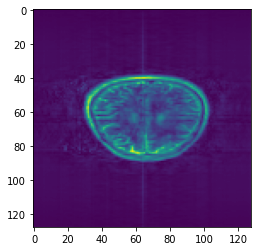

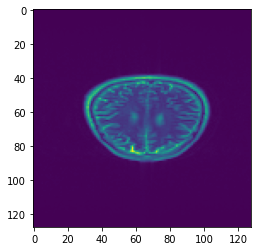

Time taken for epoch:  149.70540809631348
[0, 1]
Dev_Loss 0.0030938821058236394 Epoch 205
L1_Loss 0.2853969672949838 L2_Loss 0.2924545395232205 SSIM_Loss 0.30272393739778275 Epoch 205
Epoch = [ 205/ 250] TrainLoss = 0.0006634  DevLoss = 0.003094 TrainTime = 114.4962s DevTime = 31.8205s


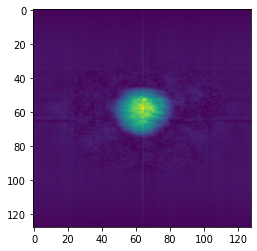

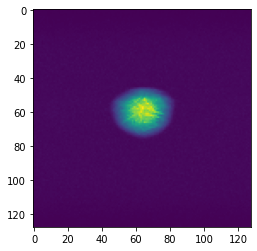

Time taken for epoch:  149.70322608947754
[0, 1]
Dev_Loss 0.002978469289925656 Epoch 206
L1_Loss 0.28463645896573936 L2_Loss 0.2868444975033659 SSIM_Loss 0.29229865382910714 Epoch 206
Epoch = [ 206/ 250] TrainLoss = 0.0009727  DevLoss = 0.002978 TrainTime = 114.3831s DevTime = 31.7632s


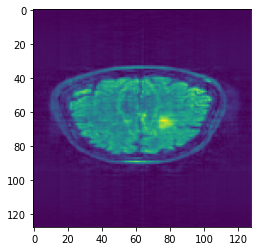

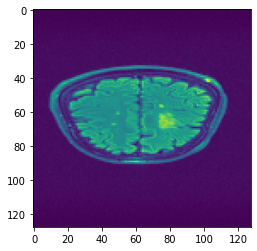

Time taken for epoch:  149.59963297843933
[0, 1]
Dev_Loss 0.003075384914111921 Epoch 207
L1_Loss 0.28330082249473704 L2_Loss 0.29135106154406953 SSIM_Loss 0.2947387111252974 Epoch 207
Epoch = [ 207/ 250] TrainLoss = 0.0006035  DevLoss = 0.003075 TrainTime = 114.4952s DevTime = 31.7586s


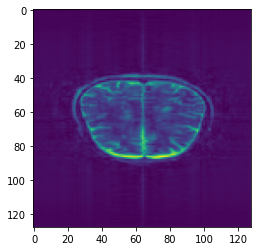

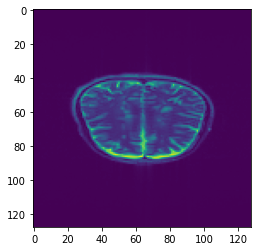

Time taken for epoch:  149.6054708957672
[0, 1]
Dev_Loss 0.0030326893337315093 Epoch 208
L1_Loss 0.2829060949207988 L2_Loss 0.2736597186126706 SSIM_Loss 0.2862155116070085 Epoch 208
Epoch = [ 208/ 250] TrainLoss = 0.0007025  DevLoss = 0.003033 TrainTime = 114.5311s DevTime = 31.8066s


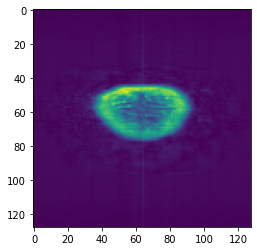

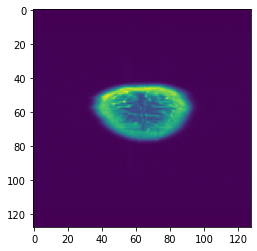

Time taken for epoch:  149.66295886039734
[0, 1]
Dev_Loss 0.0030360060421540376 Epoch 209
L1_Loss 0.278707120308825 L2_Loss 0.28878206915406074 SSIM_Loss 0.2756903474306505 Epoch 209
Epoch = [ 209/ 250] TrainLoss = 0.0006812  DevLoss = 0.003036 TrainTime = 114.6530s DevTime = 31.7908s


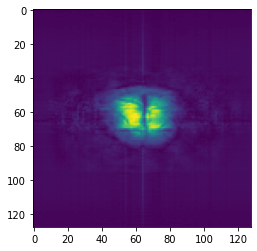

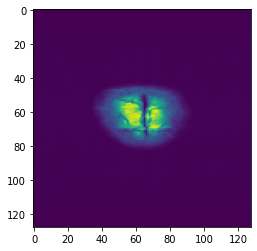

Time taken for epoch:  149.91330194473267
[0, 1]
Dev_Loss 0.003185675445376508 Epoch 210
L1_Loss 0.2932257552928152 L2_Loss 0.29164234892905666 SSIM_Loss 0.29175636819977174 Epoch 210
Epoch = [ 210/ 250] TrainLoss = 0.0006229  DevLoss = 0.003186 TrainTime = 114.3975s DevTime = 31.8363s


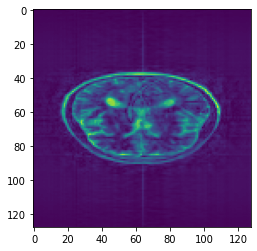

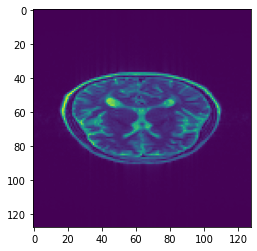

Time taken for epoch:  149.54973983764648
[0, 1]
Dev_Loss 0.00308293376094939 Epoch 211
L1_Loss 0.27550550156190606 L2_Loss 0.29694499181649586 SSIM_Loss 0.27828396282609863 Epoch 211
Epoch = [ 211/ 250] TrainLoss = 0.0005961  DevLoss = 0.003083 TrainTime = 114.5169s DevTime = 31.8033s


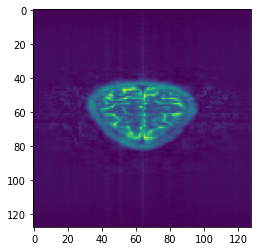

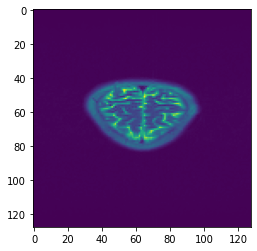

Time taken for epoch:  149.71930360794067
[0, 1]
Dev_Loss 0.003062754996654391 Epoch 212
L1_Loss 0.2993350581247541 L2_Loss 0.2870827548302041 SSIM_Loss 0.29016699547672503 Epoch 212
Epoch = [ 212/ 250] TrainLoss = 0.0006077  DevLoss = 0.003063 TrainTime = 114.2978s DevTime = 31.7892s


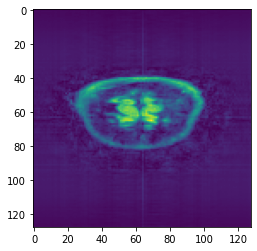

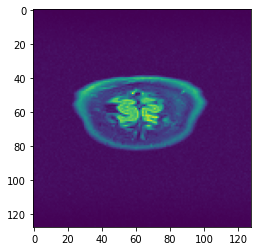

Time taken for epoch:  149.51801800727844
[0, 1]
Dev_Loss 0.0032596347059273196 Epoch 213
L1_Loss 0.29442730109562076 L2_Loss 0.2697398549935 SSIM_Loss 0.2904706475037156 Epoch 213
Epoch = [ 213/ 250] TrainLoss = 0.0009259  DevLoss = 0.00326 TrainTime = 114.3924s DevTime = 31.8369s


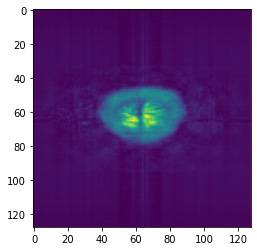

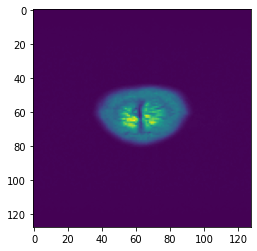

Time taken for epoch:  149.75314736366272
[0, 1]
Dev_Loss 0.0030930089395760692 Epoch 214
L1_Loss 0.2894497367153131 L2_Loss 0.27749903473269427 SSIM_Loss 0.2779148520094778 Epoch 214
Epoch = [ 214/ 250] TrainLoss = 0.0006309  DevLoss = 0.003093 TrainTime = 114.4669s DevTime = 31.8711s


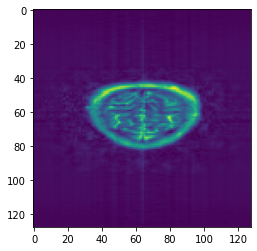

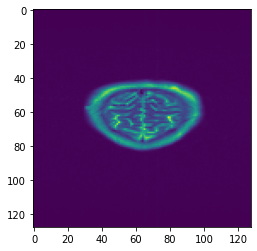

Time taken for epoch:  149.81670236587524
[0, 1]
Dev_Loss 0.003026650966778443 Epoch 215
L1_Loss 0.2807677458187318 L2_Loss 0.28287959821189546 SSIM_Loss 0.2955507979739251 Epoch 215
Epoch = [ 215/ 250] TrainLoss = 0.0006488  DevLoss = 0.003027 TrainTime = 114.5791s DevTime = 31.6940s


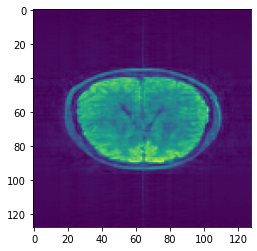

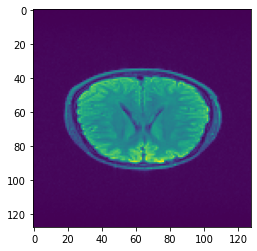

Time taken for epoch:  149.73338150978088
[0, 1]
Dev_Loss 0.002997682377785574 Epoch 216
L1_Loss 0.27851924175078063 L2_Loss 0.281296095502411 SSIM_Loss 0.2849706084177385 Epoch 216
Epoch = [ 216/ 250] TrainLoss = 0.0007601  DevLoss = 0.002998 TrainTime = 114.6567s DevTime = 31.8249s


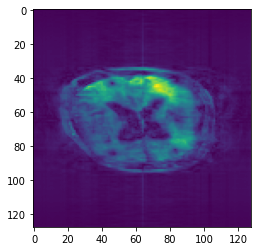

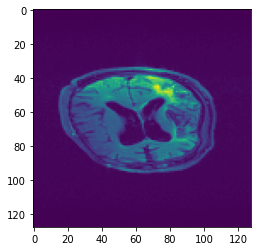

Time taken for epoch:  149.8953561782837
[0, 1]
Dev_Loss 0.003104733584485261 Epoch 217
L1_Loss 0.29212260362475145 L2_Loss 0.27800077875164475 SSIM_Loss 0.2911347007247754 Epoch 217
Epoch = [ 217/ 250] TrainLoss = 0.000668  DevLoss = 0.003105 TrainTime = 114.5402s DevTime = 31.7844s


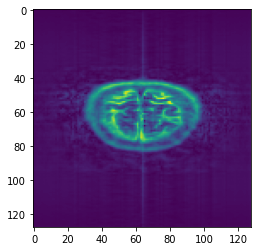

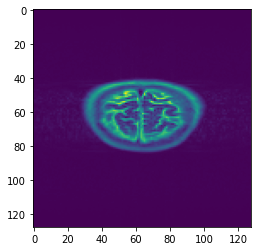

Time taken for epoch:  149.9049322605133
[0, 1]
Dev_Loss 0.0030662505667061325 Epoch 218
L1_Loss 0.29303972519547655 L2_Loss 0.27568303220554585 SSIM_Loss 0.2935416781013808 Epoch 218
Epoch = [ 218/ 250] TrainLoss = 0.0007084  DevLoss = 0.003066 TrainTime = 114.2585s DevTime = 31.8687s


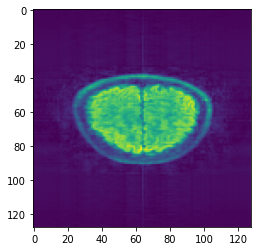

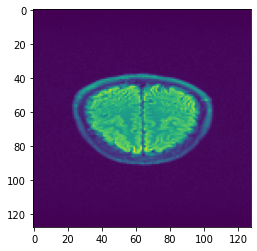

Time taken for epoch:  149.46582412719727
[0, 1]
Dev_Loss 0.0030689336214095243 Epoch 219
L1_Loss 0.2961865172741099 L2_Loss 0.2693506469656201 SSIM_Loss 0.29076535405406817 Epoch 219
Epoch = [ 219/ 250] TrainLoss = 0.0005869  DevLoss = 0.003069 TrainTime = 114.3122s DevTime = 31.7722s


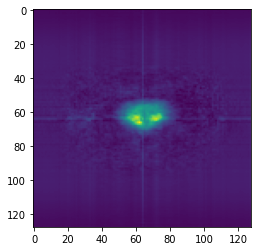

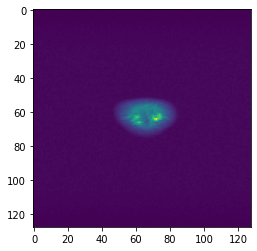

Time taken for epoch:  149.36692118644714
[0, 1]
Dev_Loss 0.003160036605703923 Epoch 220
L1_Loss 0.283427770007686 L2_Loss 0.29418800198268824 SSIM_Loss 0.29496526213090485 Epoch 220
Epoch = [ 220/ 250] TrainLoss = 0.000676  DevLoss = 0.00316 TrainTime = 114.3509s DevTime = 31.9116s


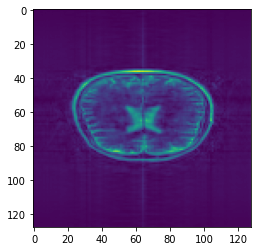

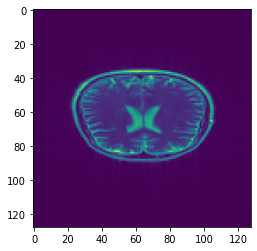

Time taken for epoch:  149.65157175064087
[0, 1]
Dev_Loss 0.003108749077989408 Epoch 221
L1_Loss 0.2843042368386008 L2_Loss 0.29952176623470234 SSIM_Loss 0.28447318338816086 Epoch 221
Epoch = [ 221/ 250] TrainLoss = 0.0006165  DevLoss = 0.003109 TrainTime = 114.4384s DevTime = 31.7214s


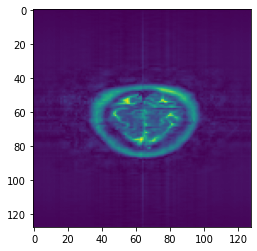

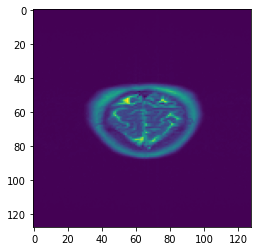

Time taken for epoch:  149.43376755714417
[0, 1]
Dev_Loss 0.003013140049123765 Epoch 222
L1_Loss 0.2900353307411981 L2_Loss 0.2854797335695521 SSIM_Loss 0.28283268413126644 Epoch 222
Epoch = [ 222/ 250] TrainLoss = 0.0007542  DevLoss = 0.003013 TrainTime = 114.5322s DevTime = 31.8168s


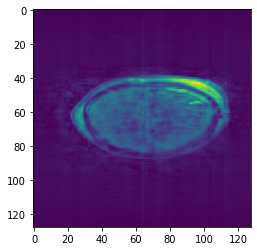

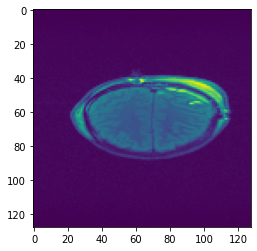

Time taken for epoch:  149.7215223312378
[0, 1]
Dev_Loss 0.0029767392426324015 Epoch 223
L1_Loss 0.28645939412784177 L2_Loss 0.28868754119911627 SSIM_Loss 0.27205054129306916 Epoch 223
Epoch = [ 223/ 250] TrainLoss = 0.0007171  DevLoss = 0.002977 TrainTime = 114.4673s DevTime = 31.7843s


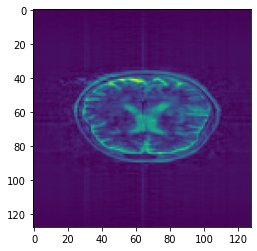

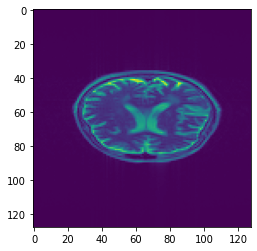

Time taken for epoch:  149.74712991714478
[0, 1]
Dev_Loss 0.003005748766419195 Epoch 224
L1_Loss 0.2839329866299481 L2_Loss 0.28991657717231917 SSIM_Loss 0.28330978391313094 Epoch 224
Epoch = [ 224/ 250] TrainLoss = 0.000584  DevLoss = 0.003006 TrainTime = 114.4247s DevTime = 31.8866s


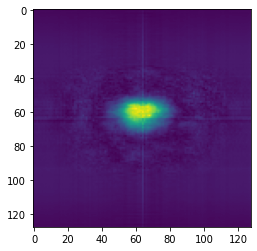

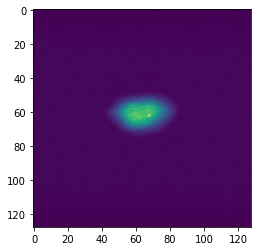

Time taken for epoch:  149.56616950035095
[0, 1]
Dev_Loss 0.003066363970817375 Epoch 225
L1_Loss 0.29401721477876813 L2_Loss 0.28184813827768196 SSIM_Loss 0.2824303053955248 Epoch 225
Epoch = [ 225/ 250] TrainLoss = 0.0008008  DevLoss = 0.003066 TrainTime = 114.3697s DevTime = 31.8570s


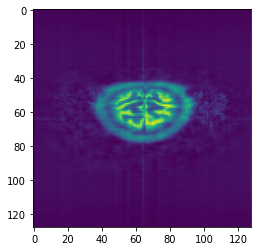

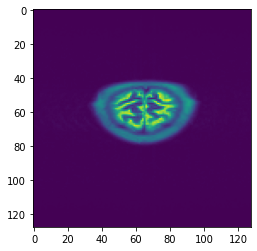

Time taken for epoch:  149.5565800666809
[0, 1]
Dev_Loss 0.0030174072983484624 Epoch 226
L1_Loss 0.2846090206308362 L2_Loss 0.2901500120864757 SSIM_Loss 0.2859971207185192 Epoch 226
Epoch = [ 226/ 250] TrainLoss = 0.0006104  DevLoss = 0.003017 TrainTime = 114.3069s DevTime = 31.7607s


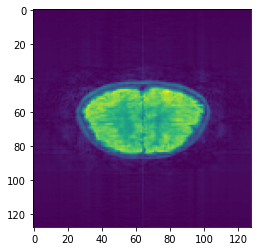

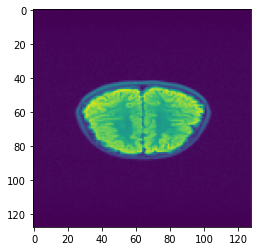

Time taken for epoch:  149.27188515663147
[0, 1]
Dev_Loss 0.003084033822195803 Epoch 227
L1_Loss 0.2826205658936621 L2_Loss 0.2895412652331849 SSIM_Loss 0.28334578791880033 Epoch 227
Epoch = [ 227/ 250] TrainLoss = 0.000713  DevLoss = 0.003084 TrainTime = 114.3757s DevTime = 31.8380s


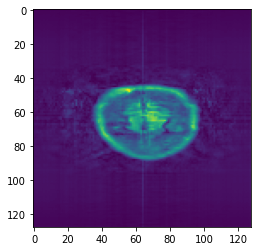

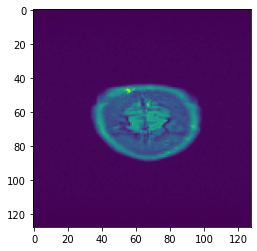

Time taken for epoch:  149.5629768371582
[0, 1]
Dev_Loss 0.003152416830621814 Epoch 228
L1_Loss 0.2782476567341711 L2_Loss 0.2910502078705436 SSIM_Loss 0.2893848336434886 Epoch 228
Epoch = [ 228/ 250] TrainLoss = 0.0007749  DevLoss = 0.003152 TrainTime = 114.4557s DevTime = 31.7466s


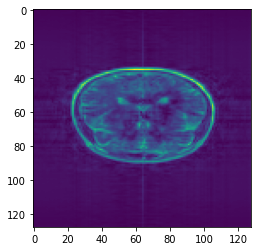

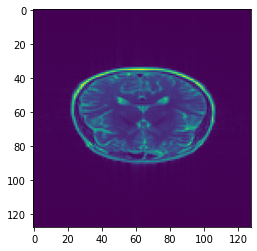

Time taken for epoch:  149.37069821357727
[0, 1]
Dev_Loss 0.0030606441936608954 Epoch 229
L1_Loss 0.2880239009845534 L2_Loss 0.28628680552059976 SSIM_Loss 0.28640088326018814 Epoch 229
Epoch = [ 229/ 250] TrainLoss = 0.0006376  DevLoss = 0.003061 TrainTime = 114.4544s DevTime = 31.8379s


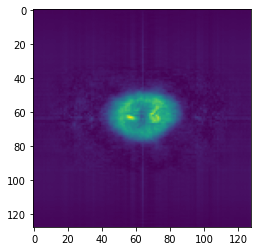

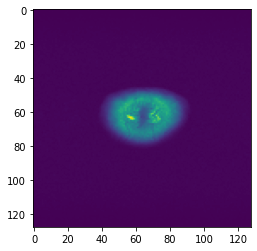

Time taken for epoch:  149.63898992538452
[0, 1]
Dev_Loss 0.003141215565777516 Epoch 230
L1_Loss 0.28526268962610896 L2_Loss 0.28965413506744897 SSIM_Loss 0.3023450779525049 Epoch 230
Epoch = [ 230/ 250] TrainLoss = 0.0006462  DevLoss = 0.003141 TrainTime = 114.3021s DevTime = 31.8159s


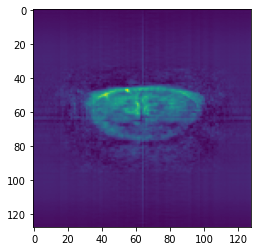

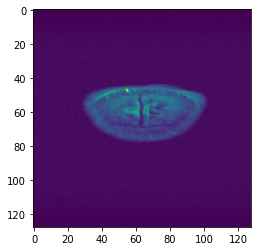

Time taken for epoch:  149.62875771522522
[0, 1]
Dev_Loss 0.0030938947131028327 Epoch 231
L1_Loss 0.2885173759551492 L2_Loss 0.2977294144740802 SSIM_Loss 0.2796939003134897 Epoch 231
Epoch = [ 231/ 250] TrainLoss = 0.0006486  DevLoss = 0.003094 TrainTime = 114.5322s DevTime = 31.7290s


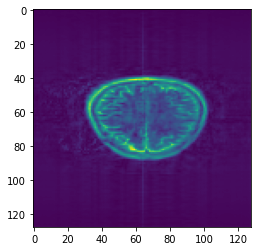

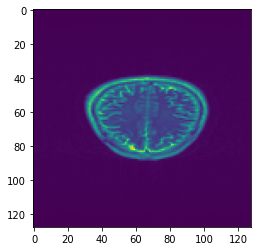

Time taken for epoch:  149.56085586547852
[0, 1]
Dev_Loss 0.0030490618612638684 Epoch 232
L1_Loss 0.2777824792536307 L2_Loss 0.2852582897132952 SSIM_Loss 0.28829935867311723 Epoch 232
Epoch = [ 232/ 250] TrainLoss = 0.0007239  DevLoss = 0.003049 TrainTime = 114.5630s DevTime = 31.8935s


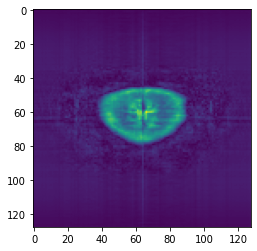

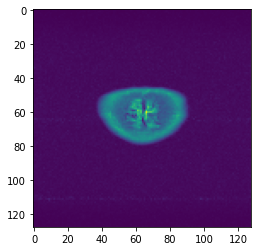

Time taken for epoch:  149.64554929733276
[0, 1]
Dev_Loss 0.0030839502994499243 Epoch 233
L1_Loss 0.28701572046649176 L2_Loss 0.2866719149032906 SSIM_Loss 0.27786839993143986 Epoch 233
Epoch = [ 233/ 250] TrainLoss = 0.0006664  DevLoss = 0.003084 TrainTime = 114.5960s DevTime = 31.8085s


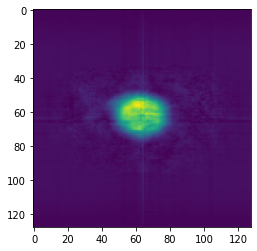

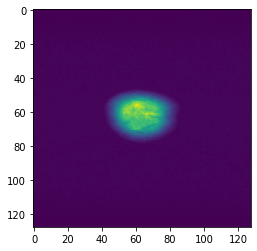

Time taken for epoch:  149.73872828483582
[0, 1]
Dev_Loss 0.0030786194249550983 Epoch 234
L1_Loss 0.2967850949670328 L2_Loss 0.2842569668561476 SSIM_Loss 0.25616465432324254 Epoch 234
Epoch = [ 234/ 250] TrainLoss = 0.0006233  DevLoss = 0.003079 TrainTime = 114.3234s DevTime = 31.7814s


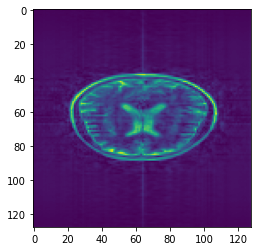

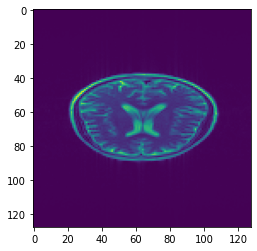

Time taken for epoch:  149.4492244720459
[0, 1]
Dev_Loss 0.0030106150508166112 Epoch 235
L1_Loss 0.24165617244672874 L2_Loss 0.29938747022760964 SSIM_Loss 0.2786717344473311 Epoch 235
Epoch = [ 235/ 250] TrainLoss = 0.0006646  DevLoss = 0.003011 TrainTime = 114.5208s DevTime = 31.8481s


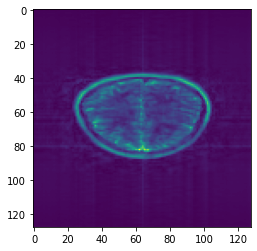

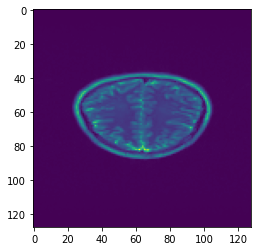

Time taken for epoch:  149.61922907829285
[0, 1]
Dev_Loss 0.003054686159846094 Epoch 236
L1_Loss 0.2978030851652935 L2_Loss 0.2802895603470083 SSIM_Loss 0.29678121124920653 Epoch 236
Epoch = [ 236/ 250] TrainLoss = 0.0007438  DevLoss = 0.003055 TrainTime = 114.5490s DevTime = 31.7921s


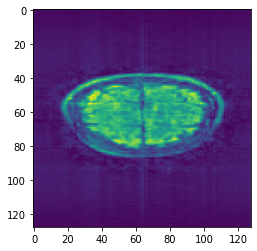

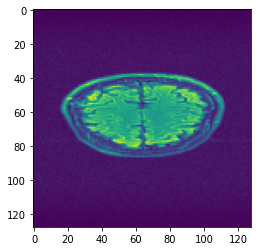

Time taken for epoch:  149.65463852882385
[0, 1]
Dev_Loss 0.0029996085681934146 Epoch 237
L1_Loss 0.2753597350552185 L2_Loss 0.28965419154223326 SSIM_Loss 0.28701500892144866 Epoch 237
Epoch = [ 237/ 250] TrainLoss = 0.0006915  DevLoss = 0.003 TrainTime = 114.5431s DevTime = 31.8948s


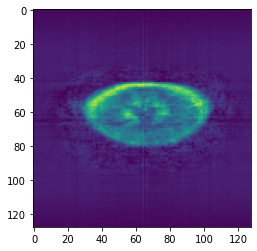

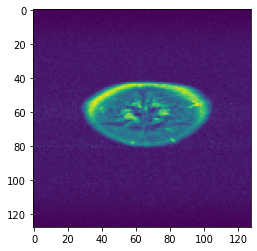

Time taken for epoch:  149.72003650665283
[0, 1]
Dev_Loss 0.003153177238337058 Epoch 238
L1_Loss 0.2929464163930003 L2_Loss 0.28913119427948025 SSIM_Loss 0.29104541644411497 Epoch 238
Epoch = [ 238/ 250] TrainLoss = 0.000635  DevLoss = 0.003153 TrainTime = 114.5392s DevTime = 31.8608s


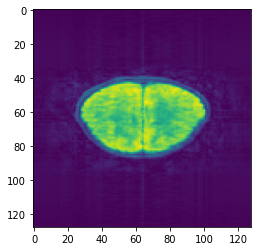

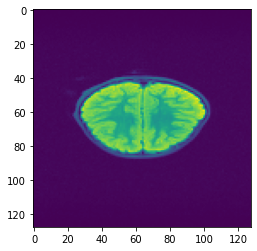

Time taken for epoch:  149.69859337806702
[0, 1]
Dev_Loss 0.0030981435670500326 Epoch 239
L1_Loss 0.29313773455412956 L2_Loss 0.2895435171146424 SSIM_Loss 0.2326266625050977 Epoch 239
Epoch = [ 239/ 250] TrainLoss = 0.0006603  DevLoss = 0.003098 TrainTime = 114.4788s DevTime = 31.7047s


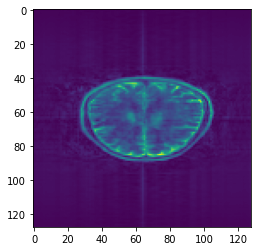

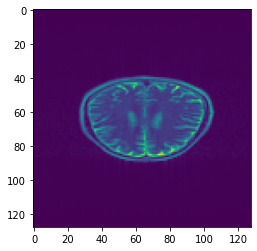

Time taken for epoch:  149.40573358535767
[0, 1]
Dev_Loss 0.0030415533504269225 Epoch 240
L1_Loss 0.28244384178192167 L2_Loss 0.2861450252921704 SSIM_Loss 0.2866205725342676 Epoch 240
Epoch = [ 240/ 250] TrainLoss = 0.0007349  DevLoss = 0.003042 TrainTime = 114.5481s DevTime = 31.7832s


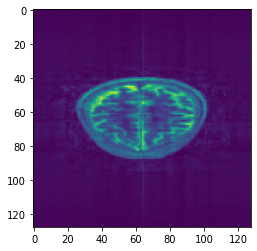

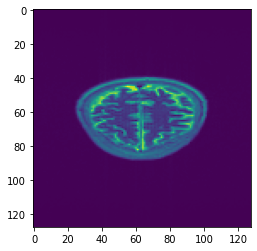

Time taken for epoch:  150.16440153121948
[0, 1]
Dev_Loss 0.003015662035085147 Epoch 241
L1_Loss 0.2878904023579949 L2_Loss 0.2881070576812471 SSIM_Loss 0.2884971541832691 Epoch 241
Epoch = [ 241/ 250] TrainLoss = 0.0007155  DevLoss = 0.003016 TrainTime = 114.5344s DevTime = 31.7056s


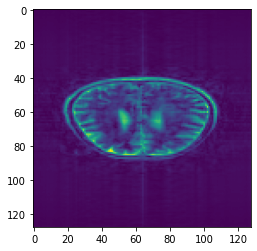

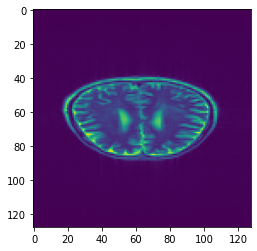

Time taken for epoch:  149.5543315410614
[0, 1]
Dev_Loss 0.0030616148693466574 Epoch 242
L1_Loss 0.2968913169661874 L2_Loss 0.28497308640768365 SSIM_Loss 0.2935122975805302 Epoch 242
Epoch = [ 242/ 250] TrainLoss = 0.0006753  DevLoss = 0.003062 TrainTime = 114.8790s DevTime = 31.8410s


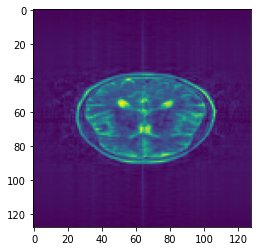

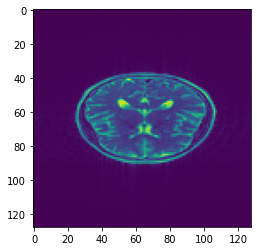

Time taken for epoch:  149.87987184524536
[0, 1]
Dev_Loss 0.003145476424929486 Epoch 243
L1_Loss 0.29127412902822275 L2_Loss 0.29268616173701345 SSIM_Loss 0.24630849844649053 Epoch 243
Epoch = [ 243/ 250] TrainLoss = 0.000683  DevLoss = 0.003145 TrainTime = 114.8414s DevTime = 31.8630s


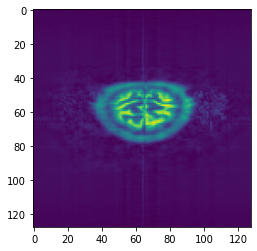

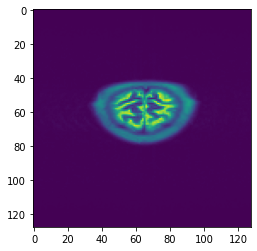

Time taken for epoch:  149.96697545051575
[0, 1]
Dev_Loss 0.003105334039708642 Epoch 244
L1_Loss 0.28856980284845873 L2_Loss 0.2348566188320046 SSIM_Loss 0.28284919815046555 Epoch 244
Epoch = [ 244/ 250] TrainLoss = 0.0006407  DevLoss = 0.003105 TrainTime = 114.5759s DevTime = 31.7436s


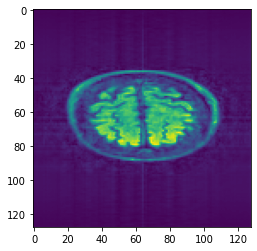

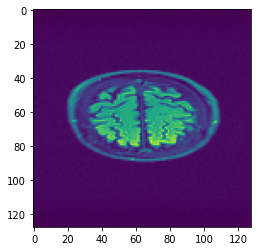

Time taken for epoch:  149.65084981918335
[0, 1]
Dev_Loss 0.0029922937639695704 Epoch 245
L1_Loss 0.2841098804188731 L2_Loss 0.2864332237192507 SSIM_Loss 0.2832599211635512 Epoch 245
Epoch = [ 245/ 250] TrainLoss = 0.0006885  DevLoss = 0.002992 TrainTime = 114.5128s DevTime = 31.8341s


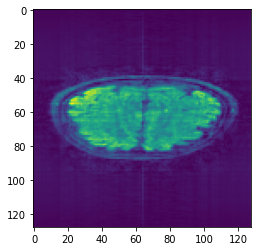

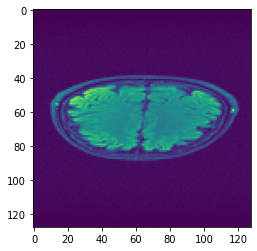

Time taken for epoch:  149.61313557624817
[0, 1]
Dev_Loss 0.0030587653779893783 Epoch 246
L1_Loss 0.29616154294904967 L2_Loss 0.282806200222733 SSIM_Loss 0.29108245658990944 Epoch 246
Epoch = [ 246/ 250] TrainLoss = 0.0007822  DevLoss = 0.003059 TrainTime = 114.4159s DevTime = 31.6701s


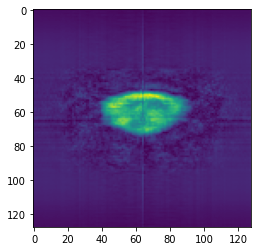

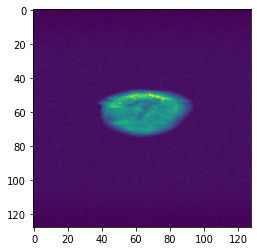

Time taken for epoch:  149.1796634197235
[0, 1]
Dev_Loss 0.0030082977837888945 Epoch 247
L1_Loss 0.2570326314425775 L2_Loss 0.2904010666837778 SSIM_Loss 0.2844041444776659 Epoch 247
Epoch = [ 247/ 250] TrainLoss = 0.0008883  DevLoss = 0.003008 TrainTime = 114.5511s DevTime = 31.9475s


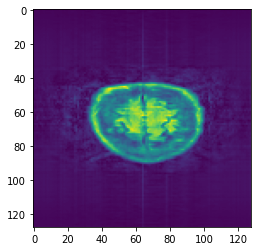

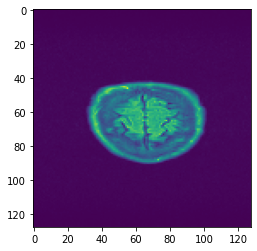

Time taken for epoch:  149.78210830688477
[0, 1]
Dev_Loss 0.0032124173202988304 Epoch 248
L1_Loss 0.2885263709920533 L2_Loss 0.2779175362534496 SSIM_Loss 0.3051571068094759 Epoch 248
Epoch = [ 248/ 250] TrainLoss = 0.0006137  DevLoss = 0.003212 TrainTime = 114.5179s DevTime = 31.8623s


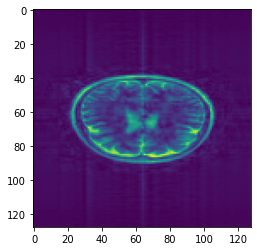

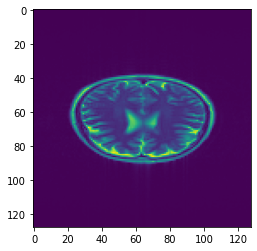

Time taken for epoch:  149.5873053073883
[0, 1]
Dev_Loss 0.0030392397721364494 Epoch 249
L1_Loss 0.28546224430840805 L2_Loss 0.28588377148945865 SSIM_Loss 0.2846897111814243 Epoch 249
Epoch = [ 249/ 250] TrainLoss = 0.0006666  DevLoss = 0.003039 TrainTime = 114.3908s DevTime = 31.8107s


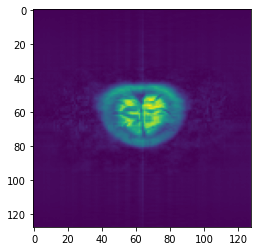

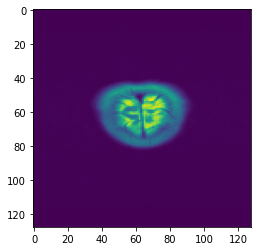

Time taken for epoch:  149.39153361320496


0.0030392397721364494

In [8]:
def train(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run

    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    logging.info(args)
    logging.info(model)

    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

        is_new_best = dev_loss < best_dev_loss
        best_dev_loss = min(best_dev_loss, dev_loss)
        save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
        print(f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} ',
        f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s')
        
        for iter, data in enumerate(train_loader):
            kspace, full = data
            input = kspace.to(f'{args.device}:{model.device_ids[0]}')
            target = full.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            break;
        
        logging.info(
            f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} '
            f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s',
        )
        print("Time taken for epoch: ",time.time()-ti)
    writer.close()
    return dev_loss
    
train(args)

In [9]:
#f ="/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelue_2020/best_model.pt"
checkpoint, model, optimizer = load_model(args.checkpoint,args)
model.eval()

Model build successfully
Model load successfully


DataParallel(
  (module): ComplexEndToEnd(
    (f_layer1): ComplexConv2d(
      (conv_r): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
      (conv_i): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
    )
    (f_layer2): ComplexConv2d(
      (conv_r): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
      (conv_i): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
    )
    (down_sample_layers): ModuleList(
      (0): ConvBlock(in_chans=16, out_chans=32, drop_prob=0.0)
      (1): ConvBlock(in_chans=32, out_chans=64, drop_prob=0.0)
      (2): ConvBlock(in_chans=64, out_chans=128, drop_prob=0.0)
      (3): ConvBlock(in_chans=128, out_chans=256, drop_prob=0.0)
    )
    (conv): ConvBlock(in_chans=256, out_chans=512, drop_prob=0.0)
    (up_conv): ModuleList(
      (0): ConvBlock(in_chans=512, out_chans=256, drop_prob=0.0)
      (1): ConvBlock(in_chans=256, out_chans=128, drop_prob=0.0)
      (2): ConvBlock(in_chans=128, out_ch

module.f_layer1.conv_r.weight tensor([[[[ 0.0044, -0.0112, -0.0003,  ..., -0.0125, -0.0033, -0.0130]]],


        [[[ 0.0017,  0.0018,  0.0016,  ...,  0.0070,  0.0038,  0.0027]]],


        [[[-0.0066,  0.0129, -0.0057,  ...,  0.0159, -0.0026,  0.0131]]],


        ...,


        [[[ 0.0081, -0.0022,  0.0088,  ...,  0.0045,  0.0084, -0.0002]]],


        [[[-0.0059,  0.0114, -0.0061,  ...,  0.0128, -0.0039,  0.0102]]],


        [[[-0.0016,  0.0038,  0.0024,  ...,  0.0094,  0.0012,  0.0059]]]],
       device='cuda:0', dtype=torch.float64)


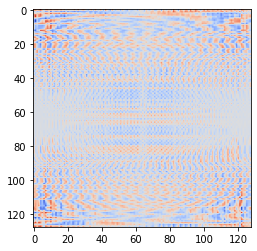

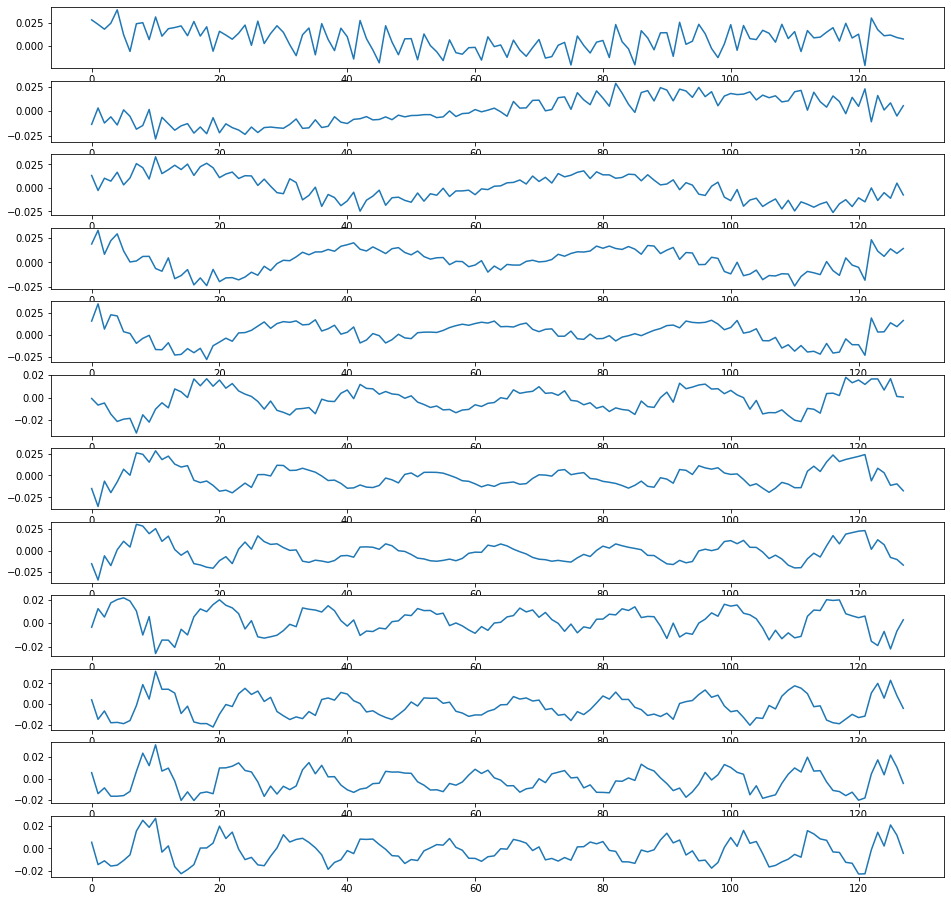

module.f_layer1.conv_i.weight tensor([[[[ 0.0079, -0.0006,  0.0069,  ..., -0.0017,  0.0047, -0.0012]]],


        [[[-0.0088,  0.0061, -0.0104,  ...,  0.0016, -0.0111,  0.0064]]],


        [[[ 0.0011, -0.0025, -0.0009,  ..., -0.0102, -0.0004, -0.0043]]],


        ...,


        [[[ 0.0022, -0.0014, -0.0001,  ..., -0.0095,  0.0016, -0.0042]]],


        [[[-0.0048,  0.0044, -0.0066,  ...,  0.0006, -0.0094,  0.0048]]],


        [[[ 0.0088, -0.0004,  0.0102,  ...,  0.0041,  0.0094, -0.0026]]]],
       device='cuda:0', dtype=torch.float64)


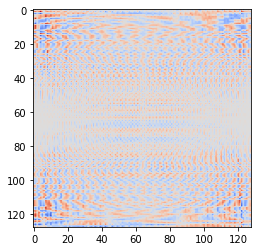

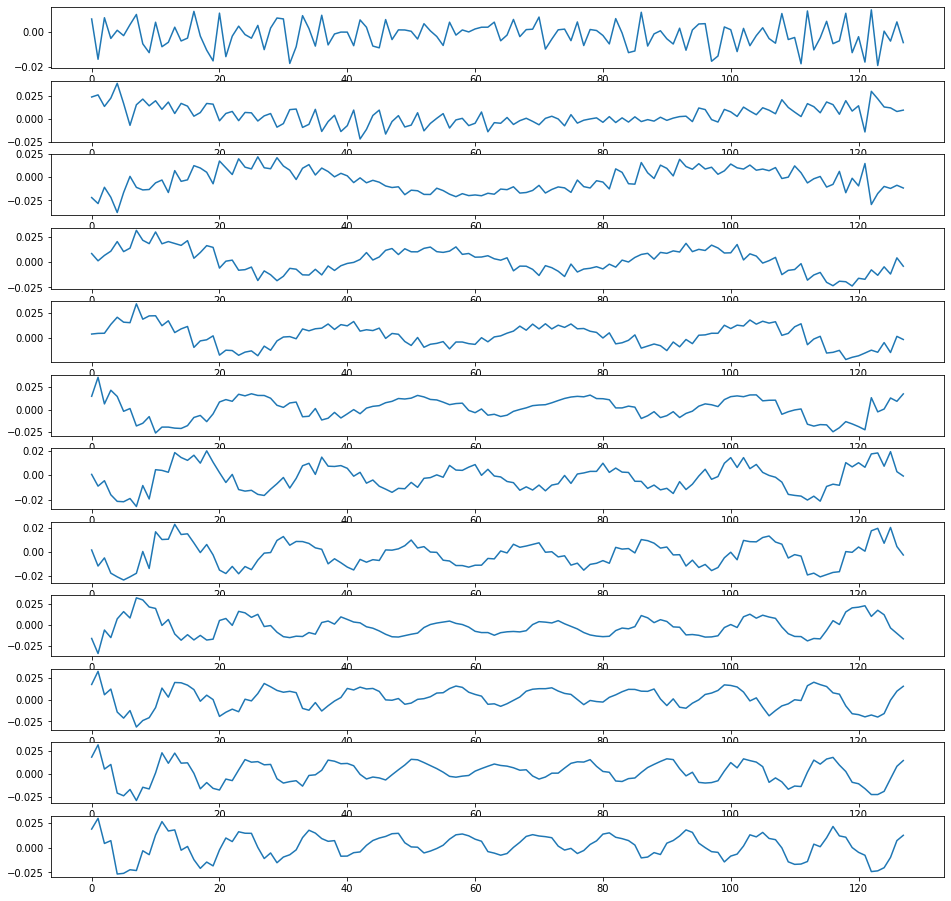

module.f_layer2.conv_r.weight tensor([[[[ 5.6545e-03, -9.2055e-03,  5.1545e-03,  ..., -7.0464e-03,
            4.2448e-03, -1.3204e-02]]],


        [[[ 1.8701e-03, -2.9805e-03,  4.9630e-03,  ..., -1.2109e-03,
            3.9590e-03, -2.2919e-04]]],


        [[[ 5.3081e-03, -4.6477e-03,  2.9327e-03,  ..., -7.3438e-03,
            4.5380e-03, -7.2124e-03]]],


        ...,


        [[[-7.7157e-03,  1.5967e-03, -6.3756e-03,  ...,  5.0930e-03,
           -8.5899e-03,  4.7431e-03]]],


        [[[ 2.0361e-03,  7.1661e-04,  3.3494e-03,  ..., -2.1927e-03,
            5.8212e-03, -4.4374e-05]]],


        [[[-6.4607e-03,  3.9719e-04, -5.3104e-03,  ...,  1.5016e-03,
           -6.0028e-03,  3.4806e-03]]]], device='cuda:0', dtype=torch.float64)


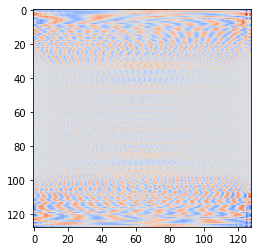

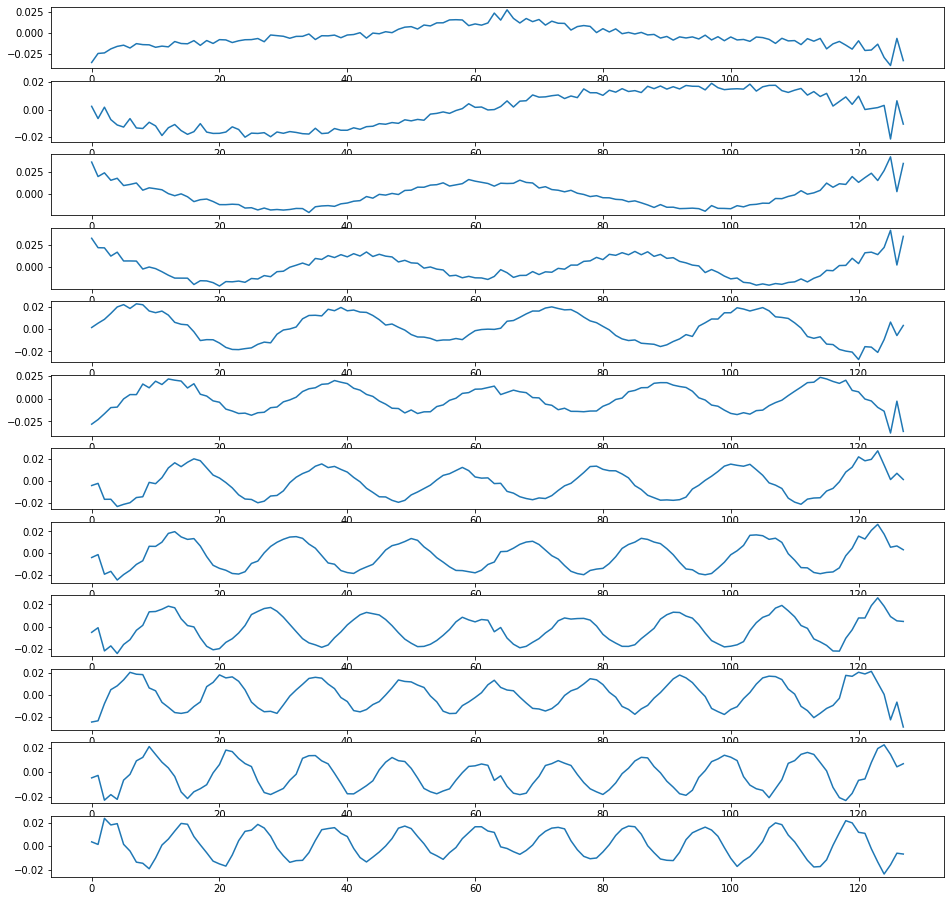

module.f_layer2.conv_i.weight tensor([[[[ 0.0010, -0.0045,  0.0010,  ..., -0.0050,  0.0001, -0.0093]]],


        [[[-0.0088,  0.0037, -0.0085,  ...,  0.0047, -0.0081,  0.0043]]],


        [[[ 0.0068, -0.0032,  0.0092,  ..., -0.0021,  0.0067, -0.0023]]],


        ...,


        [[[ 0.0059, -0.0062,  0.0046,  ..., -0.0039,  0.0011, -0.0052]]],


        [[[-0.0088,  0.0059, -0.0082,  ...,  0.0060, -0.0064,  0.0069]]],


        [[[ 0.0098, -0.0065,  0.0055,  ..., -0.0069,  0.0039, -0.0044]]]],
       device='cuda:0', dtype=torch.float64)


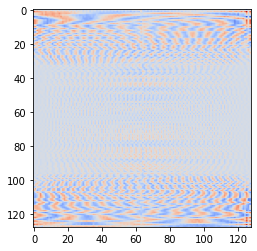

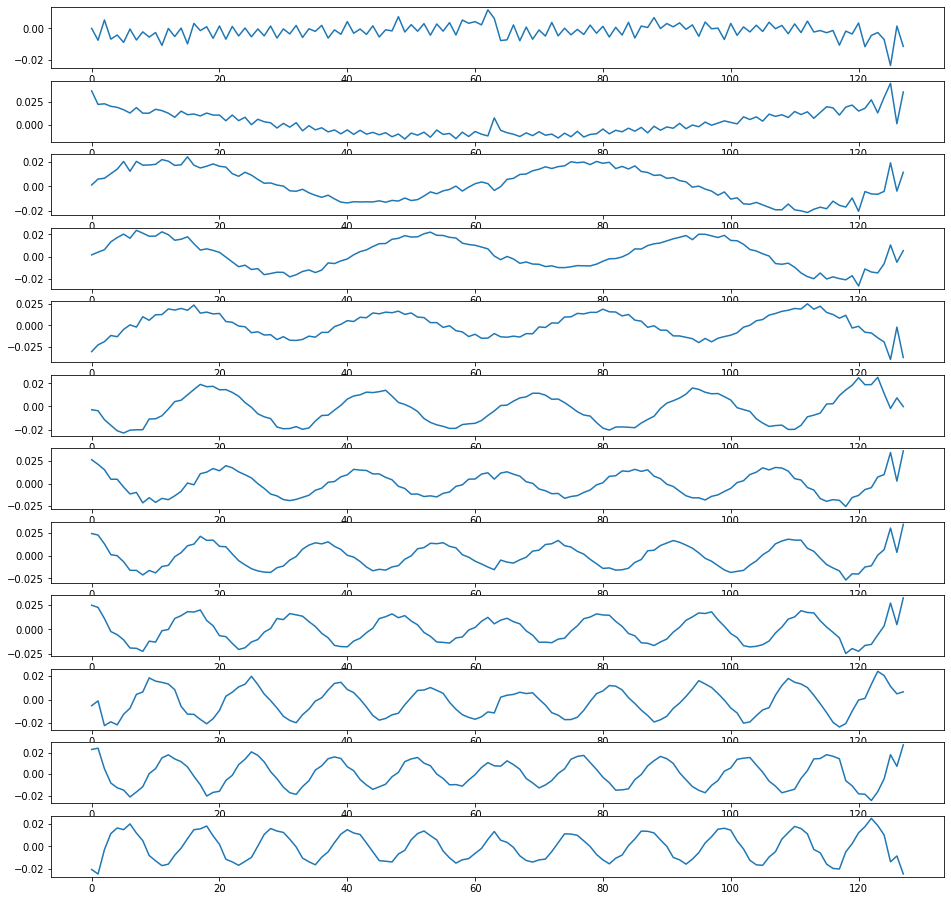

module.down_sample_layers.0.layers.0.conv_r.weight tensor([[[[ 0.0098, -0.0602,  0.0601],
          [ 0.0798,  0.0778, -0.0649],
          [-0.0102, -0.0588,  0.0152]],

         [[ 0.0588,  0.0372, -0.0858],
          [ 0.0828,  0.0584, -0.0749],
          [-0.0651,  0.0219,  0.0515]],

         [[-0.0348,  0.0028,  0.0929],
          [-0.0783, -0.0465,  0.1021],
          [ 0.0078,  0.0634,  0.0216]],

         ...,

         [[ 0.0590,  0.0463, -0.0064],
          [ 0.0194,  0.0658, -0.0694],
          [-0.0130,  0.0790,  0.0423]],

         [[-0.0038, -0.0578,  0.0406],
          [ 0.0182, -0.0483, -0.0520],
          [-0.0205,  0.0443, -0.0105]],

         [[-0.0702,  0.0358,  0.0063],
          [-0.0320,  0.0278, -0.0100],
          [ 0.0194, -0.0520,  0.0163]]],


        [[[-0.0203,  0.0030,  0.0627],
          [ 0.0576, -0.0270, -0.0284],
          [ 0.0212,  0.0355, -0.0229]],

         [[-0.0270,  0.0319, -0.0806],
          [-0.0243, -0.0116, -0.0610],
          [ 0.0587,  

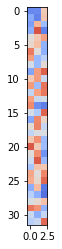

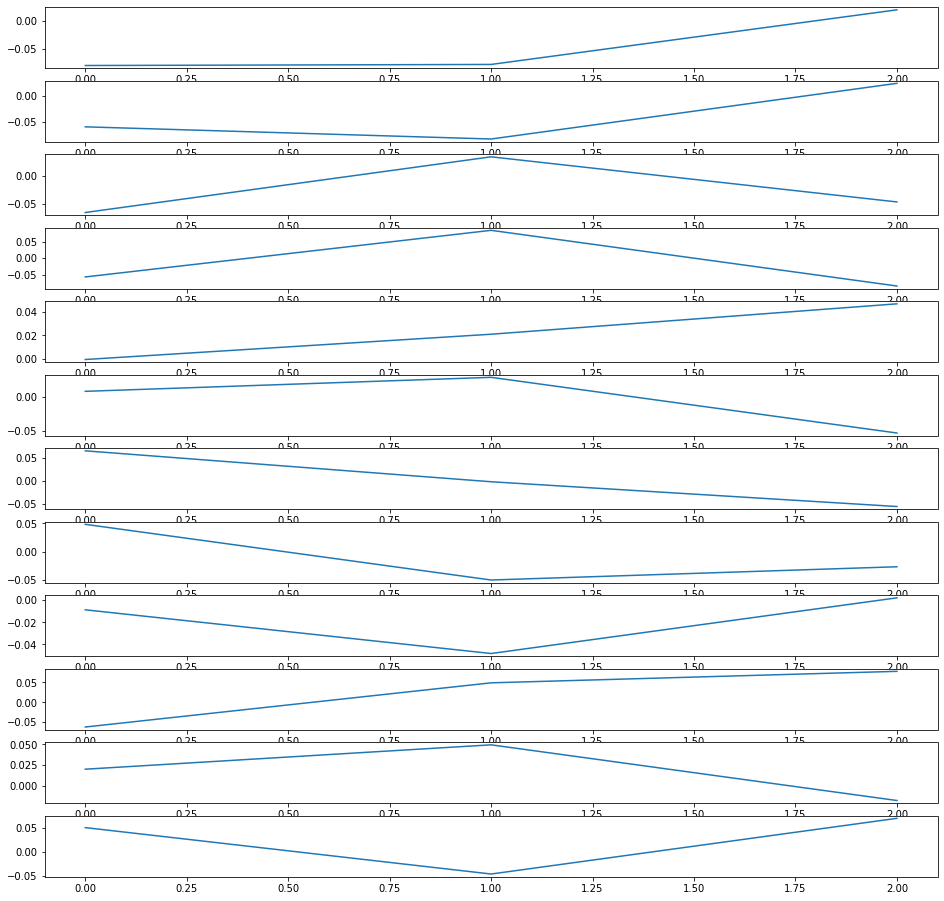

module.down_sample_layers.0.layers.0.conv_i.weight tensor([[[[-0.0013,  0.0426,  0.0182],
          [ 0.0272,  0.0694, -0.0649],
          [-0.0483, -0.0487,  0.0102]],

         [[-0.0811, -0.0307,  0.0052],
          [ 0.0148,  0.0264, -0.0179],
          [ 0.0253,  0.0252,  0.0145]],

         [[-0.0604, -0.0086, -0.0666],
          [ 0.0795, -0.0057, -0.0237],
          [ 0.0328,  0.0230,  0.0534]],

         ...,

         [[ 0.0188,  0.1049, -0.0182],
          [ 0.0333,  0.0053, -0.0595],
          [ 0.0676, -0.0133,  0.0261]],

         [[-0.0179, -0.0758,  0.1025],
          [ 0.0303,  0.0484,  0.0462],
          [ 0.0234,  0.0313,  0.0435]],

         [[-0.0557,  0.0763,  0.0032],
          [-0.0658, -0.0643,  0.0032],
          [-0.0098,  0.0663,  0.0595]]],


        [[[ 0.0719, -0.0109,  0.0016],
          [ 0.0686, -0.0114,  0.0537],
          [ 0.0599,  0.0060, -0.0225]],

         [[ 0.0540,  0.0056,  0.0047],
          [ 0.0564, -0.0667,  0.0539],
          [-0.0470, -

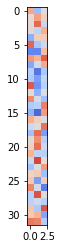

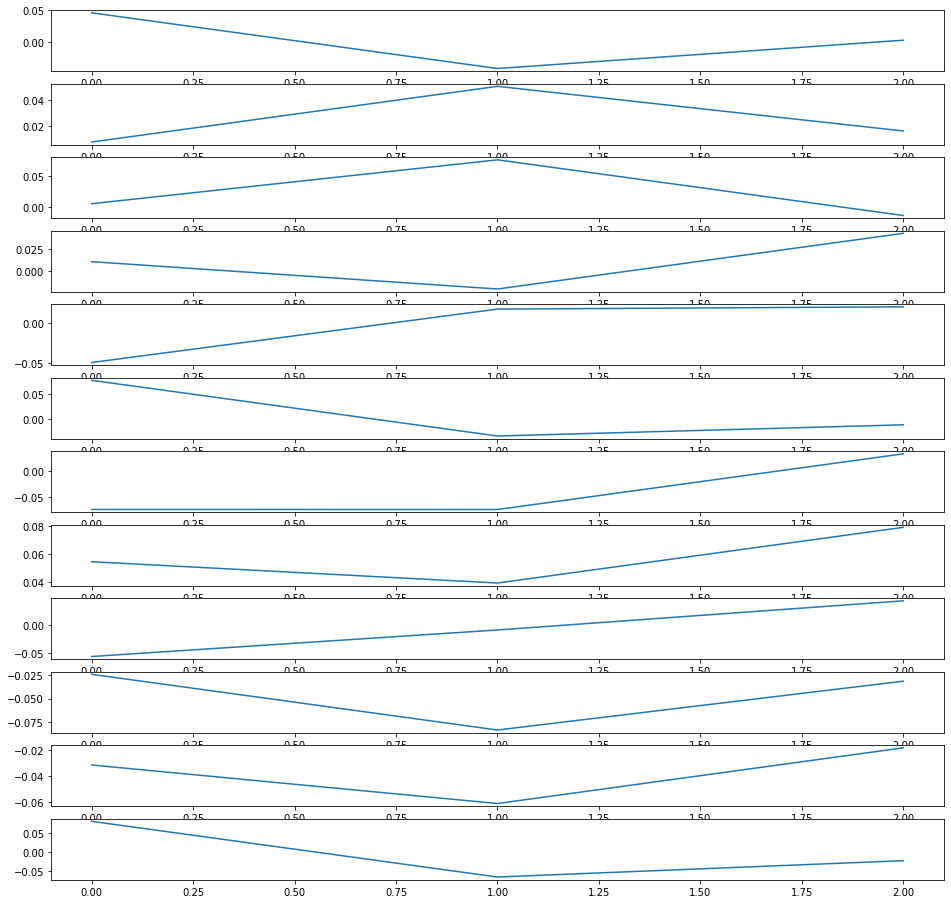

module.down_sample_layers.0.layers.1.weight tensor([[ 1.4120e+00,  1.4106e+00, -6.5697e-04],
        [ 1.4130e+00,  1.4148e+00,  6.9642e-04],
        [ 1.4144e+00,  1.4143e+00,  6.7774e-03],
        [ 1.4215e+00,  1.4233e+00, -5.8312e-03],
        [ 1.4180e+00,  1.4145e+00, -1.2260e-03],
        [ 1.4166e+00,  1.4118e+00, -7.6334e-04],
        [ 1.4169e+00,  1.4137e+00, -1.4577e-02],
        [ 1.4184e+00,  1.4121e+00, -7.5312e-03],
        [ 1.4136e+00,  1.4131e+00,  6.0243e-03],
        [ 1.4138e+00,  1.4096e+00, -3.1737e-03],
        [ 1.4135e+00,  1.4089e+00, -1.9298e-03],
        [ 1.4174e+00,  1.4090e+00,  2.1012e-03],
        [ 1.4170e+00,  1.4139e+00, -1.3506e-02],
        [ 1.4062e+00,  1.4221e+00,  5.5890e-04],
        [ 1.4117e+00,  1.4153e+00, -7.6722e-04],
        [ 1.4145e+00,  1.4058e+00,  4.9601e-03],
        [ 1.4072e+00,  1.4137e+00,  6.3238e-03],
        [ 1.4153e+00,  1.4110e+00,  3.8728e-03],
        [ 1.4140e+00,  1.4123e+00,  7.7525e-03],
        [ 1.4173e+00,  1.

IndexError: too many indices for tensor of dimension 2

In [10]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)
        #plt.imshow(nf.ifftshift(param.data.cpu()[:,0,0,:]), vmin=-1, vmax=1, cmap='coolwarm')
        # Heat map of neuron weights
        weights=nf.ifftshift(param.data.cpu()[:,0,0,:])
        plt.imshow(weights, vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
        plt.show()
        fig,ax=plt.subplots(args.resolution//10,1,figsize=(16,16))
        for i in range(args.resolution//10):
            ax[i].plot(weights[i,:args.resolution])
        plt.show()

In [ ]:
def train_plain(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run
    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

#         is_new_best = dev_loss < best_dev_loss
#         best_dev_loss = min(best_dev_loss, dev_loss)
#         save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
    writer.close()
    return dev_loss

def run_model(lr):
    print(lr)
    args.lr=lr
    return train_plain(args)

In [ ]:
from hyperopt import hp, tpe, fmin

# Single line bayesian optimization of polynomial function
args.num_epochs=100
best = fmin(fn=lambda x: run_model(x),
            space=hp.normal('x', 0.0001, 0.5),
            algo=tpe.suggest,
            max_evals=100)

In [ ]:
print(best)

/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_Kspace_multiChannel/best_model.pt
Model build successfully
Model load successfully


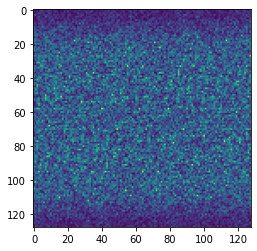

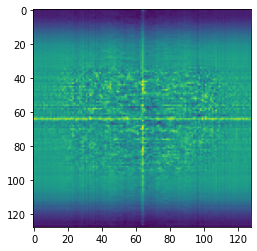

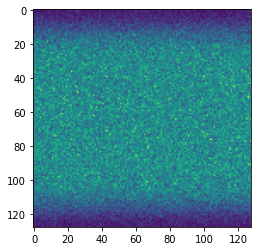

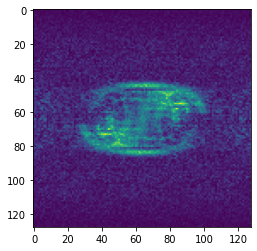

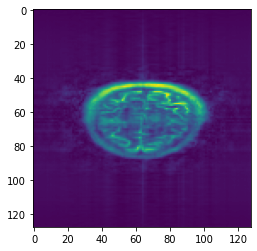

...

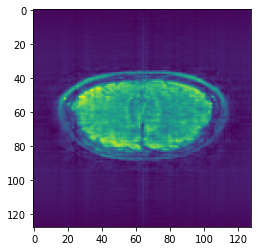

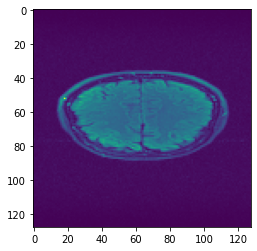

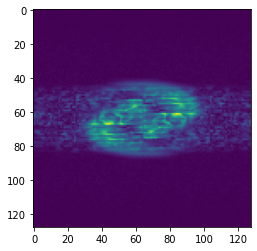

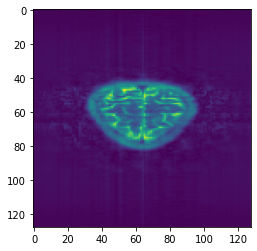

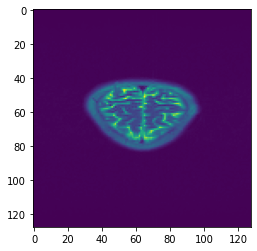

0.024316496575357418 0.0014263040452676282 0.8797418289135881 0.022249452529689746 0.031032816457215718 0.001043882766355325 0.0029385291211853713 0.8088744070987022 0.917075616990421
0.0017464912025061245 0.0003434862214332536 0.023604207795587914


In [12]:
c=args.checkpoint#"/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_pure_inverse_fourier/best_model.pt
print(c)
#c='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd'+'/model.pt'
checkpoint, model, optimizer = load_model(c,args)
model.eval()
losses=[]
for iter, data in enumerate(train_loader):
            f, t = data
            #plt.hist(f[abs(f) >= 0.00001].flatten(),bins=1000)
            #plt.show()
            plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            plt.show()
            
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            
            output_r,output_i = model(input)
            l=eval_loss((output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2),target)
            losses.append(l)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            plt.imshow(image[0,:,:])
            plt.show()

            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            #break;
losses=np.array(losses)
print(np.mean(losses[:,0]),np.mean(losses[:,1]),np.mean(losses[:,2]),np.min(losses[:,0]),np.max(losses[:,0]),np.min(losses[:,1]),np.max(losses[:,1]),np.min(losses[:,2]),np.max(losses[:,2]))
print(np.std(losses[:,0]),np.std(losses[:,1]),np.std(losses[:,2]))

module.f_layer1.conv_r.weight tensor([[[[ 0.0044, -0.0112, -0.0003,  ..., -0.0125, -0.0033, -0.0130]]],


        [[[ 0.0017,  0.0018,  0.0016,  ...,  0.0070,  0.0038,  0.0027]]],


        [[[-0.0066,  0.0129, -0.0057,  ...,  0.0159, -0.0026,  0.0131]]],


        ...,


        [[[ 0.0081, -0.0022,  0.0088,  ...,  0.0045,  0.0084, -0.0002]]],


        [[[-0.0059,  0.0114, -0.0061,  ...,  0.0128, -0.0039,  0.0102]]],


        [[[-0.0016,  0.0038,  0.0024,  ...,  0.0094,  0.0012,  0.0059]]]],
       device='cuda:0', dtype=torch.float64)


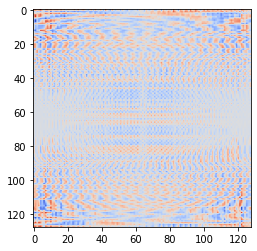

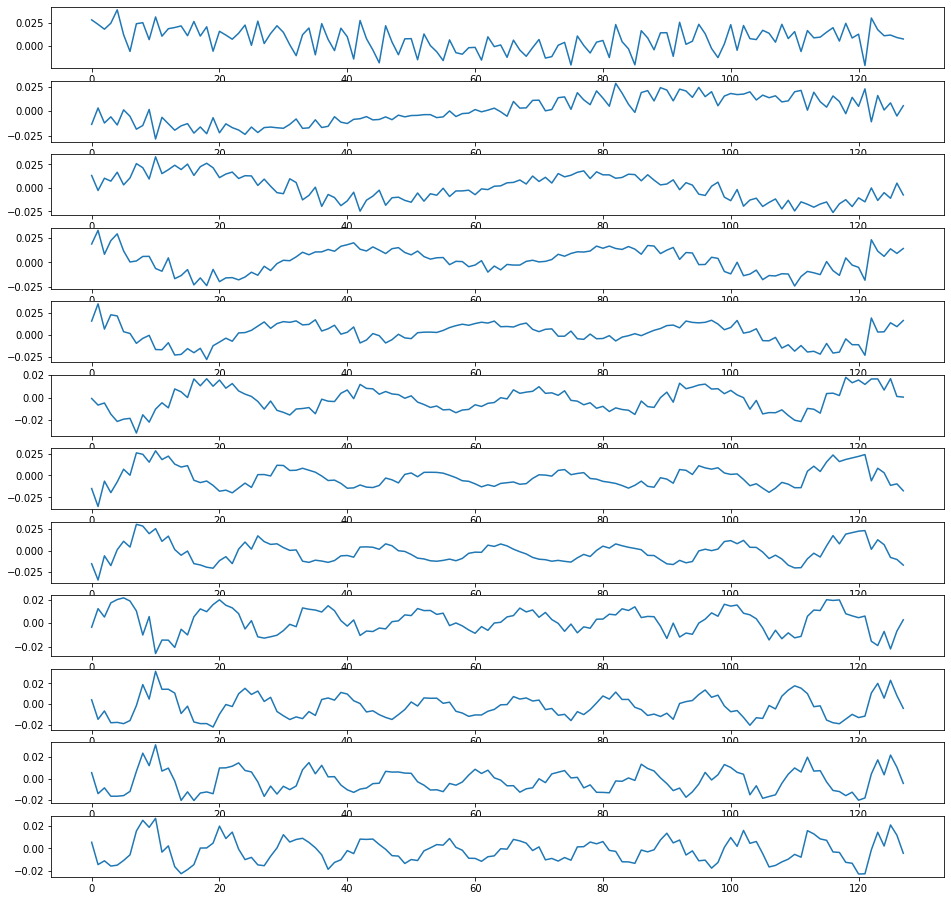

module.f_layer1.conv_i.weight tensor([[[[ 0.0079, -0.0006,  0.0069,  ..., -0.0017,  0.0047, -0.0012]]],


        [[[-0.0088,  0.0061, -0.0104,  ...,  0.0016, -0.0111,  0.0064]]],


        [[[ 0.0011, -0.0025, -0.0009,  ..., -0.0102, -0.0004, -0.0043]]],


        ...,


        [[[ 0.0022, -0.0014, -0.0001,  ..., -0.0095,  0.0016, -0.0042]]],


        [[[-0.0048,  0.0044, -0.0066,  ...,  0.0006, -0.0094,  0.0048]]],


        [[[ 0.0088, -0.0004,  0.0102,  ...,  0.0041,  0.0094, -0.0026]]]],
       device='cuda:0', dtype=torch.float64)


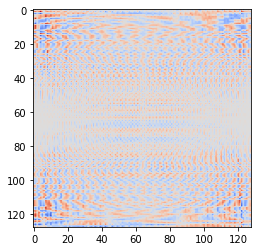

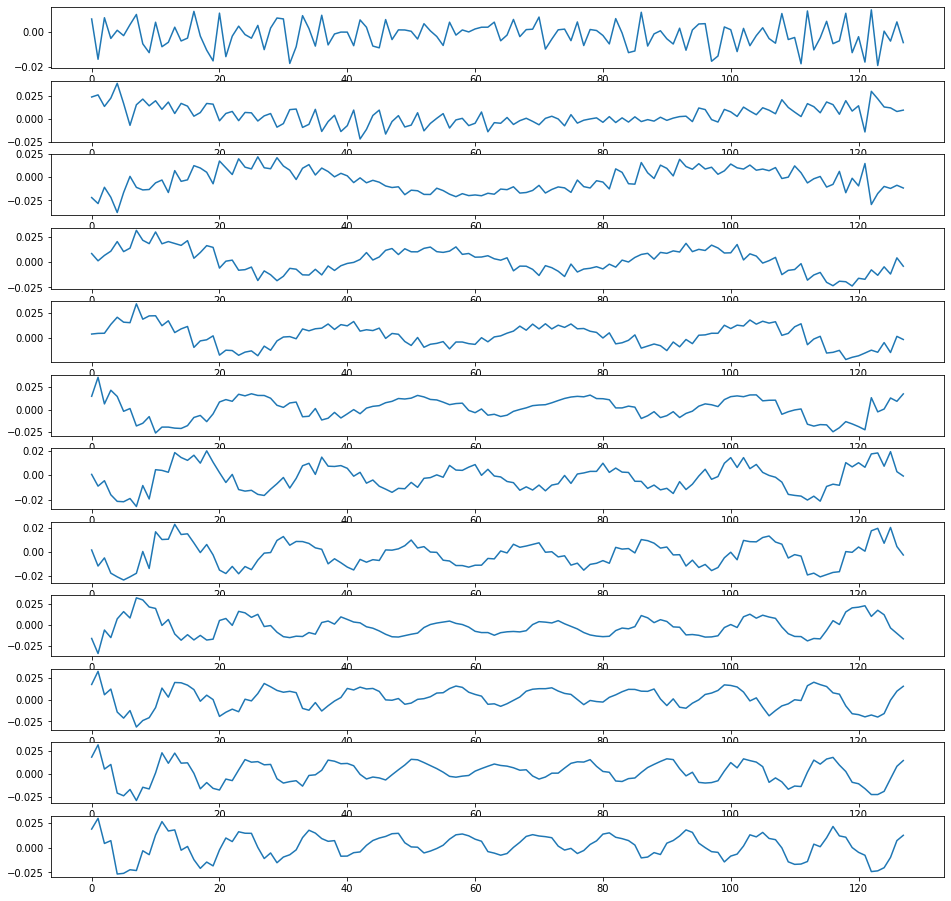

module.f_layer2.conv_r.weight tensor([[[[ 5.6545e-03, -9.2055e-03,  5.1545e-03,  ..., -7.0464e-03,
            4.2448e-03, -1.3204e-02]]],


        [[[ 1.8701e-03, -2.9805e-03,  4.9630e-03,  ..., -1.2109e-03,
            3.9590e-03, -2.2919e-04]]],


        [[[ 5.3081e-03, -4.6477e-03,  2.9327e-03,  ..., -7.3438e-03,
            4.5380e-03, -7.2124e-03]]],


        ...,


        [[[-7.7157e-03,  1.5967e-03, -6.3756e-03,  ...,  5.0930e-03,
           -8.5899e-03,  4.7431e-03]]],


        [[[ 2.0361e-03,  7.1661e-04,  3.3494e-03,  ..., -2.1927e-03,
            5.8212e-03, -4.4374e-05]]],


        [[[-6.4607e-03,  3.9719e-04, -5.3104e-03,  ...,  1.5016e-03,
           -6.0028e-03,  3.4806e-03]]]], device='cuda:0', dtype=torch.float64)


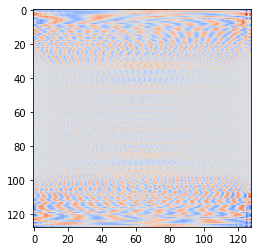

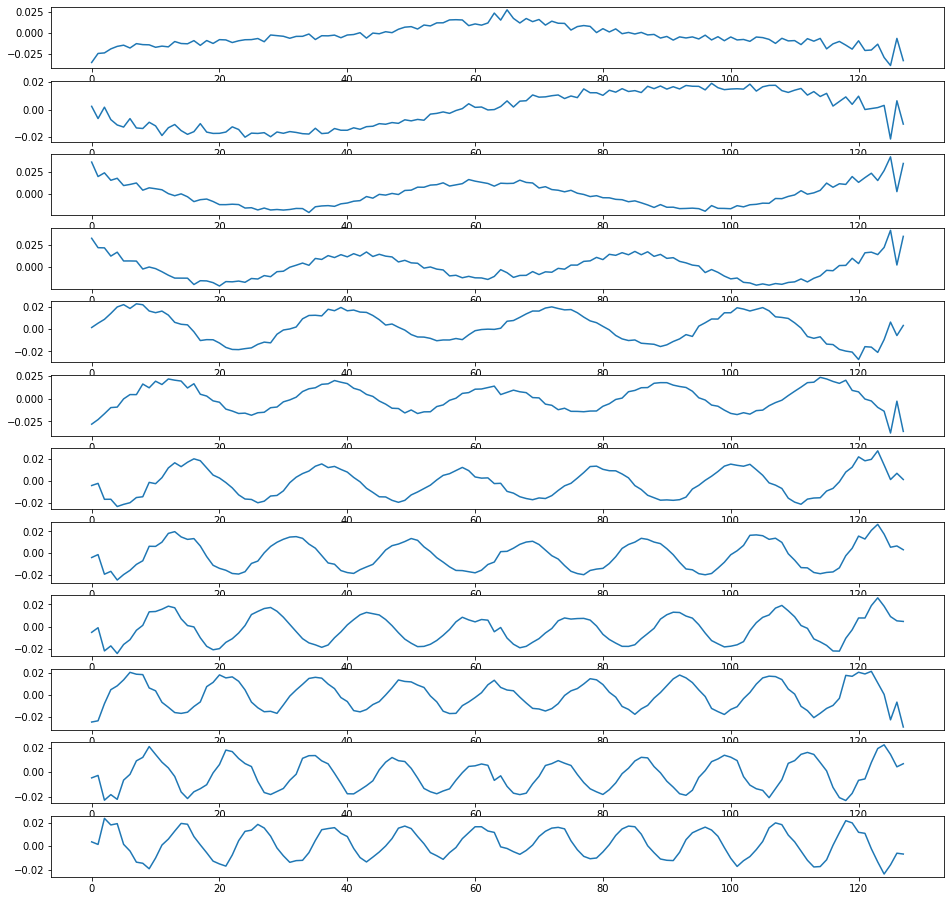

module.f_layer2.conv_i.weight tensor([[[[ 0.0010, -0.0045,  0.0010,  ..., -0.0050,  0.0001, -0.0093]]],


        [[[-0.0088,  0.0037, -0.0085,  ...,  0.0047, -0.0081,  0.0043]]],


        [[[ 0.0068, -0.0032,  0.0092,  ..., -0.0021,  0.0067, -0.0023]]],


        ...,


        [[[ 0.0059, -0.0062,  0.0046,  ..., -0.0039,  0.0011, -0.0052]]],


        [[[-0.0088,  0.0059, -0.0082,  ...,  0.0060, -0.0064,  0.0069]]],


        [[[ 0.0098, -0.0065,  0.0055,  ..., -0.0069,  0.0039, -0.0044]]]],
       device='cuda:0', dtype=torch.float64)


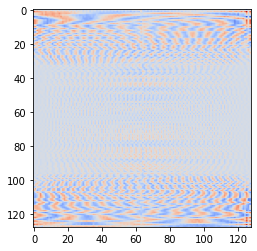

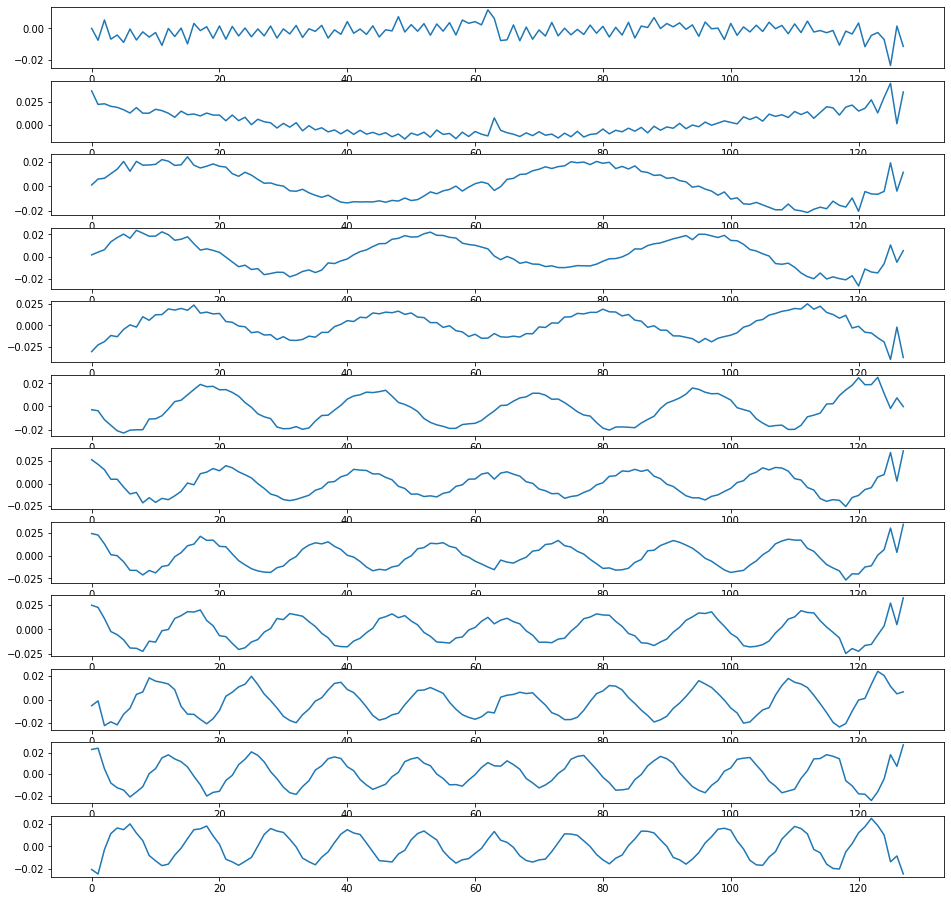

module.down_sample_layers.0.layers.0.conv_r.weight tensor([[[[ 0.0098, -0.0602,  0.0601],
          [ 0.0798,  0.0778, -0.0649],
          [-0.0102, -0.0588,  0.0152]],

         [[ 0.0588,  0.0372, -0.0858],
          [ 0.0828,  0.0584, -0.0749],
          [-0.0651,  0.0219,  0.0515]],

         [[-0.0348,  0.0028,  0.0929],
          [-0.0783, -0.0465,  0.1021],
          [ 0.0078,  0.0634,  0.0216]],

         ...,

         [[ 0.0590,  0.0463, -0.0064],
          [ 0.0194,  0.0658, -0.0694],
          [-0.0130,  0.0790,  0.0423]],

         [[-0.0038, -0.0578,  0.0406],
          [ 0.0182, -0.0483, -0.0520],
          [-0.0205,  0.0443, -0.0105]],

         [[-0.0702,  0.0358,  0.0063],
          [-0.0320,  0.0278, -0.0100],
          [ 0.0194, -0.0520,  0.0163]]],


        [[[-0.0203,  0.0030,  0.0627],
          [ 0.0576, -0.0270, -0.0284],
          [ 0.0212,  0.0355, -0.0229]],

         [[-0.0270,  0.0319, -0.0806],
          [-0.0243, -0.0116, -0.0610],
          [ 0.0587,  

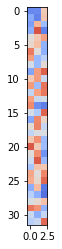

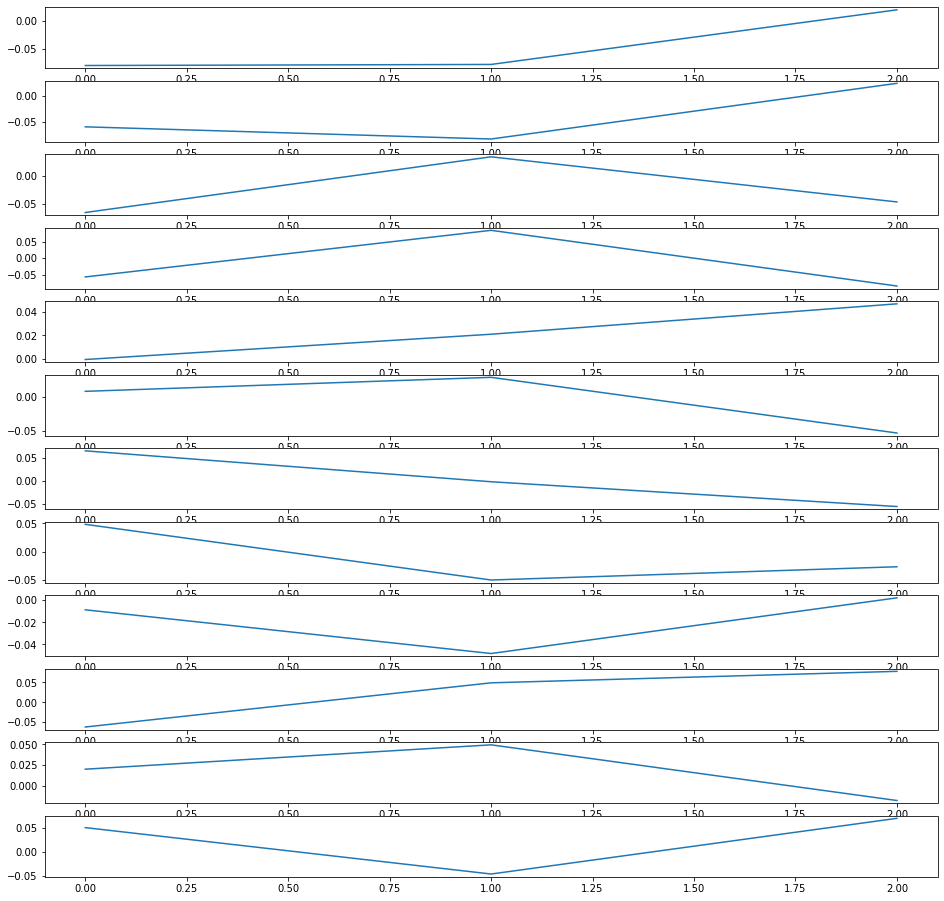

module.down_sample_layers.0.layers.0.conv_i.weight tensor([[[[-0.0013,  0.0426,  0.0182],
          [ 0.0272,  0.0694, -0.0649],
          [-0.0483, -0.0487,  0.0102]],

         [[-0.0811, -0.0307,  0.0052],
          [ 0.0148,  0.0264, -0.0179],
          [ 0.0253,  0.0252,  0.0145]],

         [[-0.0604, -0.0086, -0.0666],
          [ 0.0795, -0.0057, -0.0237],
          [ 0.0328,  0.0230,  0.0534]],

         ...,

         [[ 0.0188,  0.1049, -0.0182],
          [ 0.0333,  0.0053, -0.0595],
          [ 0.0676, -0.0133,  0.0261]],

         [[-0.0179, -0.0758,  0.1025],
          [ 0.0303,  0.0484,  0.0462],
          [ 0.0234,  0.0313,  0.0435]],

         [[-0.0557,  0.0763,  0.0032],
          [-0.0658, -0.0643,  0.0032],
          [-0.0098,  0.0663,  0.0595]]],


        [[[ 0.0719, -0.0109,  0.0016],
          [ 0.0686, -0.0114,  0.0537],
          [ 0.0599,  0.0060, -0.0225]],

         [[ 0.0540,  0.0056,  0.0047],
          [ 0.0564, -0.0667,  0.0539],
          [-0.0470, -

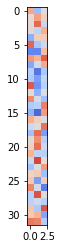

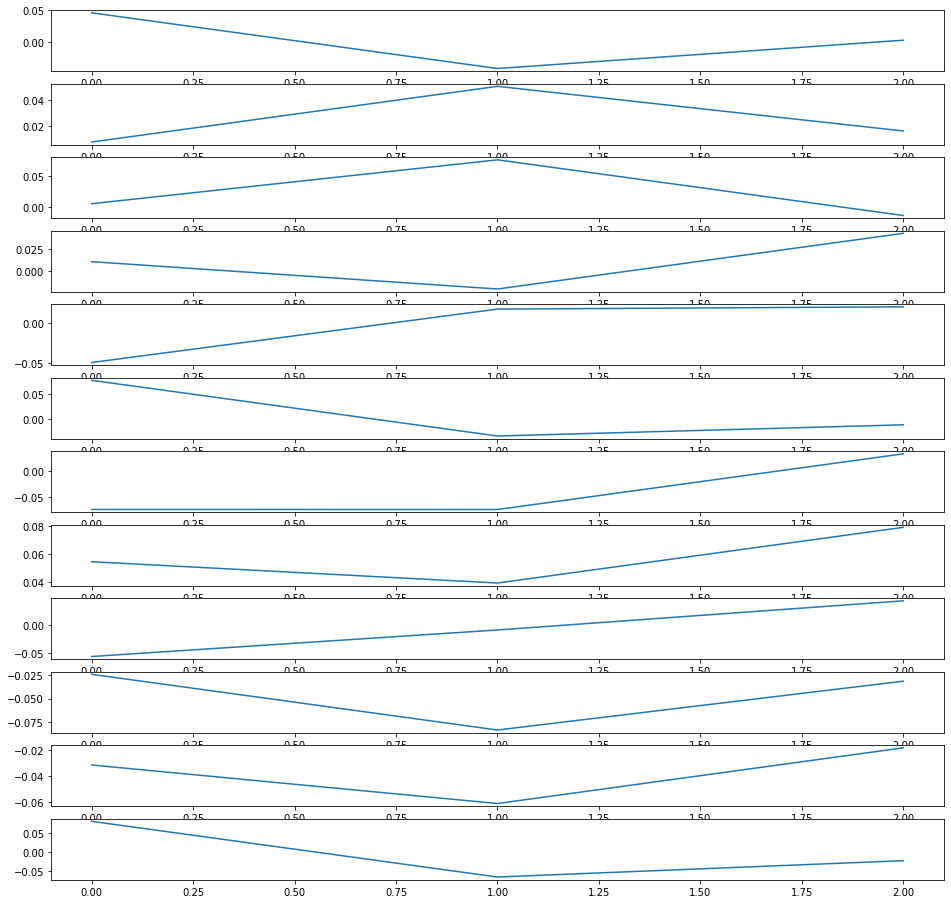

module.down_sample_layers.0.layers.1.weight tensor([[ 1.4120e+00,  1.4106e+00, -6.5697e-04],
        [ 1.4130e+00,  1.4148e+00,  6.9642e-04],
        [ 1.4144e+00,  1.4143e+00,  6.7774e-03],
        [ 1.4215e+00,  1.4233e+00, -5.8312e-03],
        [ 1.4180e+00,  1.4145e+00, -1.2260e-03],
        [ 1.4166e+00,  1.4118e+00, -7.6334e-04],
        [ 1.4169e+00,  1.4137e+00, -1.4577e-02],
        [ 1.4184e+00,  1.4121e+00, -7.5312e-03],
        [ 1.4136e+00,  1.4131e+00,  6.0243e-03],
        [ 1.4138e+00,  1.4096e+00, -3.1737e-03],
        [ 1.4135e+00,  1.4089e+00, -1.9298e-03],
        [ 1.4174e+00,  1.4090e+00,  2.1012e-03],
        [ 1.4170e+00,  1.4139e+00, -1.3506e-02],
        [ 1.4062e+00,  1.4221e+00,  5.5890e-04],
        [ 1.4117e+00,  1.4153e+00, -7.6722e-04],
        [ 1.4145e+00,  1.4058e+00,  4.9601e-03],
        [ 1.4072e+00,  1.4137e+00,  6.3238e-03],
        [ 1.4153e+00,  1.4110e+00,  3.8728e-03],
        [ 1.4140e+00,  1.4123e+00,  7.7525e-03],
        [ 1.4173e+00,  1.

IndexError: too many indices for tensor of dimension 2

In [13]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)
        #plt.imshow(nf.ifftshift(param.data.cpu()[:,0,0,:]), vmin=-1, vmax=1, cmap='coolwarm')
        # Heat map of neuron weights
        weights=nf.ifftshift(param.data.cpu()[:,0,0,:])
        np.save(name+'_twoPartKspcae.npy', param.data.cpu())
        plt.imshow(weights, vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
        plt.show()
        fig,ax=plt.subplots(args.resolution//10,1,figsize=(16,16))
        for i in range(args.resolution//10):
            ax[i].plot(weights[i,:args.resolution])
        plt.show()